In [29]:
import pandas as pd
import matplotlib.pyplot as plt
import random
import numpy as np
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.colors as colors
import re, seaborn as sns
from scipy import optimize
from scipy import integrate

In [53]:
df = pd.DataFrame(pd.read_csv("monday.csv"))

In [47]:
df

,Unnamed: 0,Day,hour,min,X,Y
0,0,2,0,30,487.195375,228.791241
1,1,2,0,30,498.617755,234.798586
2,2,2,0,30,493.954635,203.024133
3,3,2,0,30,198.051024,15.375869
4,4,2,0,30,639.841290,359.382179
...,...,...,...,...,...,...
1439995,1439995,2,23,30,649.783336,309.626466
1439996,1439996,2,23,30,197.582787,57.962783
1439997,1439997,2,23,30,501.709126,205.179615
1439998,1439998,2,23,30,648.751162,379.970408


In [24]:
df['X'][(df["hour"]==1) & (df["min"]==30)]

60000     498.069157
60001     496.356442
60002     497.289995
60003     188.749654
60004     641.221080
             ...    
119995    652.194748
119996    195.950308
119997    489.949847
119998    649.890956
119999    644.865037
Name: X, Length: 60000, dtype: float64

In [38]:
len(df['Y'][(df["hour"]==0) & (df["min"]==30)])

60000

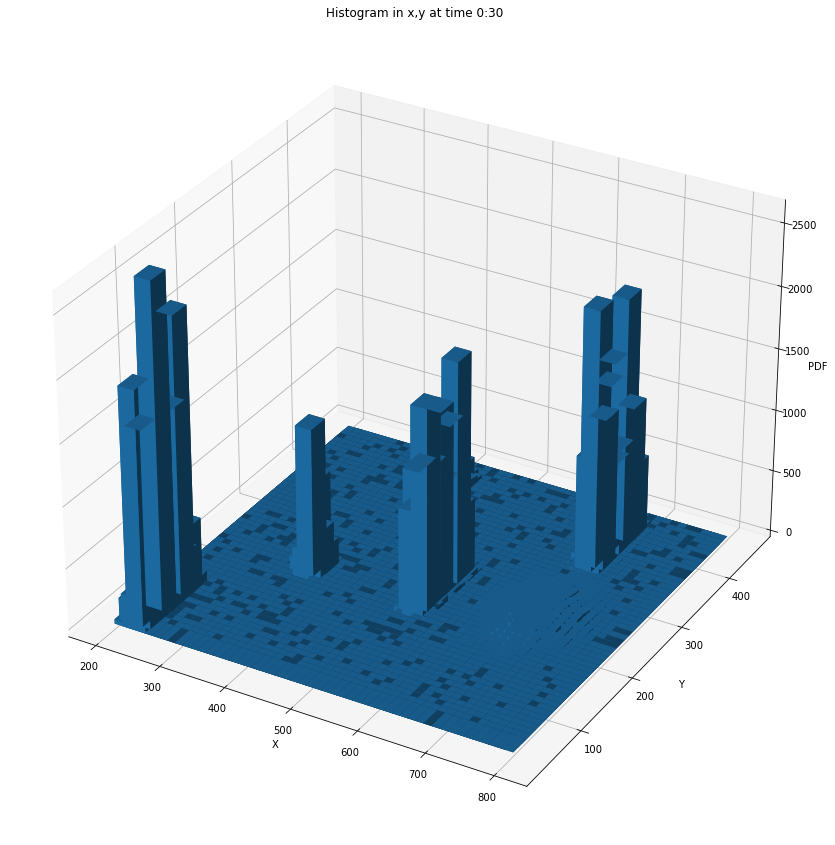

[[6.20516432e-06 3.08534559e-05 2.51653886e-05 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [4.58492697e-05 3.27150052e-04 2.67339163e-04 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [1.01695749e-05 7.58408972e-05 6.13621805e-05 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]]


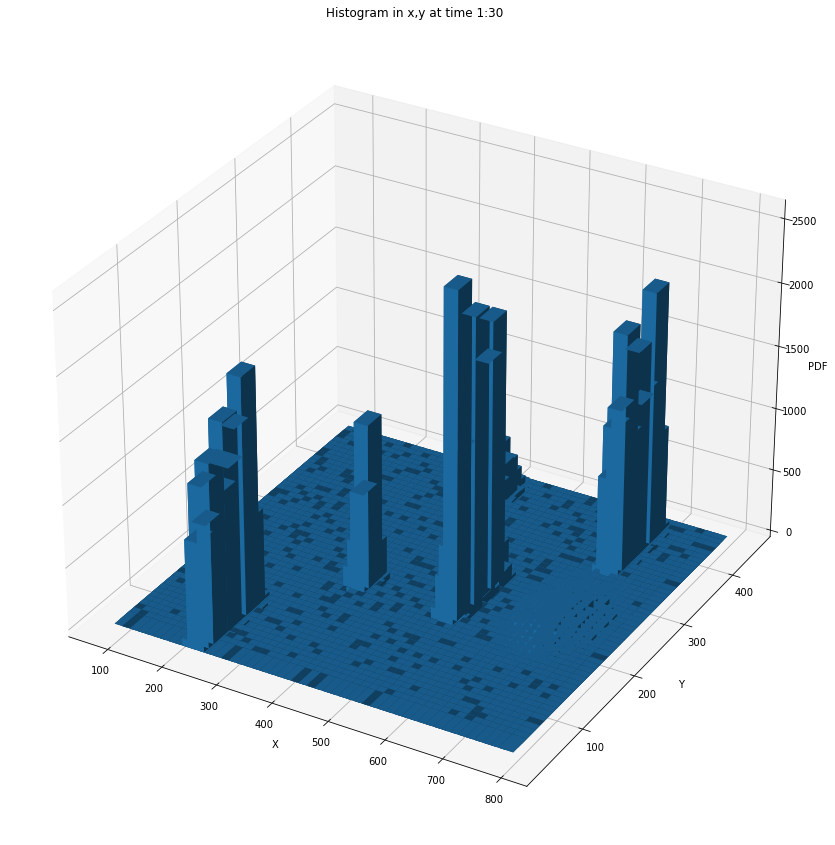

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]


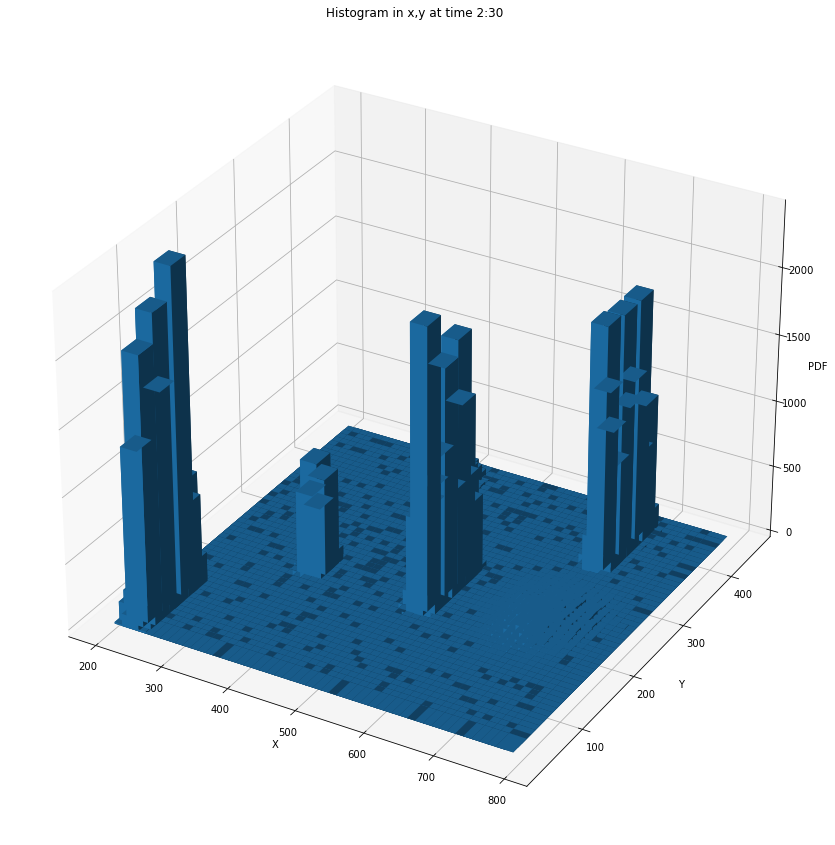

[[2.13038014e-06 2.44993716e-05 3.49737406e-05 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [1.65104461e-05 2.34164283e-04 3.53643103e-04 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [2.48544349e-06 6.01832388e-05 9.37367260e-05 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]]


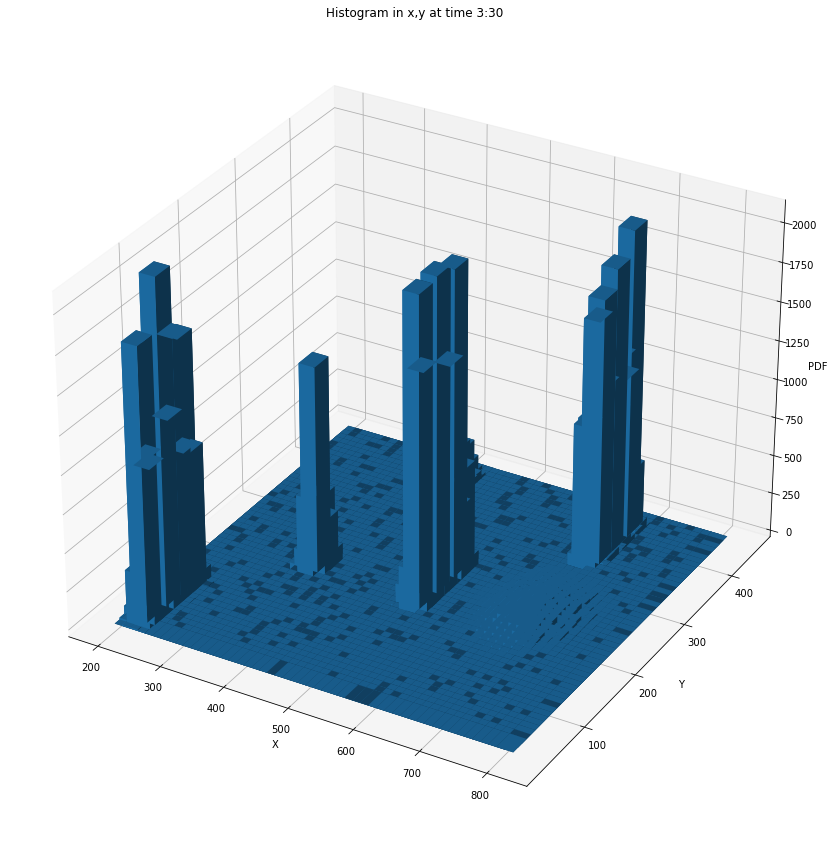

[[0.00000000e+00 2.00693456e-06 1.05364064e-05 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [1.50520092e-06 5.68631459e-05 2.95353870e-04 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [6.68978187e-07 3.02712630e-05 1.68248014e-04 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]]


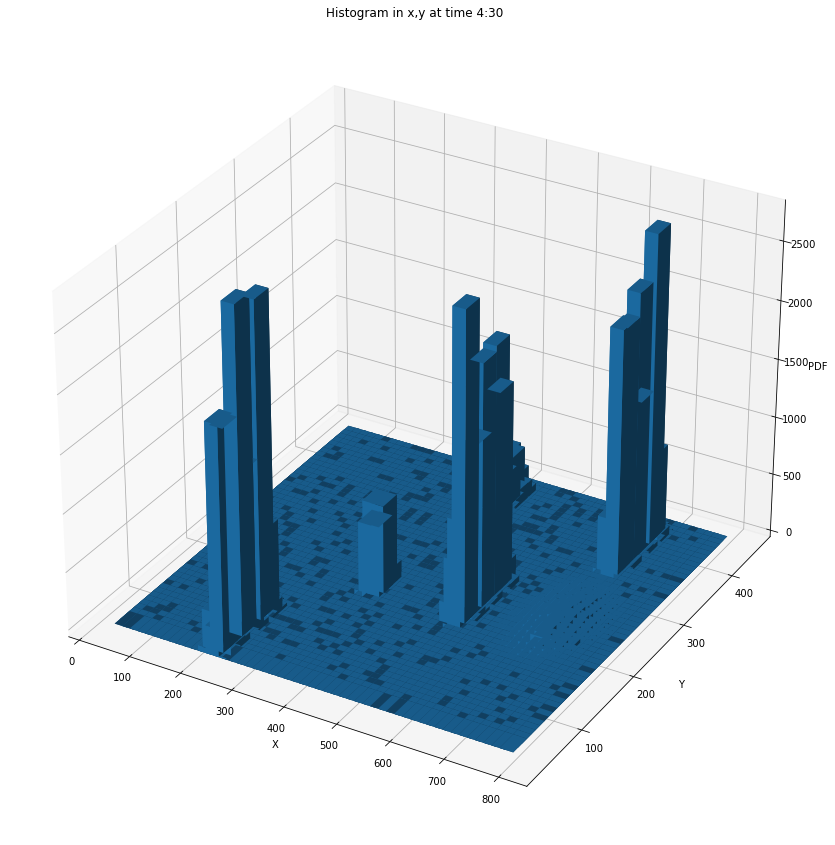

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]


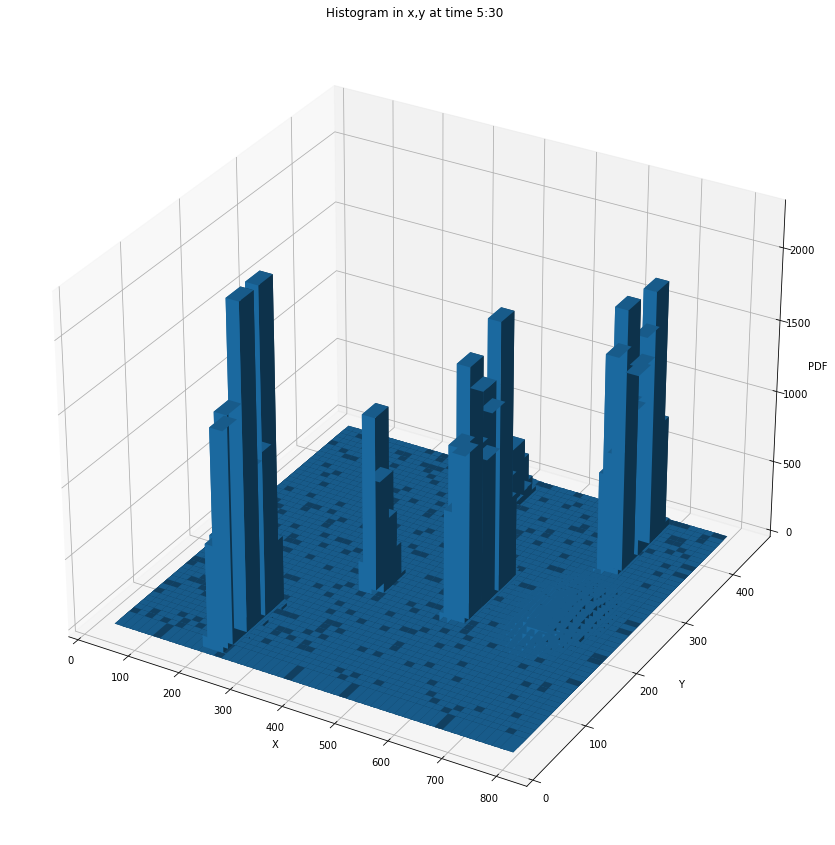

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]


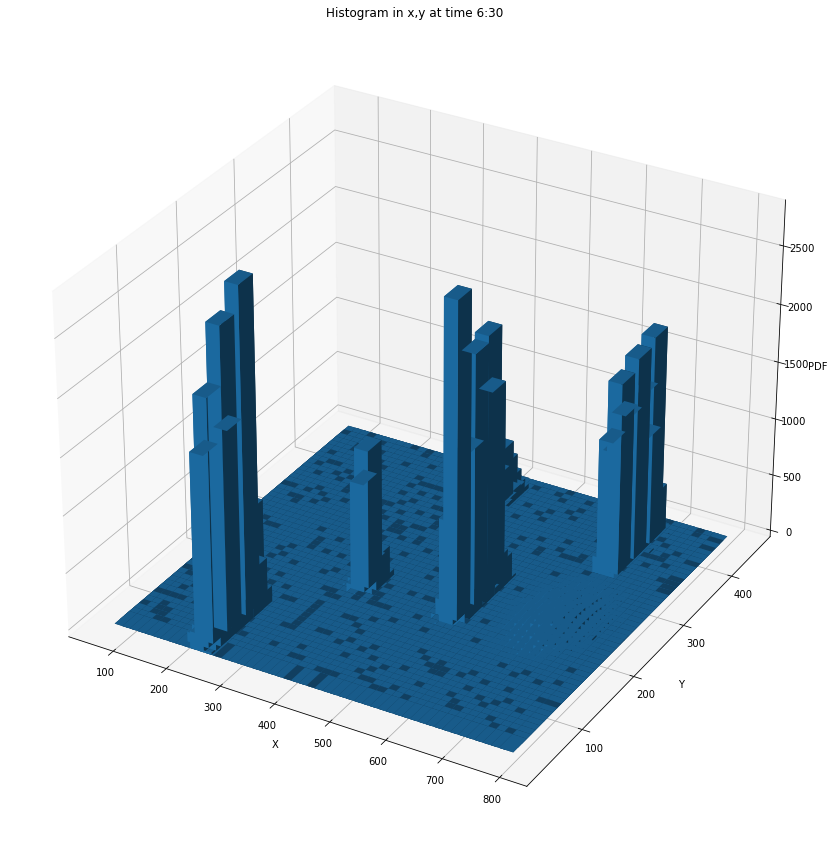

[[0.00000000e+00 0.00000000e+00 1.43051677e-07 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]]


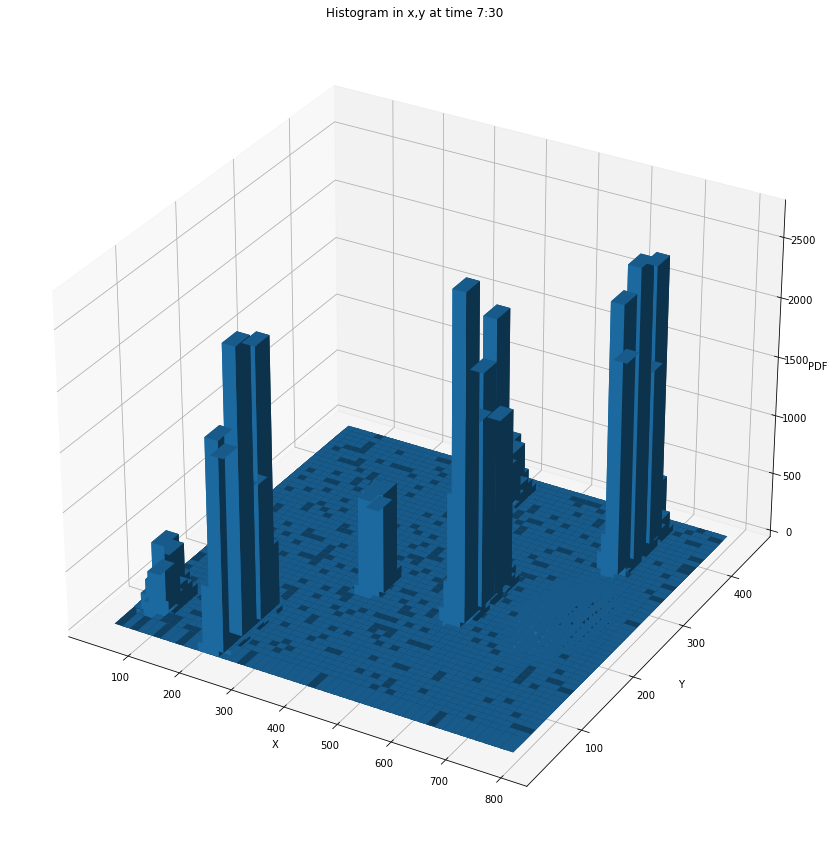

[[0.00000000e+00 0.00000000e+00 1.37909566e-07 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 1.37909566e-07 9.65366963e-07 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 2.75819132e-07 2.75819132e-06 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]]


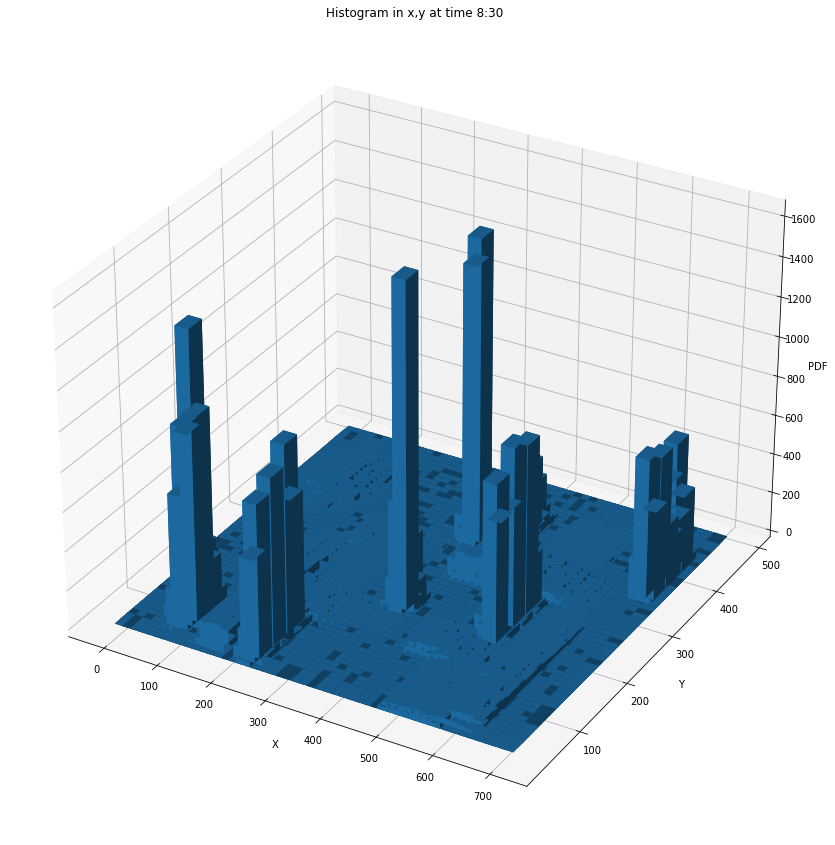

[[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.29333943e-07
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.29333943e-07
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]]


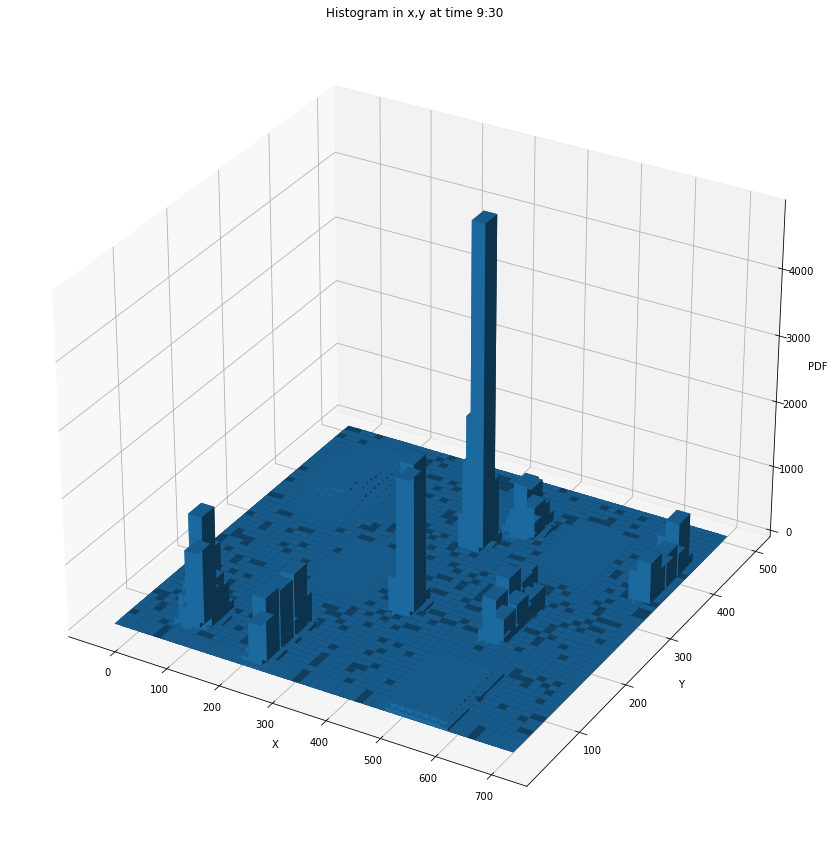

[[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.23472495e-07
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]]


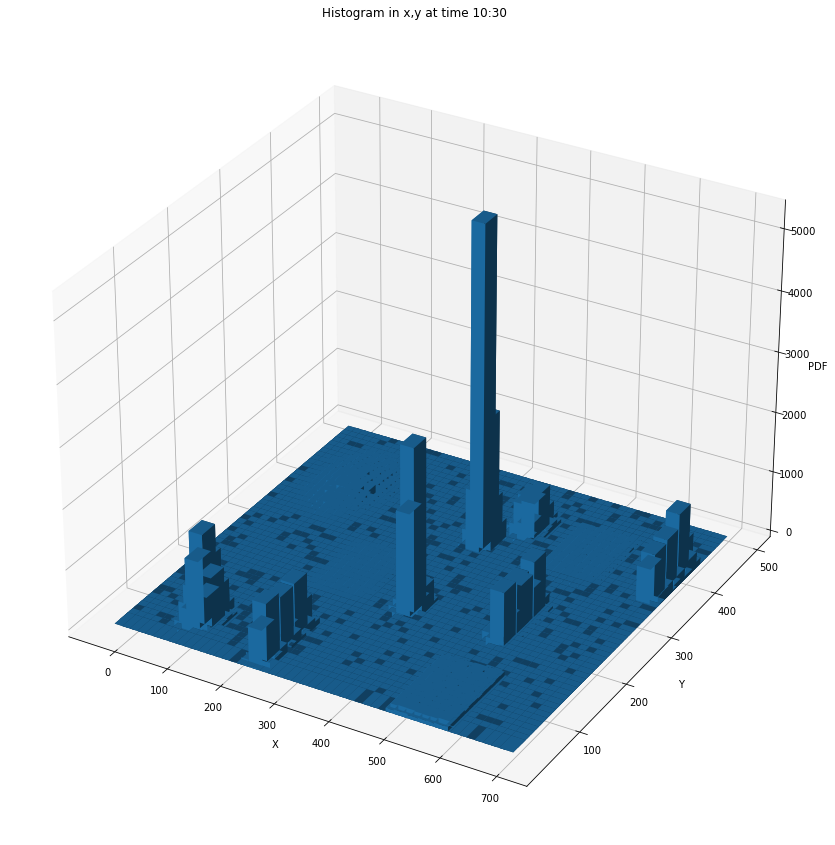

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]


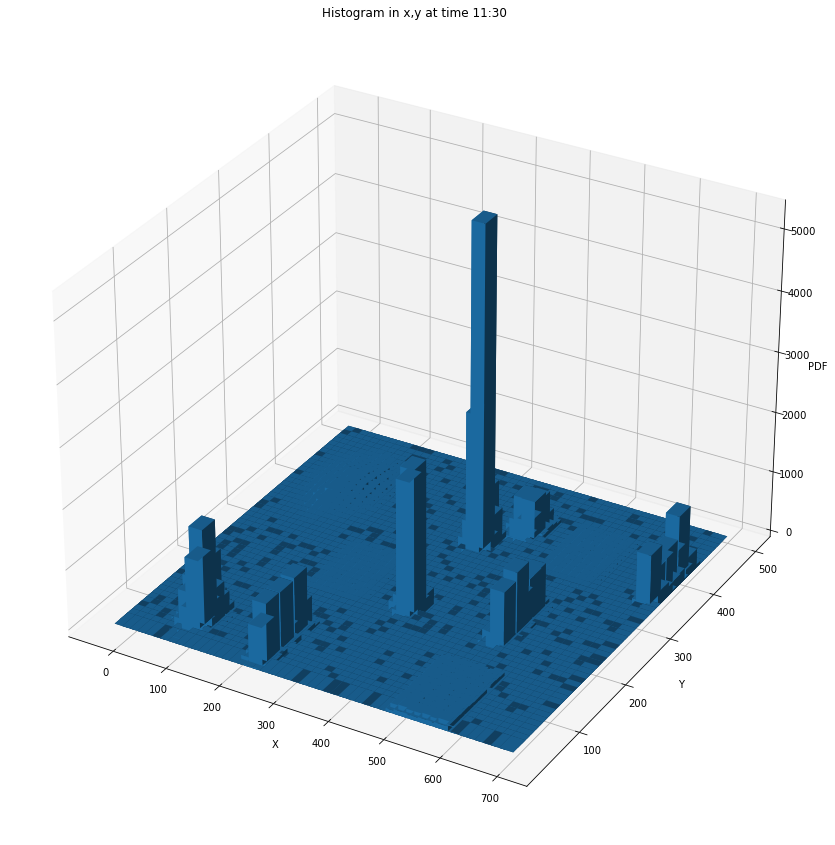

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]


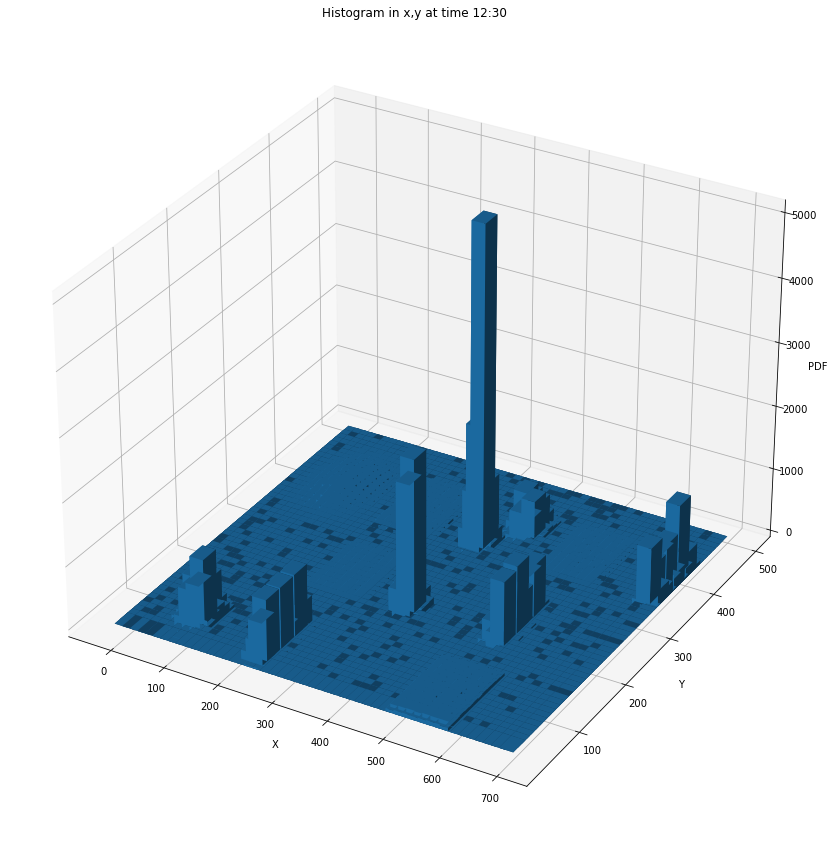

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]


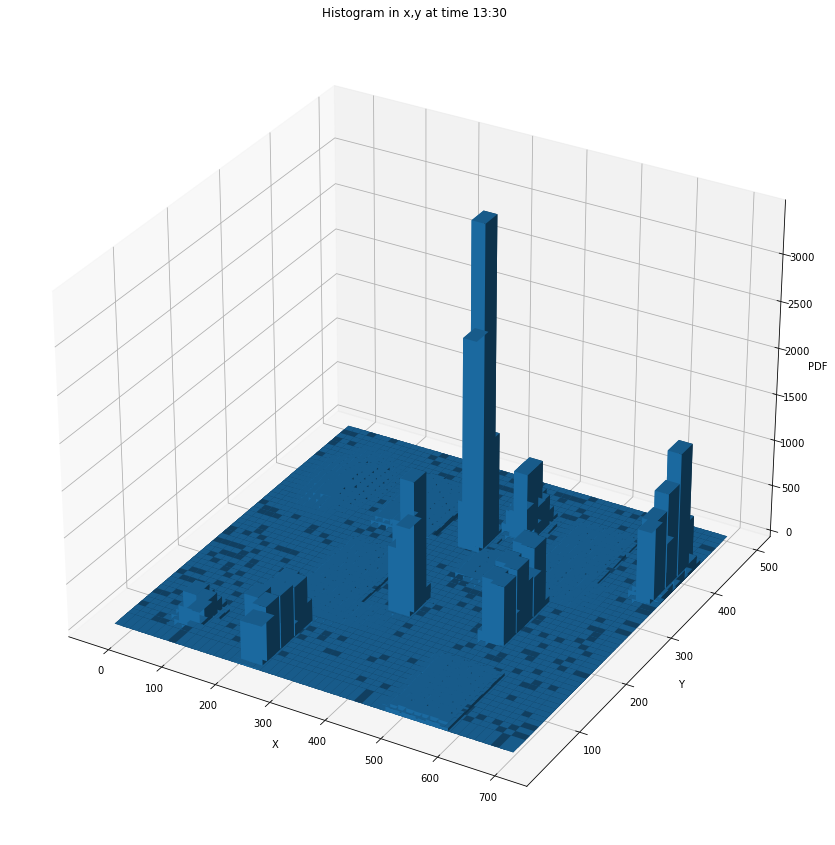

[[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.27712106e-07
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]]


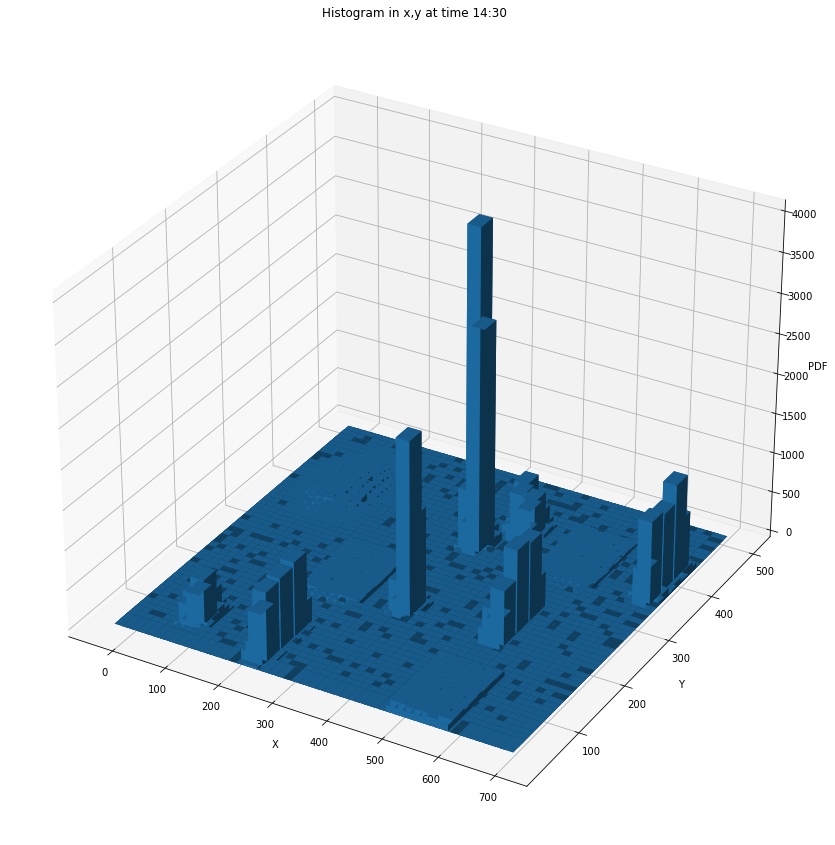

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]


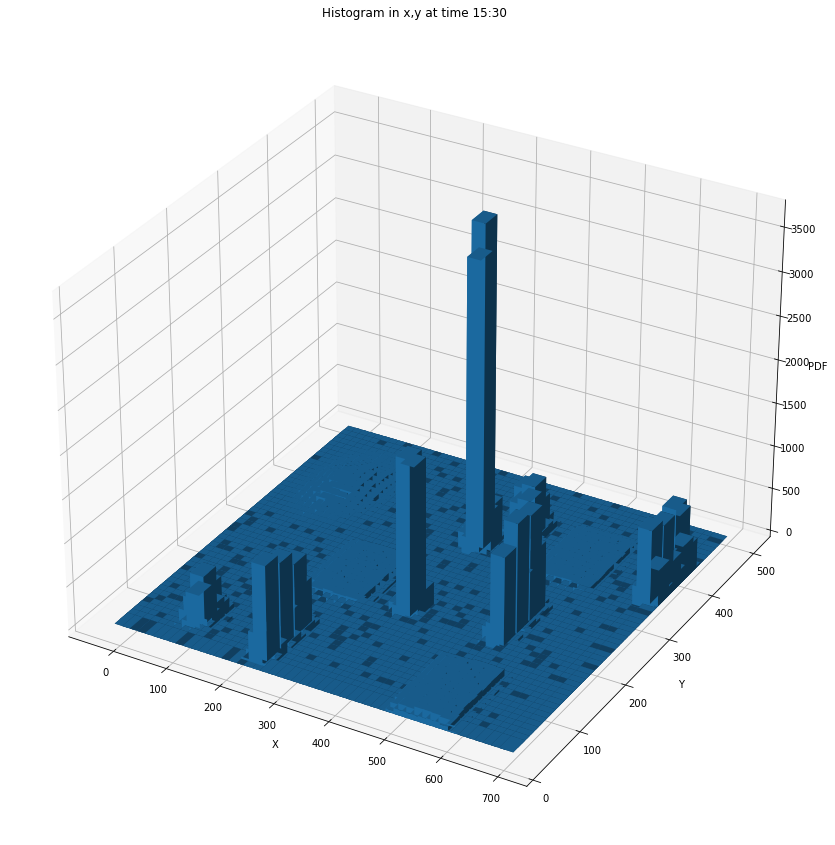

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]


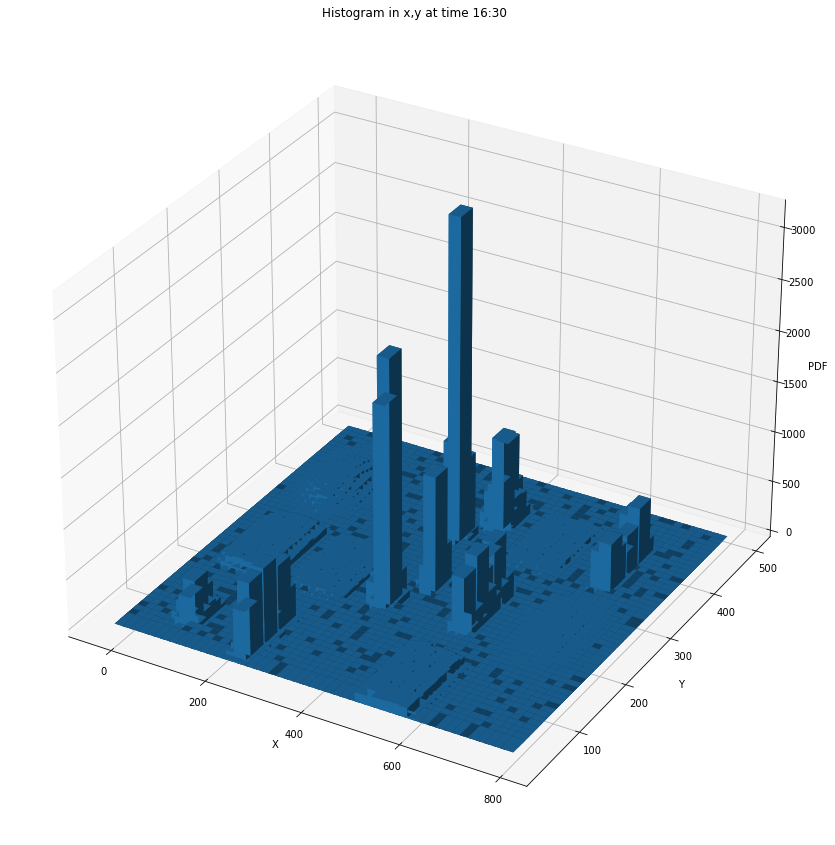

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]


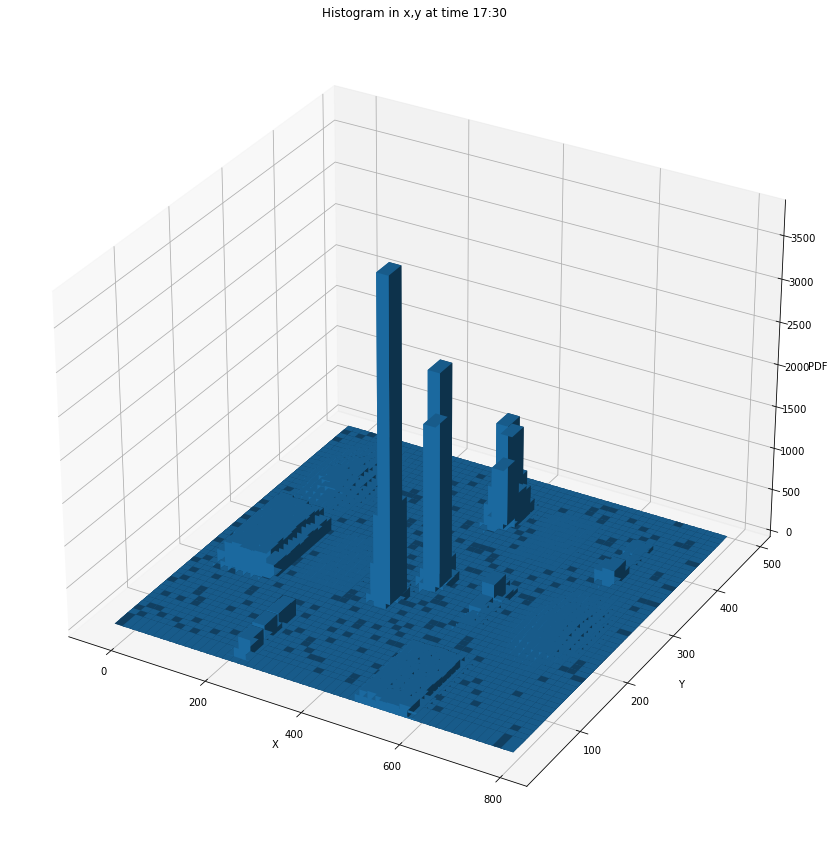

[[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 2.27969954e-07
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]]


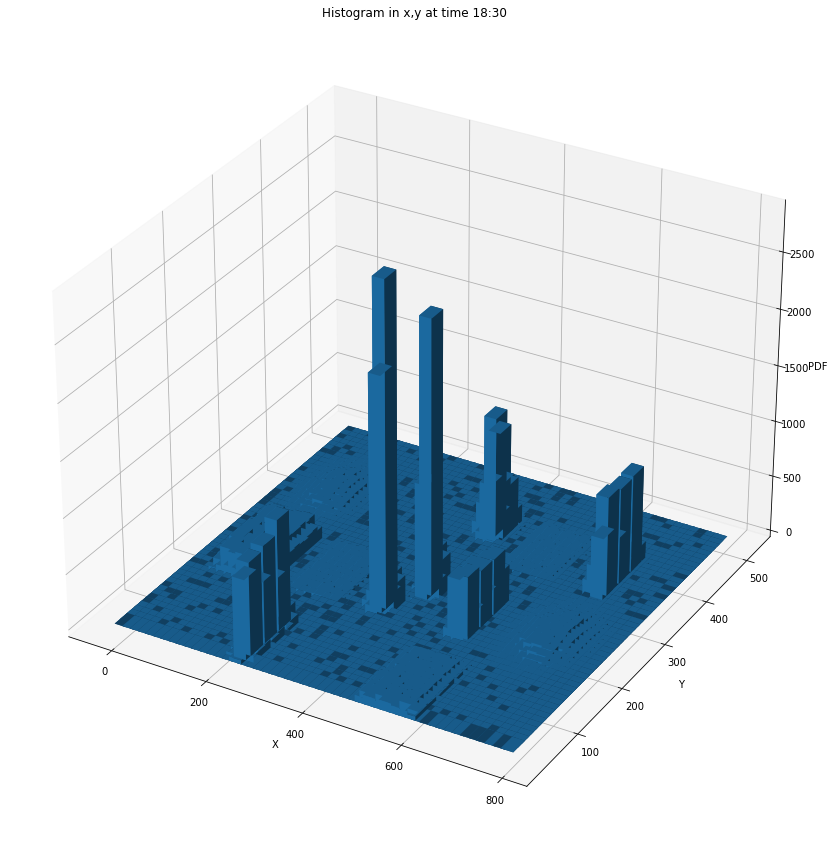

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]


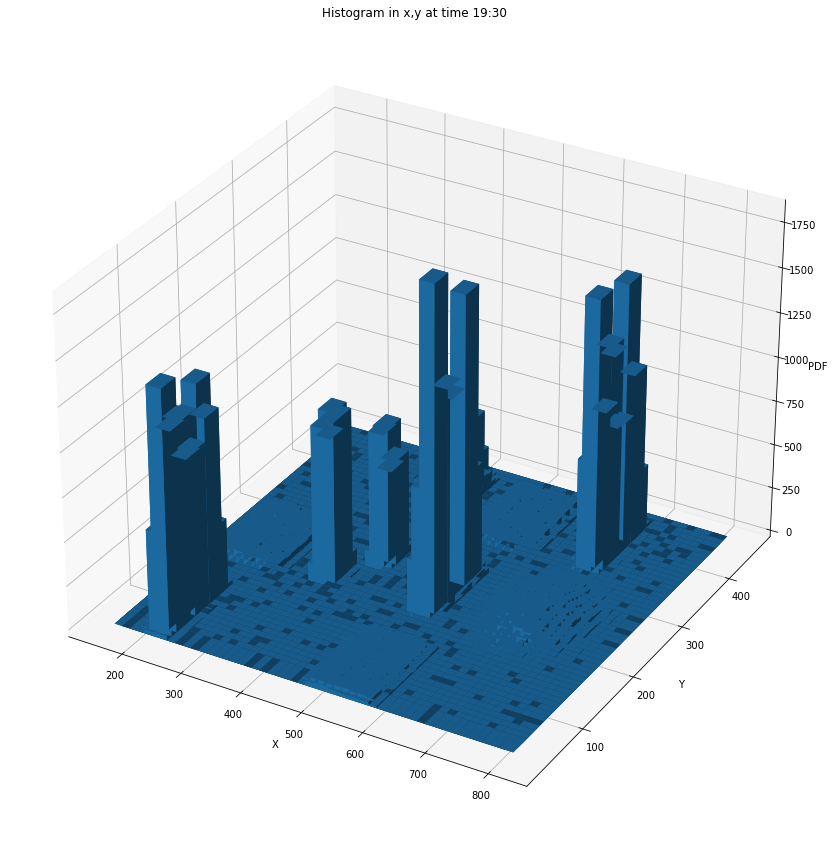

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]


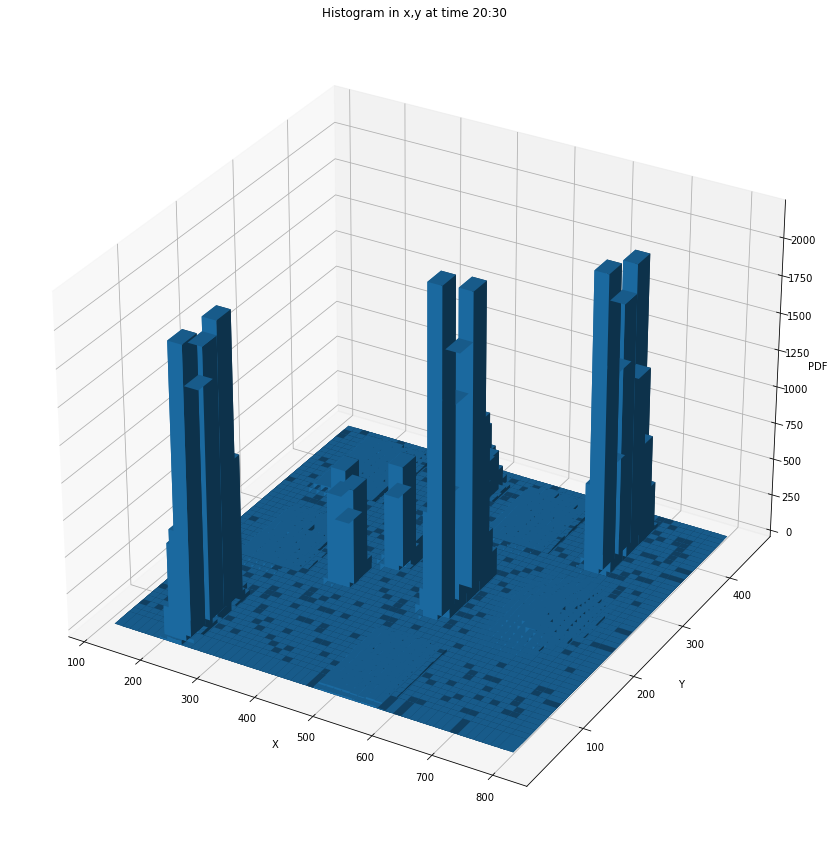

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]


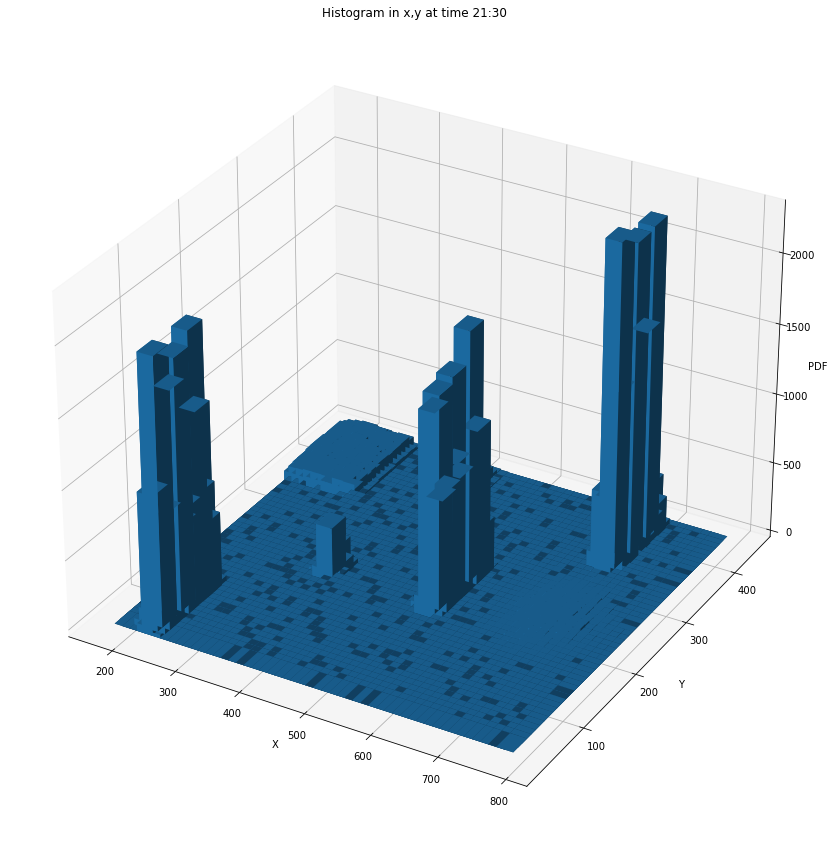

[[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.61491518e-05
  1.23289224e-05 8.85598649e-06]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.33708031e-05
  1.28498628e-05 1.09397480e-05]
 [1.73646794e-07 7.81410573e-06 1.66700922e-05 ... 1.61491518e-05
  1.54545647e-05 1.23289224e-05]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]]


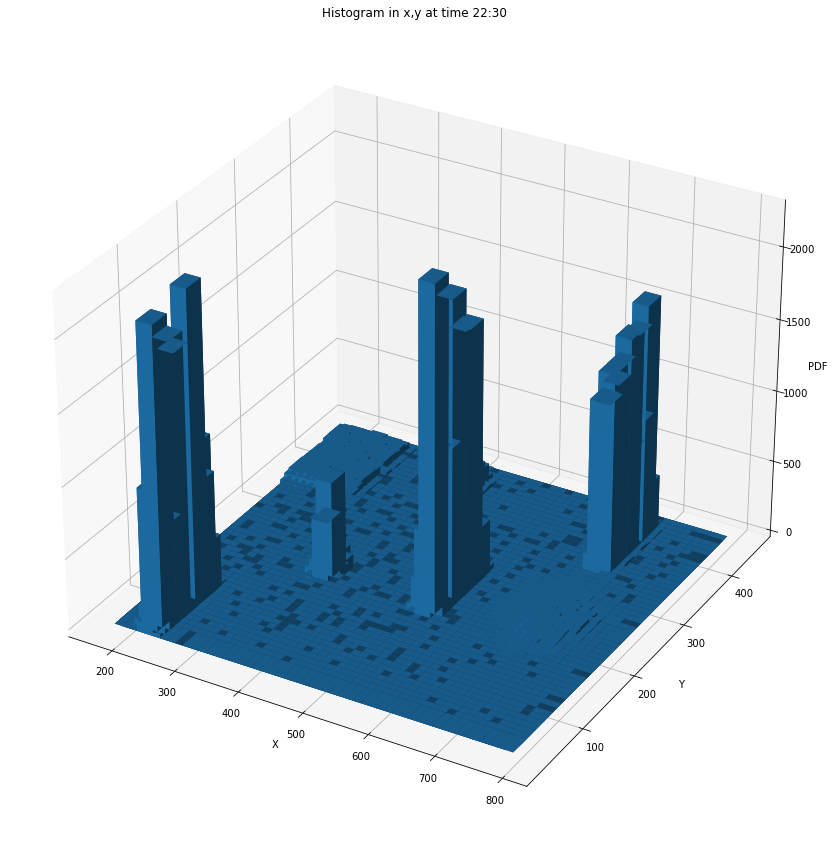

[[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.16592401e-05
  7.09692875e-06 0.00000000e+00]
 [0.00000000e+00 1.68974494e-07 0.00000000e+00 ... 9.46257167e-06
  7.94180122e-06 0.00000000e+00]
 [6.75897976e-07 8.61769920e-06 1.99389903e-05 ... 1.14902656e-05
  7.60385223e-06 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]]


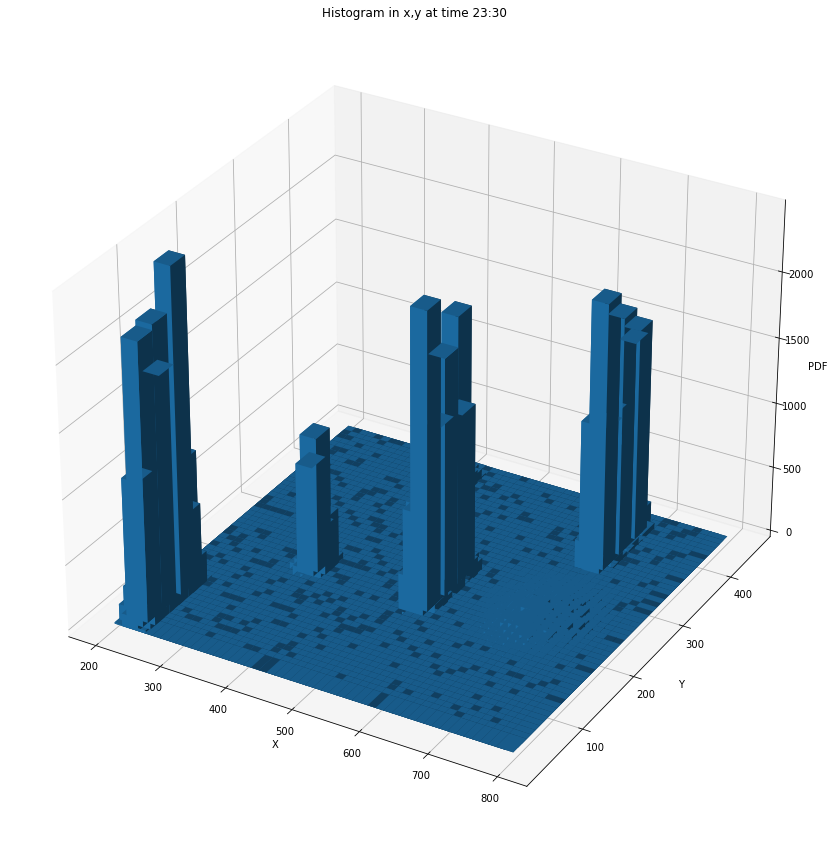

[[1.73430475e-06 2.08116570e-05 3.98890093e-05 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [1.68227561e-05 1.91814106e-04 3.68366329e-04 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [3.98890093e-06 5.09885597e-05 8.79292509e-05 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]]


In [54]:
arr = []
for i in range(0, 24):
    fig = plt.figure(figsize=(15, 15))
    ax = fig.add_subplot(projection='3d')
    hist, xedges, yedges = np.histogram2d(df['X'][(df["hour"]==i) & (df["min"]==30)], df['Y'][(df["hour"]==i) & (df["min"]==30)], bins=50)
# Construct arrays for the anchor positions of the 16 bars.
    xpos, ypos = np.meshgrid(xedges[:-1] + 25, yedges[:-1] + 25, indexing="ij")
    xpos = xpos.ravel()
    ypos = ypos.ravel()
    zpos = 0

# Construct arrays with the dimensions for the 16 bars.
    dx = dy = 25 * np.ones_like(zpos)
    dz = hist.ravel()
    arr.append(hist)
    ax.bar3d(xpos, ypos, zpos, dx, dy, dz, zsort='average')
    ax.set_title('Histogram in x,y at time {}:30'.format(i))
    ax.set_xlabel('X')
    ax.set_ylabel('Y')
    ax.set_zlabel('PDF')
    plt.show()
    hist_prob = hist/len(df['X'][(df["hour"]==i) & (df["min"]==30)])
    hist_pdf = hist_prob/((xedges[1]-xedges[0])*(yedges[1]-yedges[0]))
    print(hist_pdf)

In [55]:
df = pd.DataFrame(pd.read_csv("tuesday.csv"))

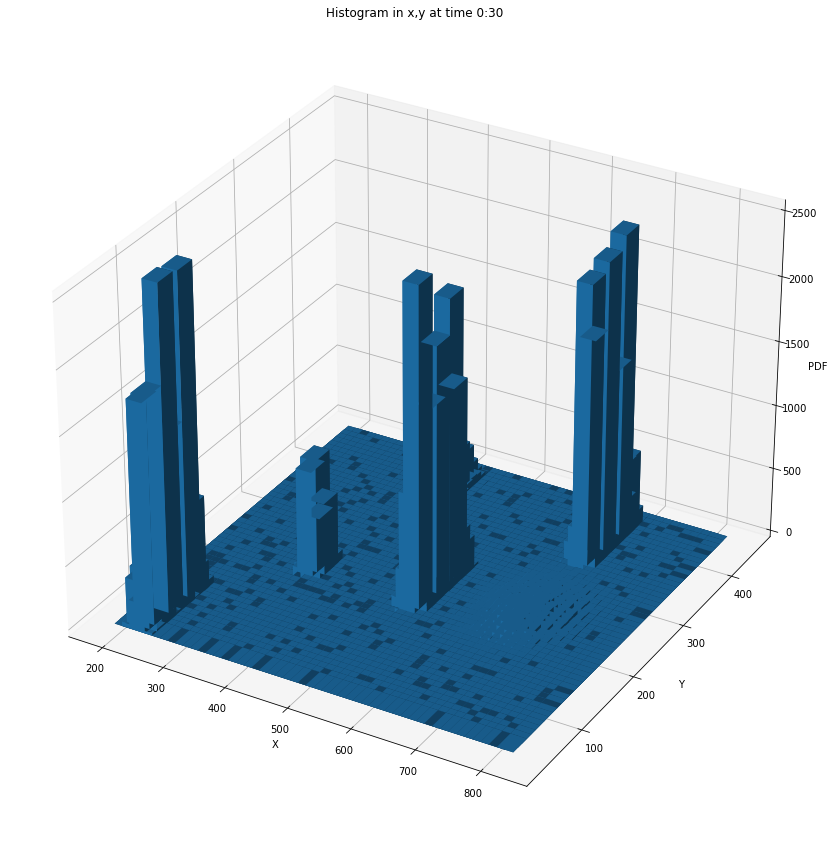

[[0.00000000e+00 0.00000000e+00 1.65153967e-07 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [5.61523489e-06 5.79690426e-05 6.82085885e-05 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [3.69944887e-05 2.88358827e-04 2.90670983e-04 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]]


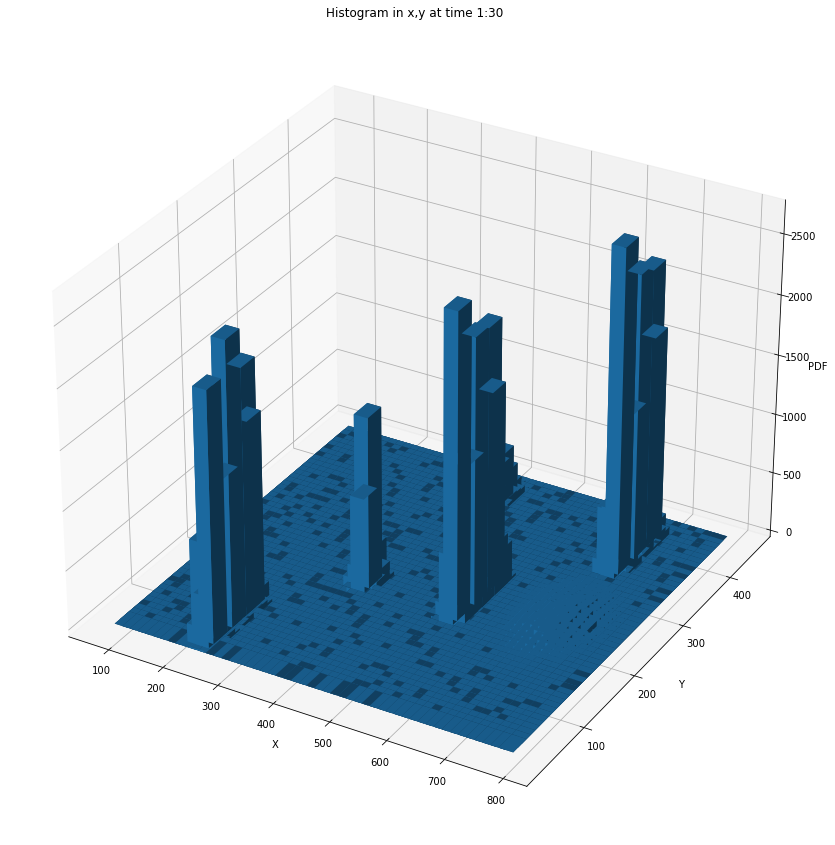

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]


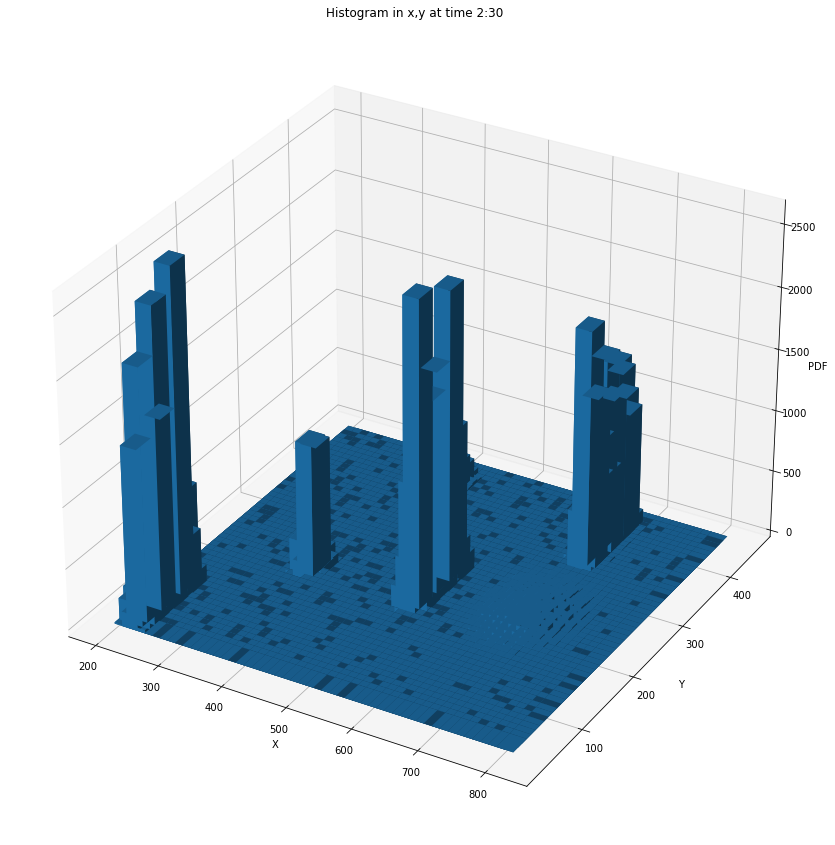

[[1.85201945e-06 2.99690420e-05 4.12495242e-05 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [2.00354832e-05 2.41435990e-04 3.45654176e-04 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [4.54586593e-06 4.46168322e-05 6.31370268e-05 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]]


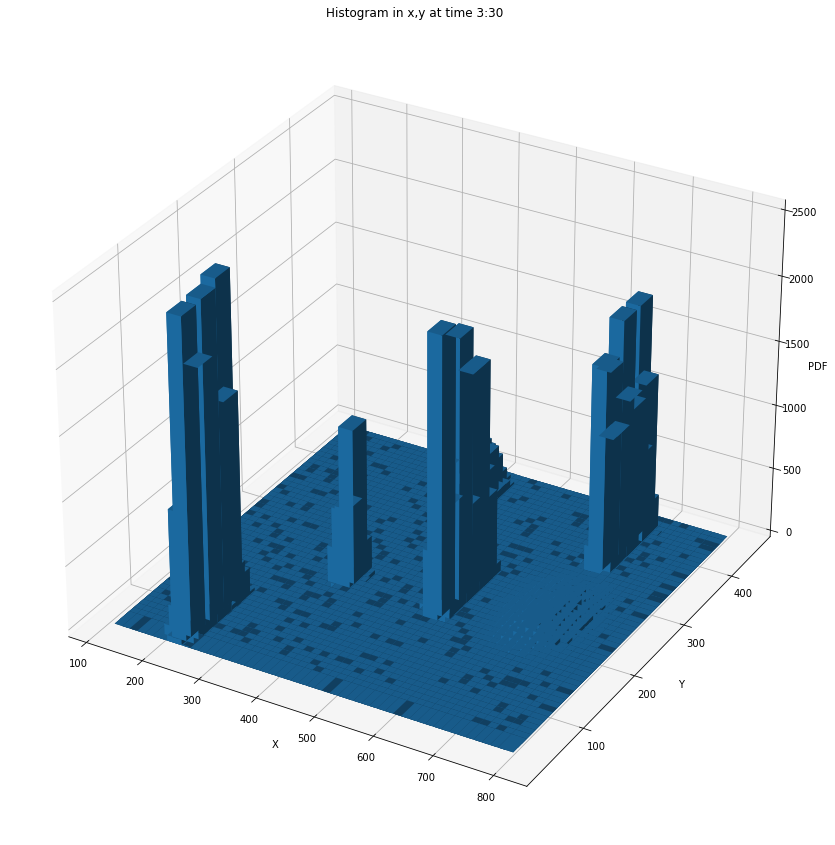

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]


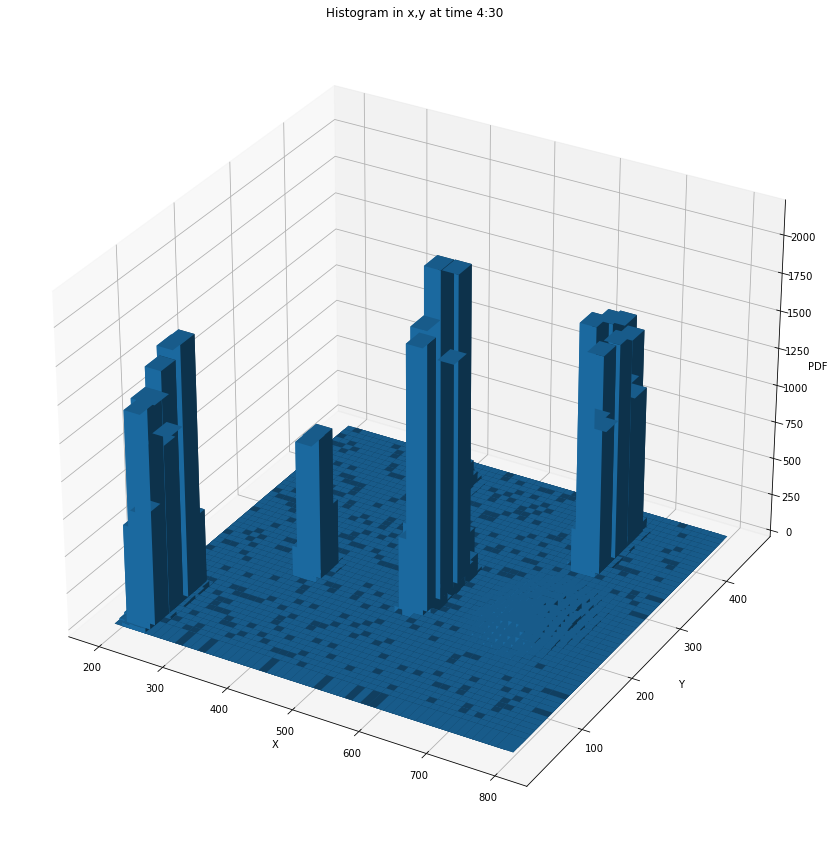

[[0.00000000e+00 1.49397883e-06 3.65194825e-06 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [3.81794590e-06 1.09392450e-04 2.31400721e-04 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [5.31192472e-06 1.27984186e-04 2.46672504e-04 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]]


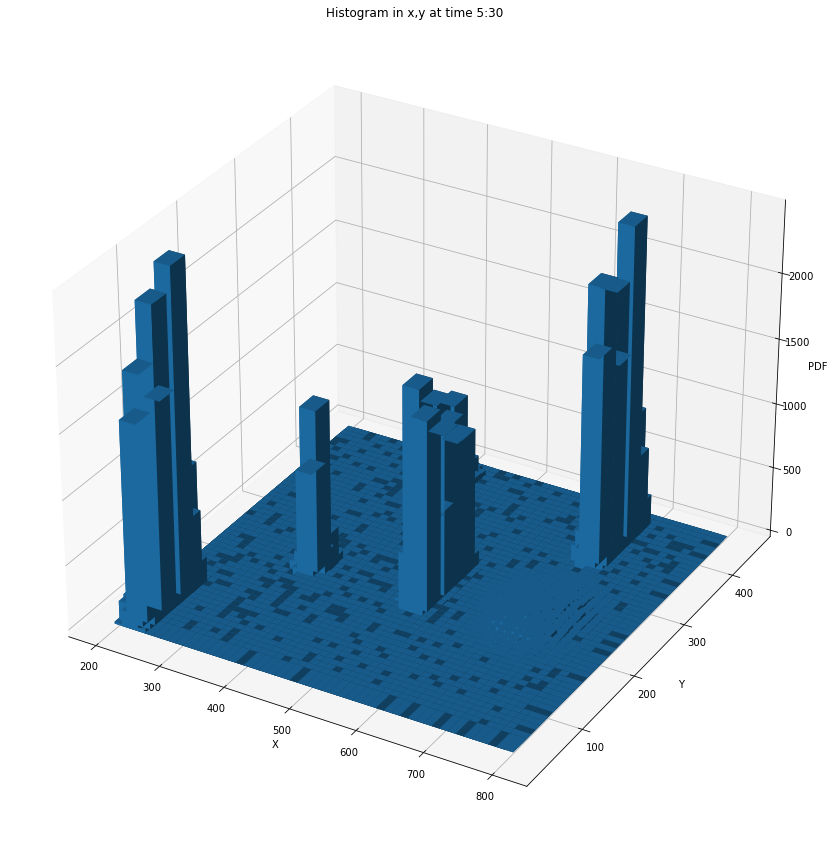

[[2.60744038e-06 2.52052570e-05 2.92033323e-05 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [2.17286698e-05 2.69261677e-04 3.28537488e-04 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [5.21488076e-06 5.82328351e-05 7.87446995e-05 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]]


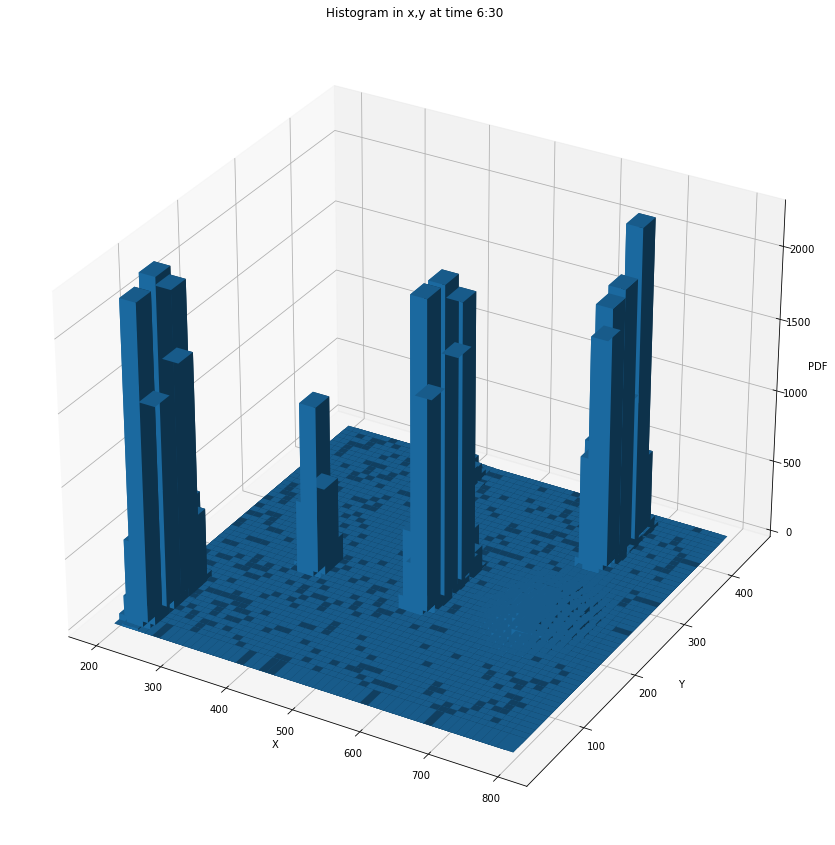

[[5.20579407e-07 7.46163816e-06 2.46407586e-05 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [2.94994997e-06 1.00992405e-04 3.81064126e-04 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [6.94105875e-07 3.86964026e-05 1.14180417e-04 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]]


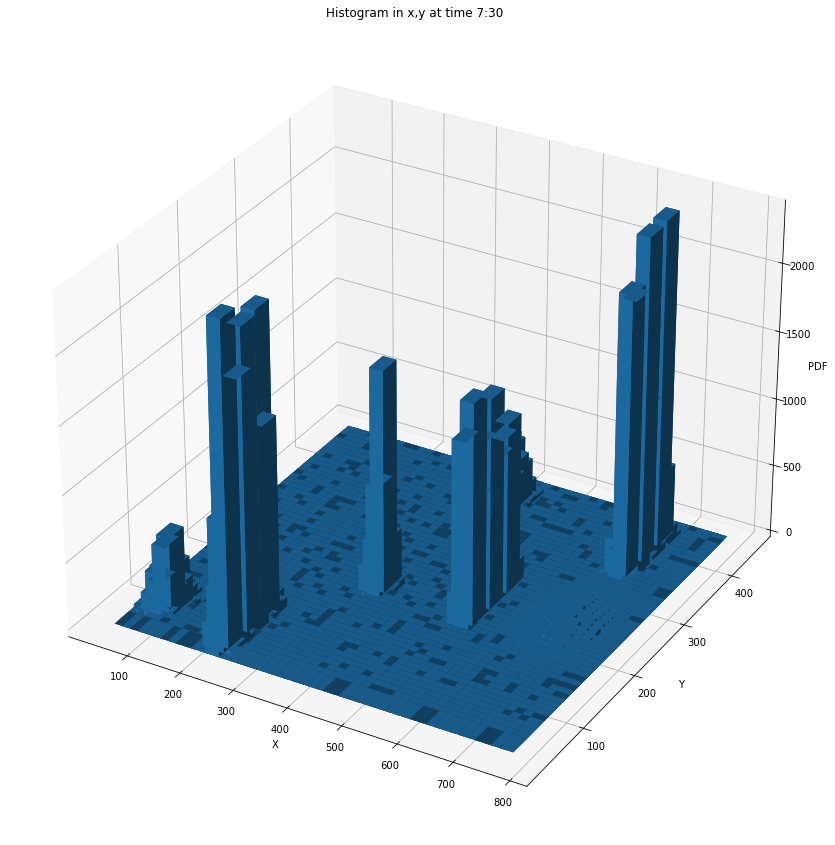

[[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 7.00981316e-07 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 1.40196263e-07 1.40196263e-06 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]]


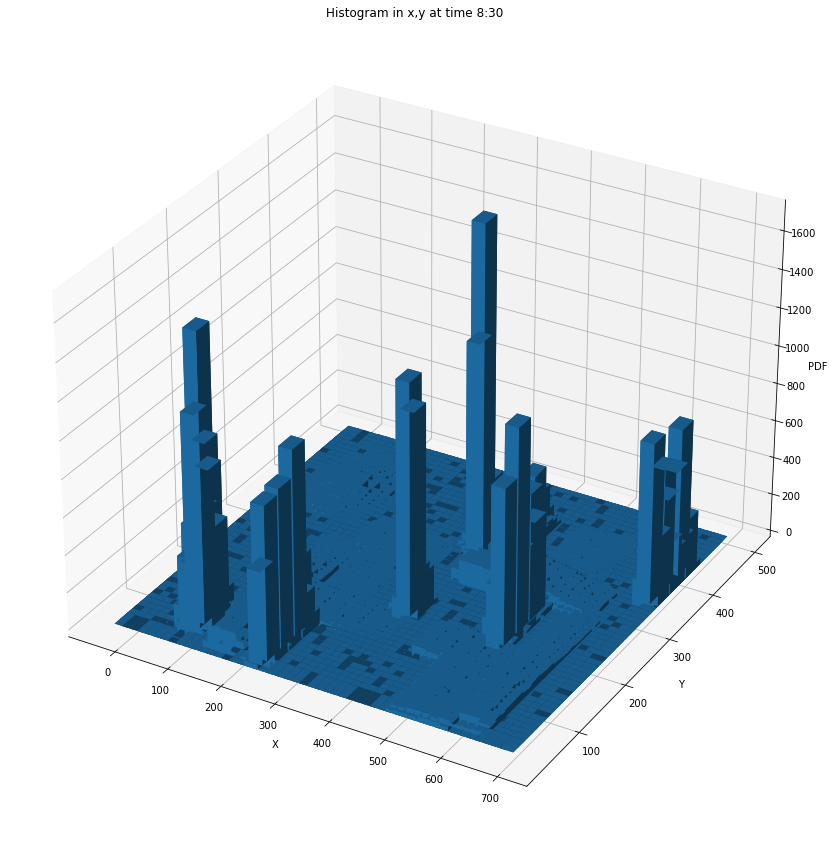

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]


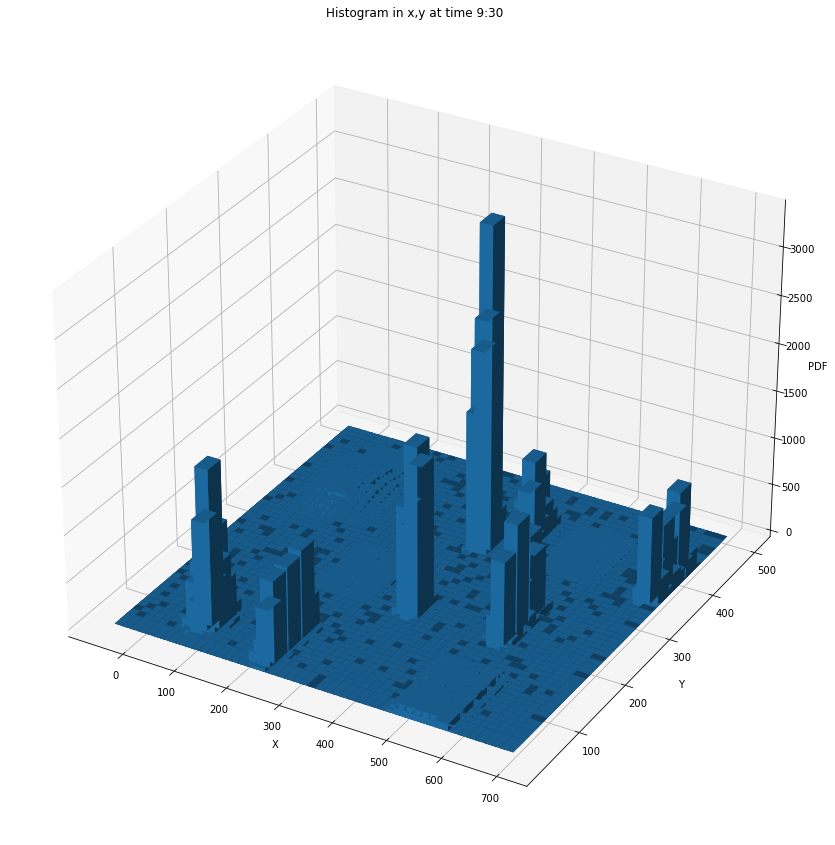

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]


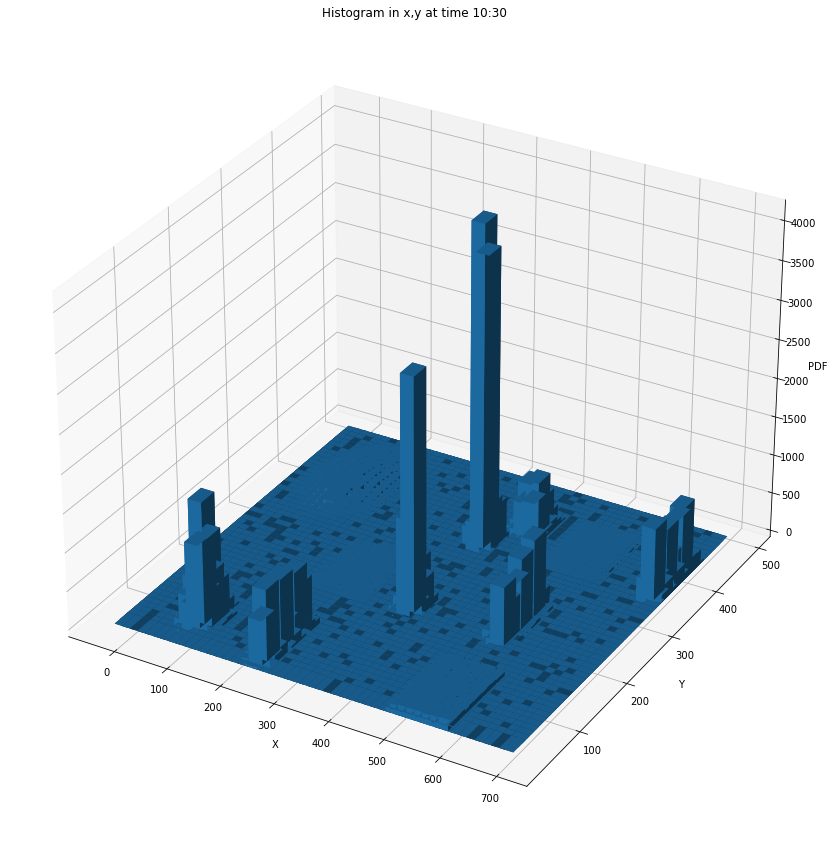

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]


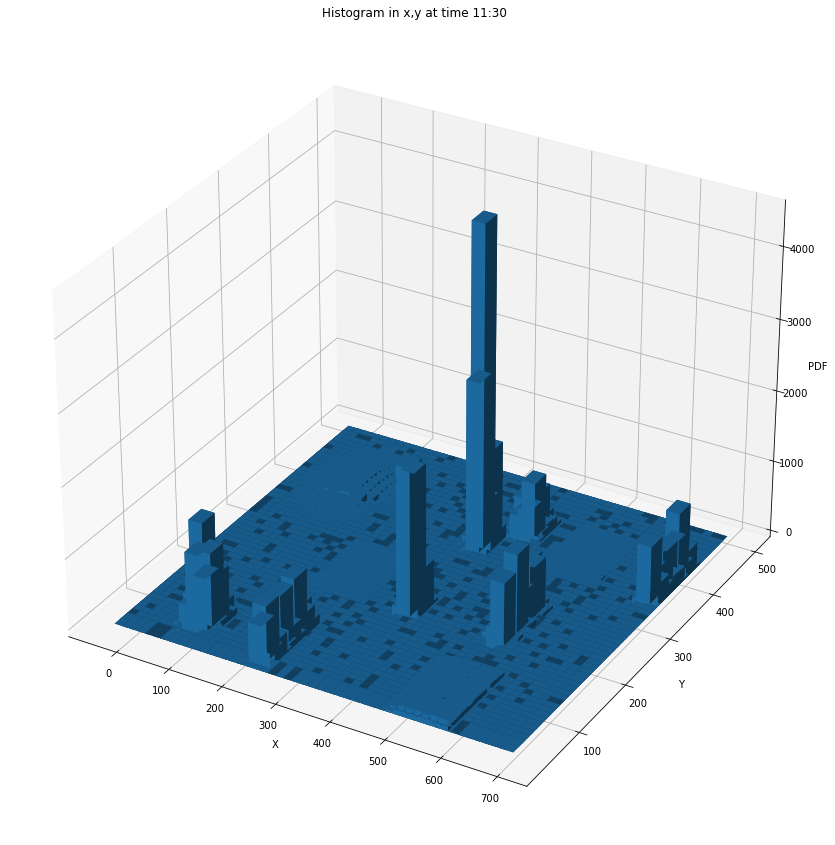

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]


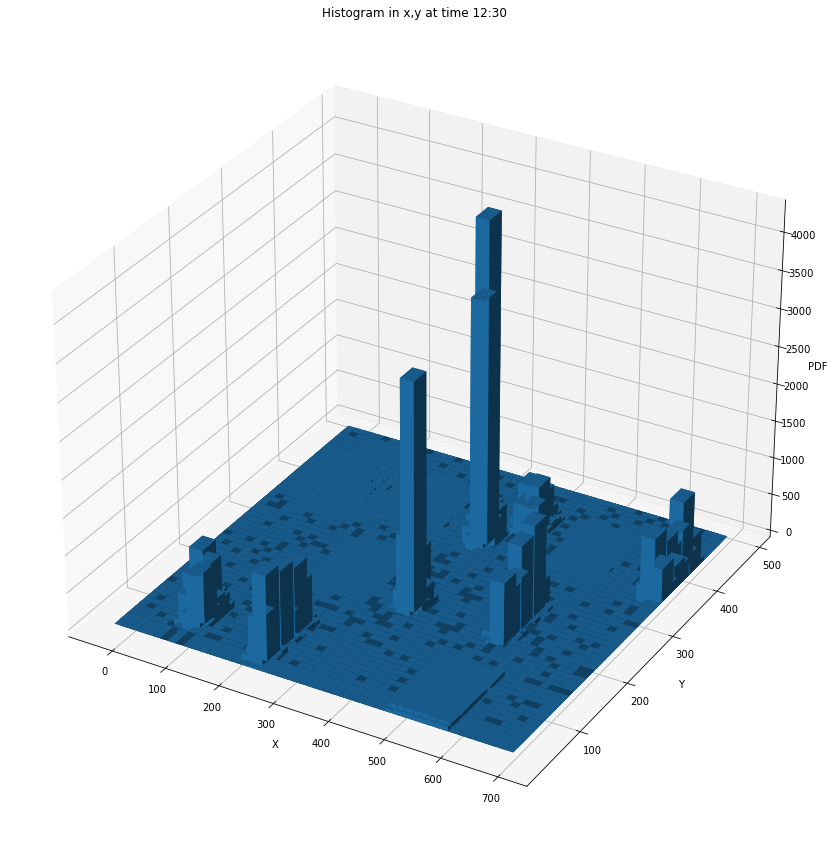

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]


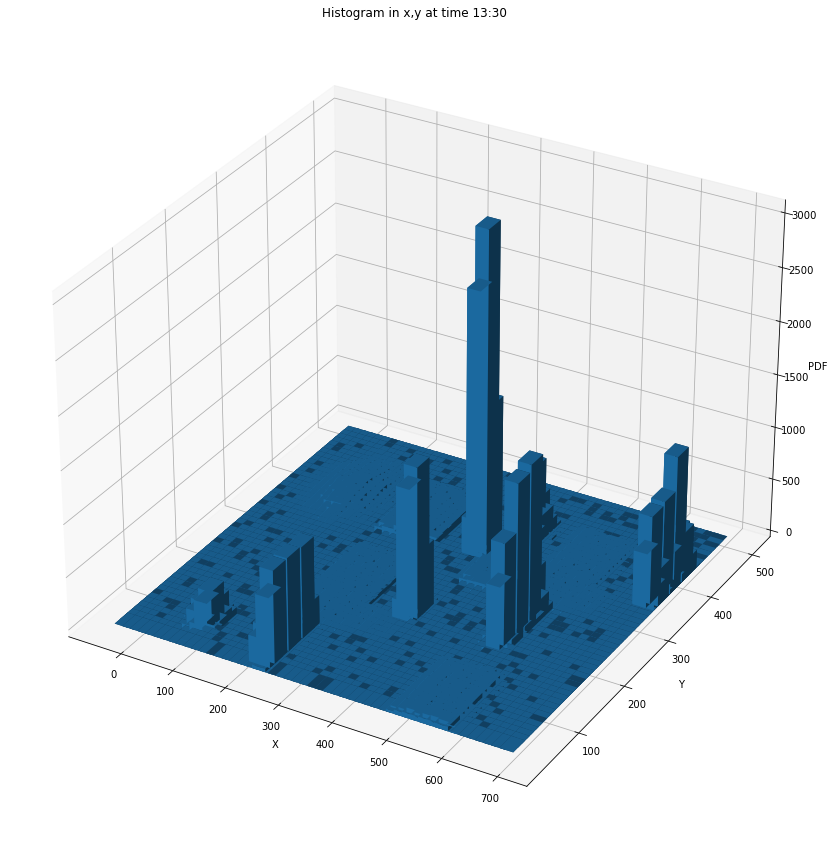

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]


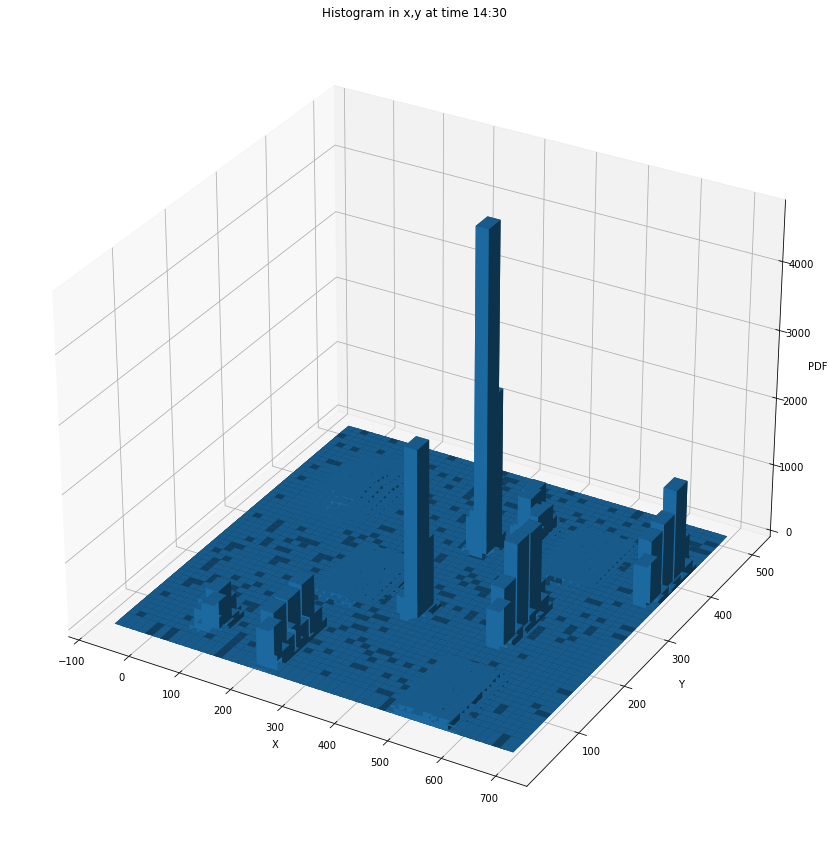

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]


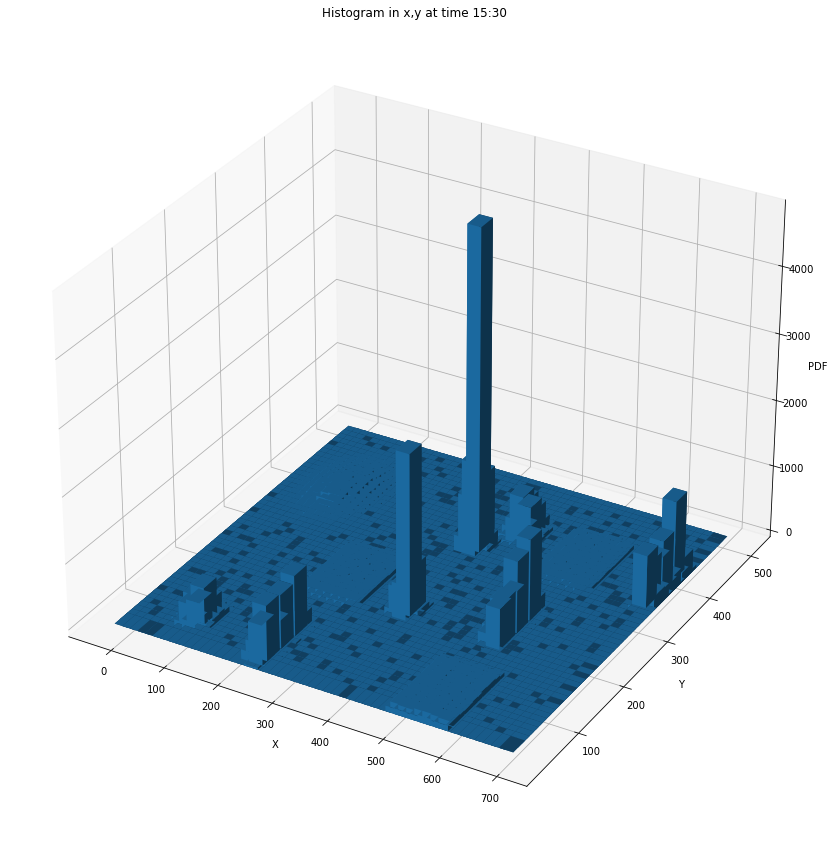

[[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.23427872e-07
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]]


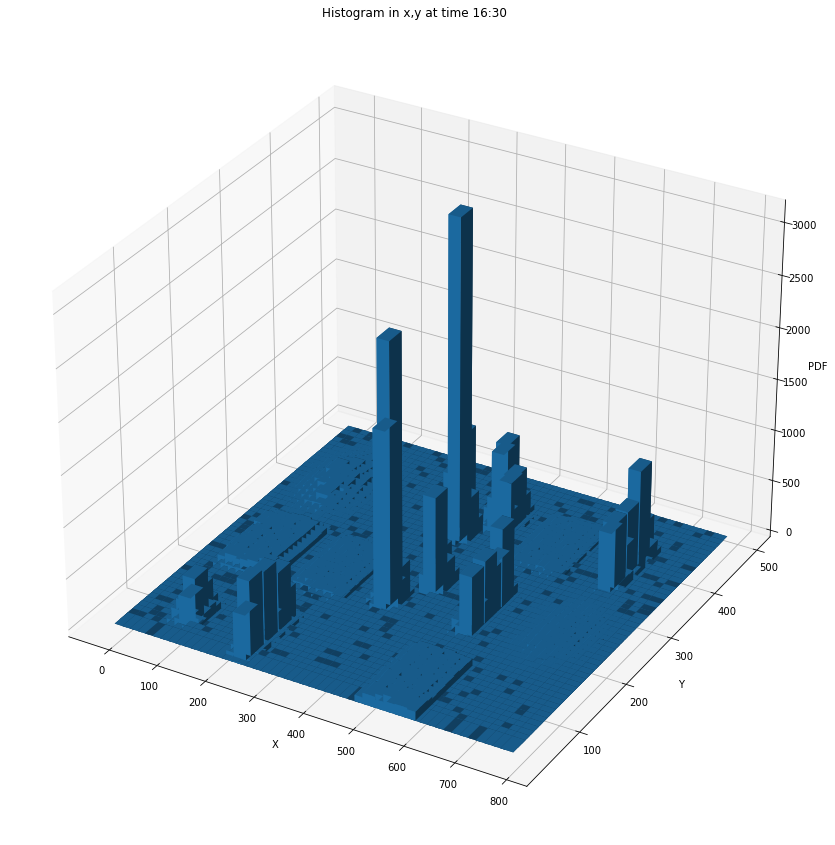

[[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.14348701e-07
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]]


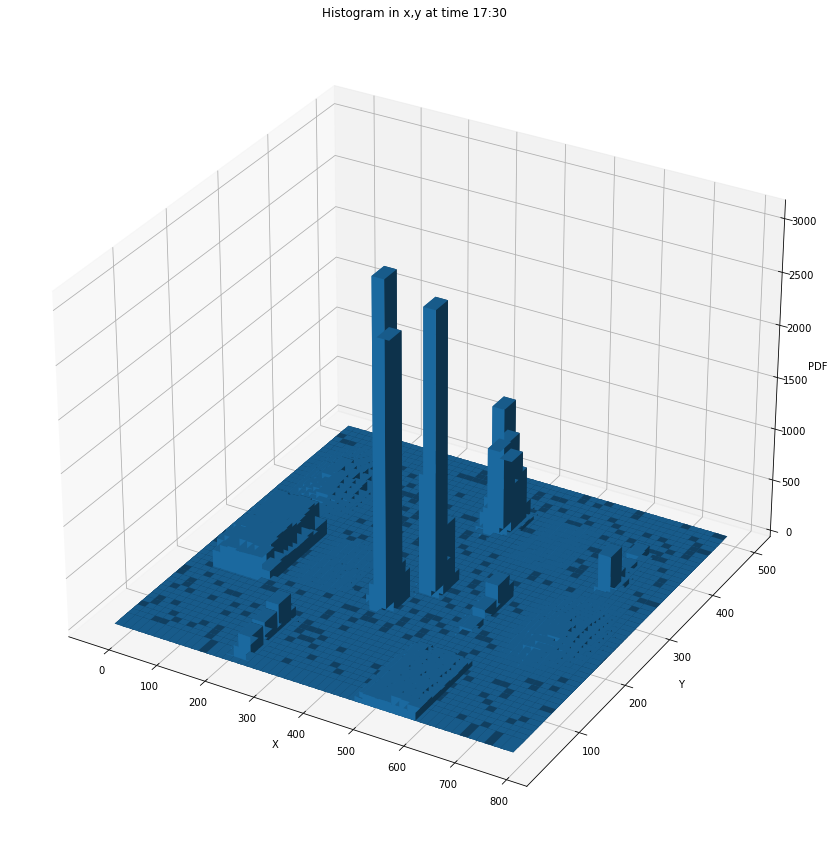

[[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 1.12993441e-07]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]]


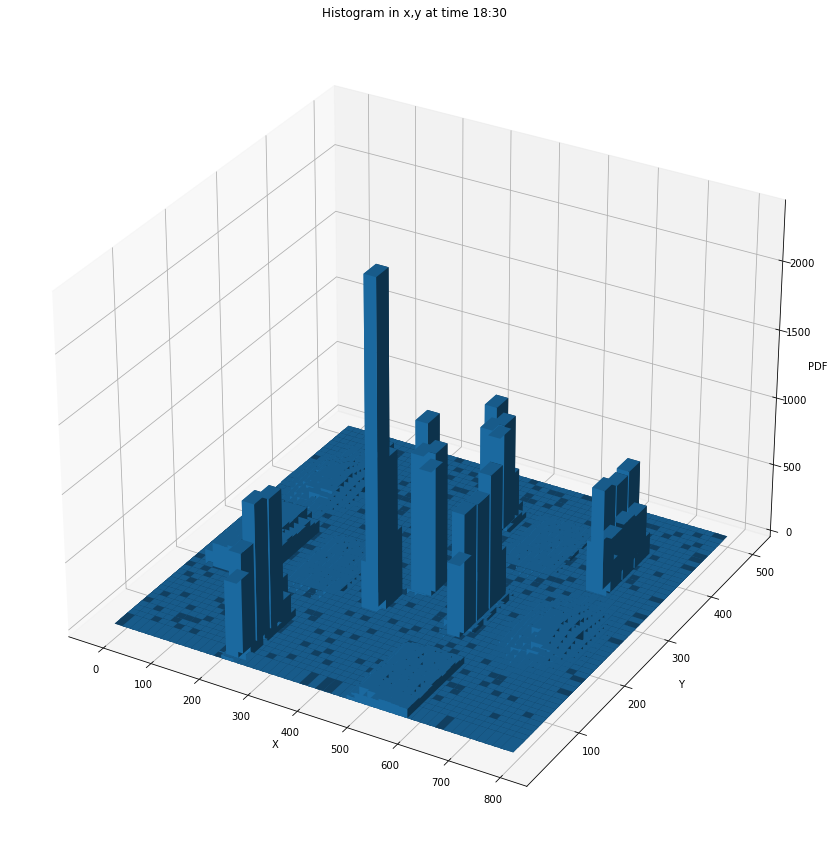

[[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.11789879e-07
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]]


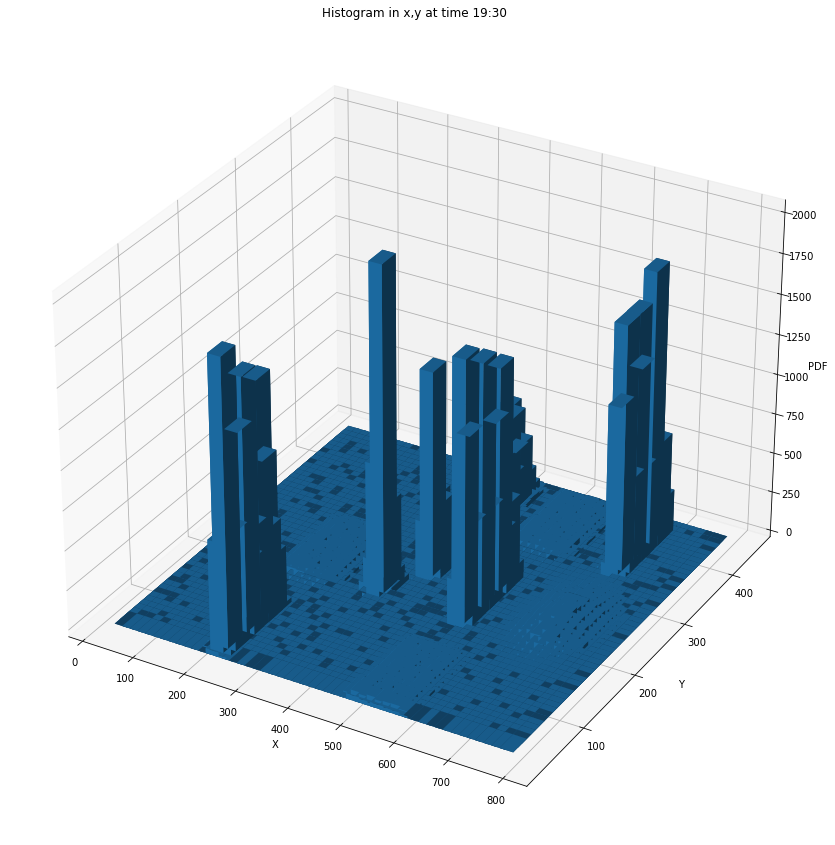

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]


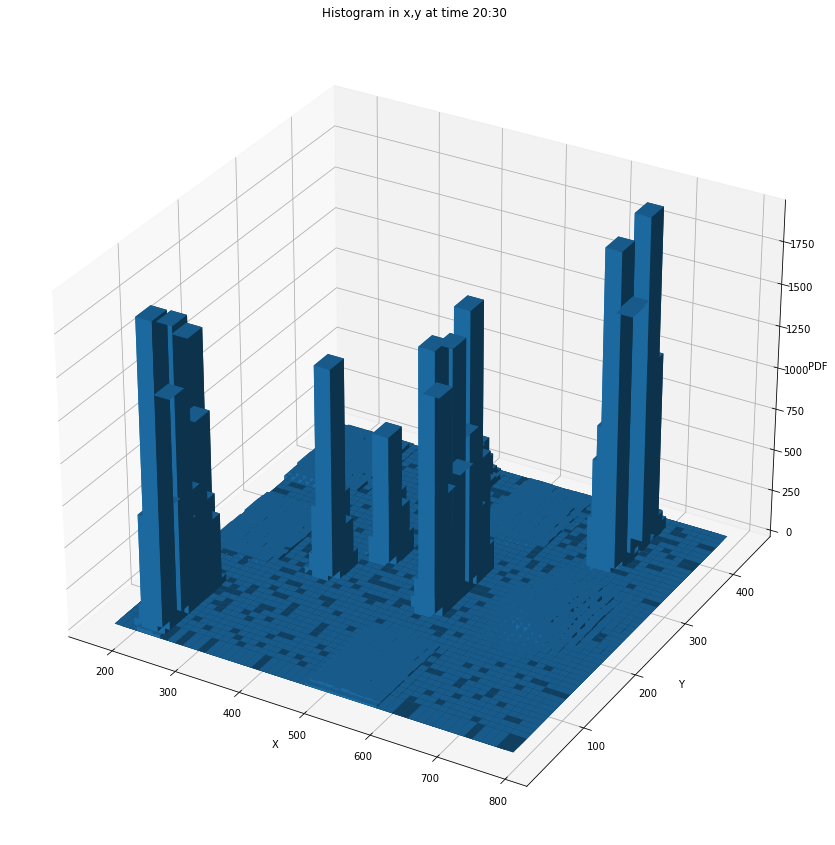

[[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 4.96099298e-06
  5.30313042e-06 1.19748106e-06]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 4.44778681e-06
  5.64526787e-06 5.13206170e-07]
 [0.00000000e+00 7.18488638e-06 1.72779411e-05 ... 4.27671808e-06
  5.30313042e-06 1.19748106e-06]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]]


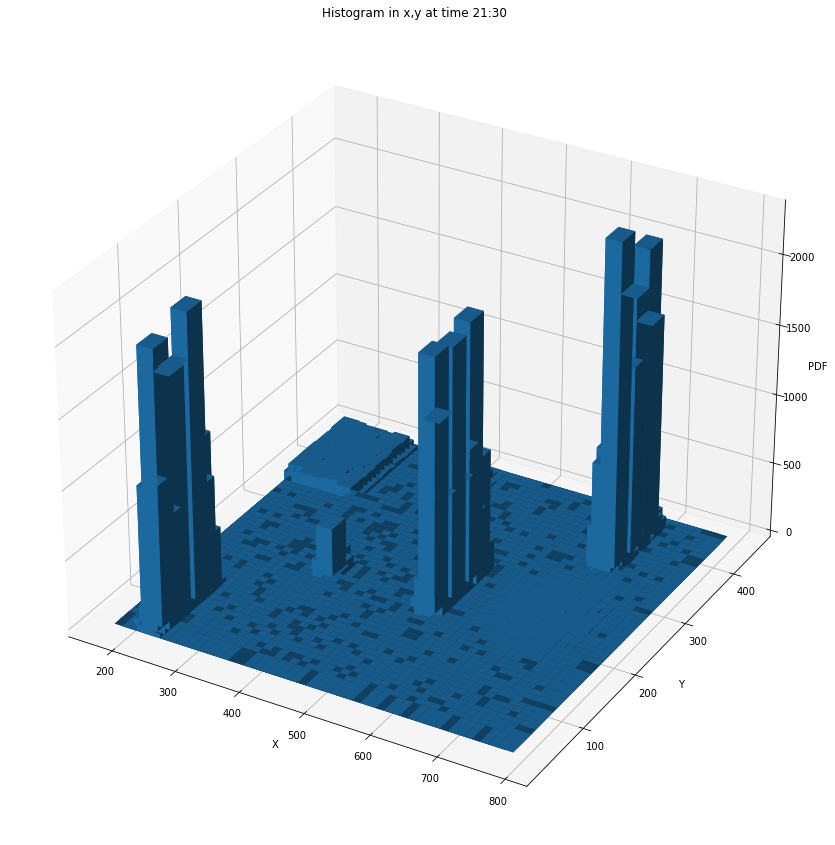

[[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.41207937e-05
  1.70482753e-05 3.78850561e-06]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.34319745e-05
  1.61872513e-05 4.47732482e-06]
 [1.72204801e-07 8.43803523e-06 1.91147329e-05 ... 1.42929985e-05
  1.42929985e-05 5.51055362e-06]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]]


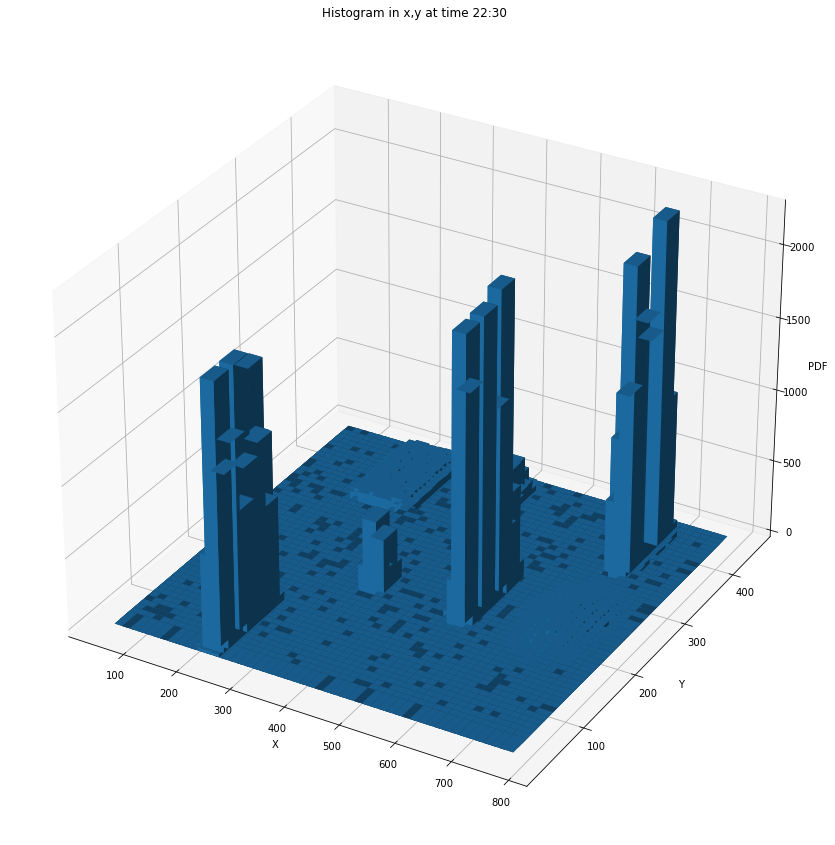

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]


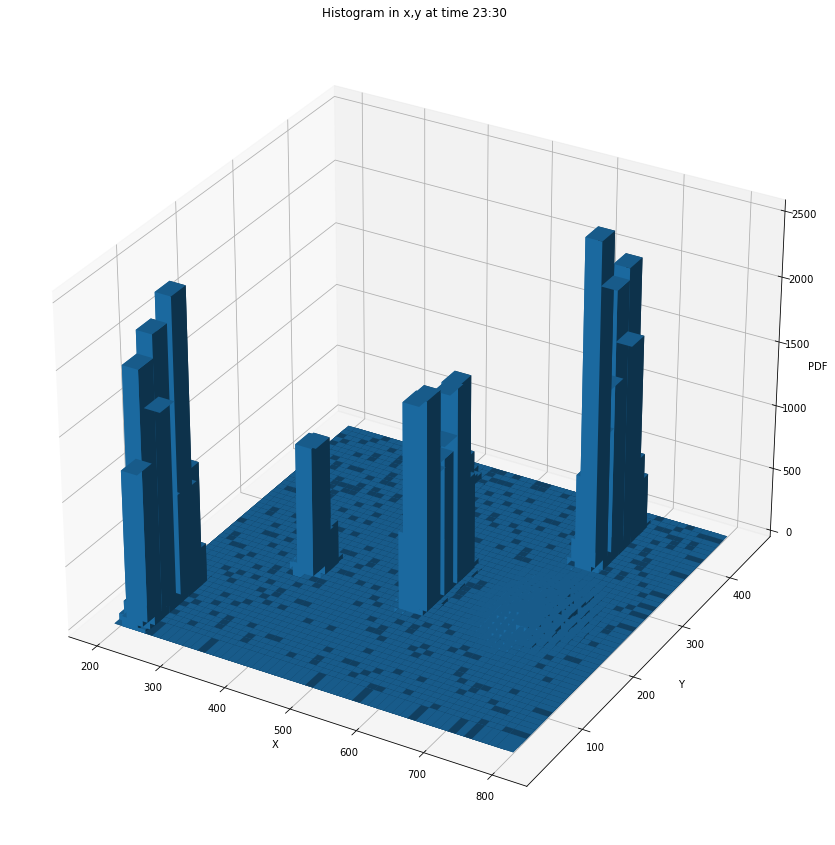

[[5.10168532e-07 8.33275269e-06 1.98965728e-05 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [1.32643818e-05 2.01516570e-04 3.32629883e-04 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [4.76157297e-06 7.85659540e-05 1.26521796e-04 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]]


In [56]:
arr = []
for i in range(0, 24):
    fig = plt.figure(figsize=(15, 15))
    ax = fig.add_subplot(projection='3d')
    hist, xedges, yedges = np.histogram2d(df['X'][(df["hour"]==i) & (df["min"]==30)], df['Y'][(df["hour"]==i) & (df["min"]==30)], bins=50)
# Construct arrays for the anchor positions of the 16 bars.
    xpos, ypos = np.meshgrid(xedges[:-1] + 25, yedges[:-1] + 25, indexing="ij")
    xpos = xpos.ravel()
    ypos = ypos.ravel()
    zpos = 0

# Construct arrays with the dimensions for the 16 bars.
    dx = dy = 25 * np.ones_like(zpos)
    dz = hist.ravel()
    arr.append(hist)
    ax.bar3d(xpos, ypos, zpos, dx, dy, dz, zsort='average')
    ax.set_title('Histogram in x,y at time {}:30'.format(i))
    ax.set_xlabel('X')
    ax.set_ylabel('Y')
    ax.set_zlabel('PDF')
    plt.show()
    hist_prob = hist/len(df['X'][(df["hour"]==i) & (df["min"]==30)])
    hist_pdf = hist_prob/((xedges[1]-xedges[0])*(yedges[1]-yedges[0]))
    print(hist_pdf)

In [57]:
df = pd.DataFrame(pd.read_csv("wednesday.csv"))

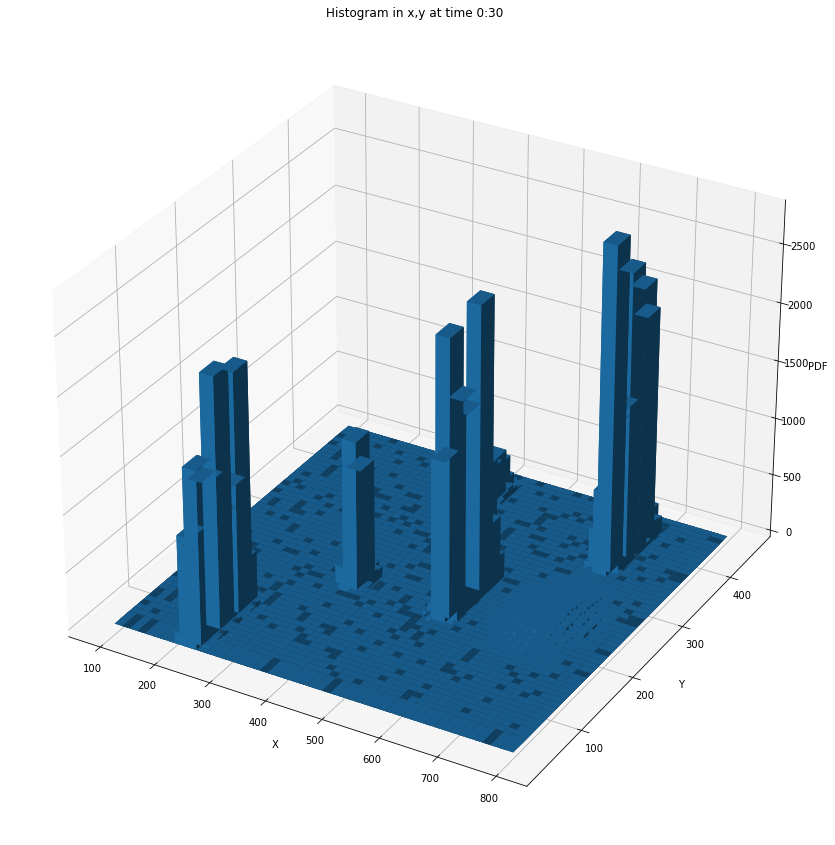

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]


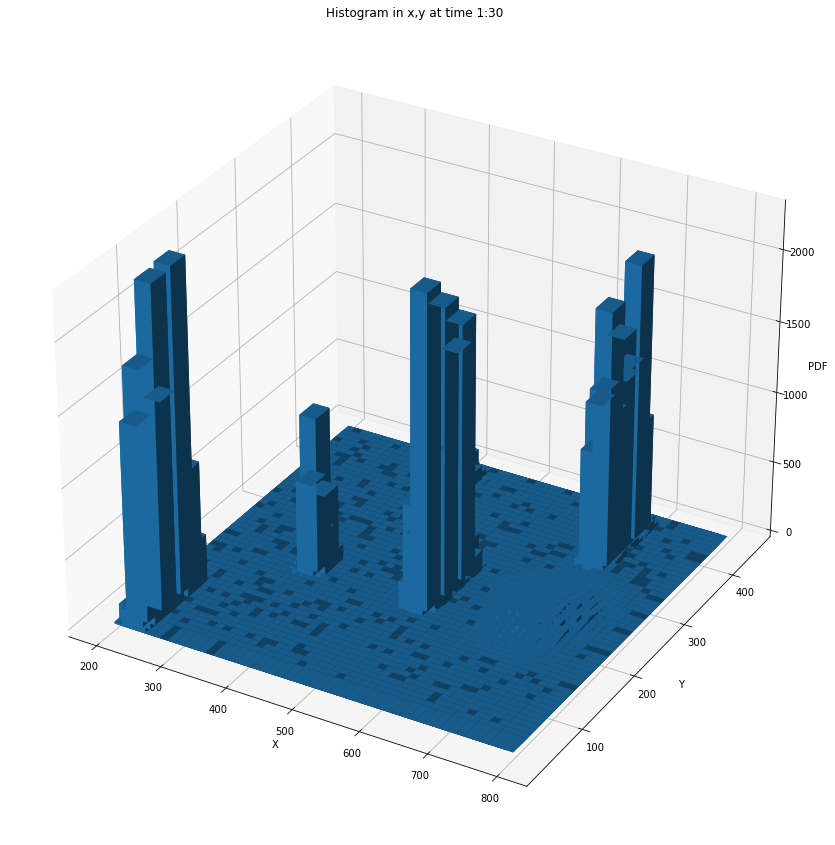

[[2.46150729e-06 1.98678803e-05 1.81096608e-05 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [2.26810315e-05 2.47908949e-04 3.10677385e-04 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [8.61527553e-06 9.00208381e-05 1.13932623e-04 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]]


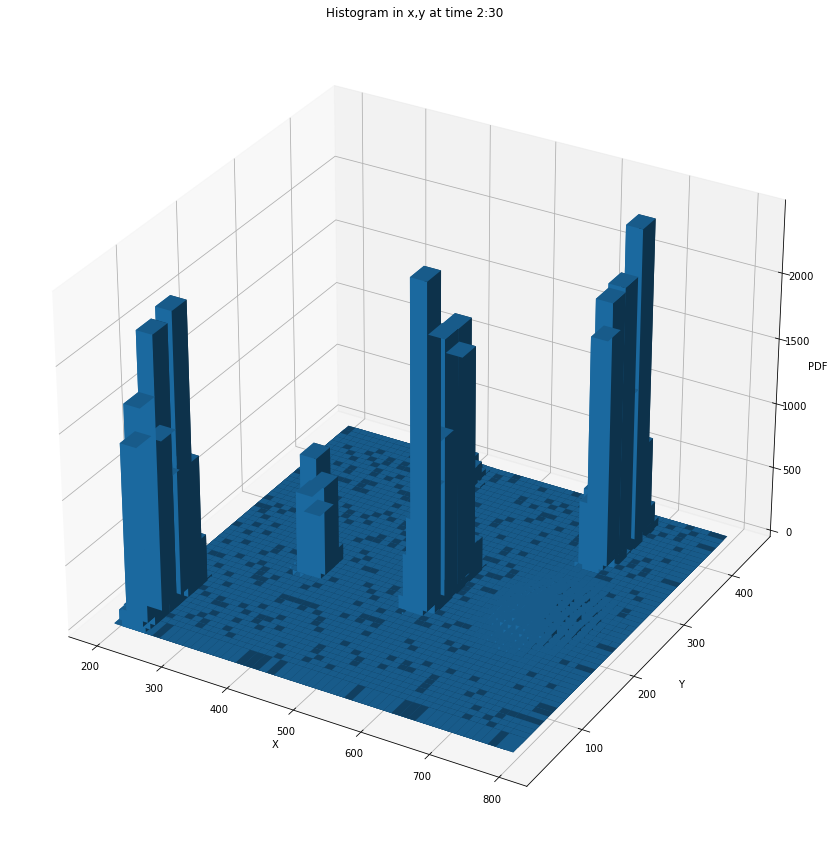

[[1.05638840e-06 1.37330493e-05 1.53176319e-05 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [2.34166096e-05 2.41912944e-04 2.88746164e-04 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [1.19724019e-05 1.17611242e-04 1.28527256e-04 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]]


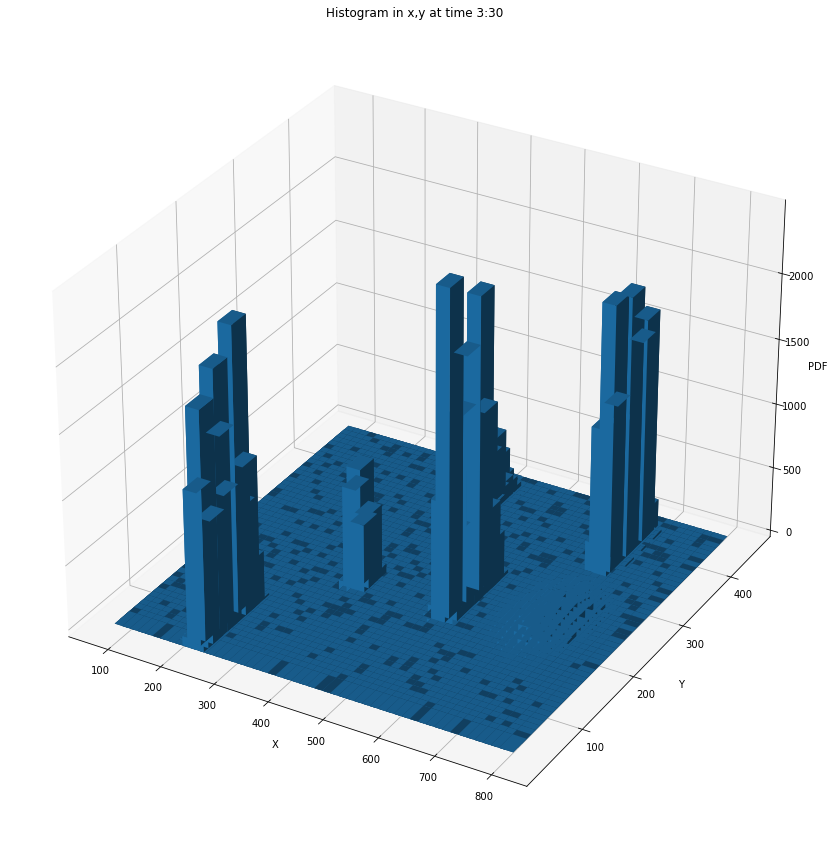

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]


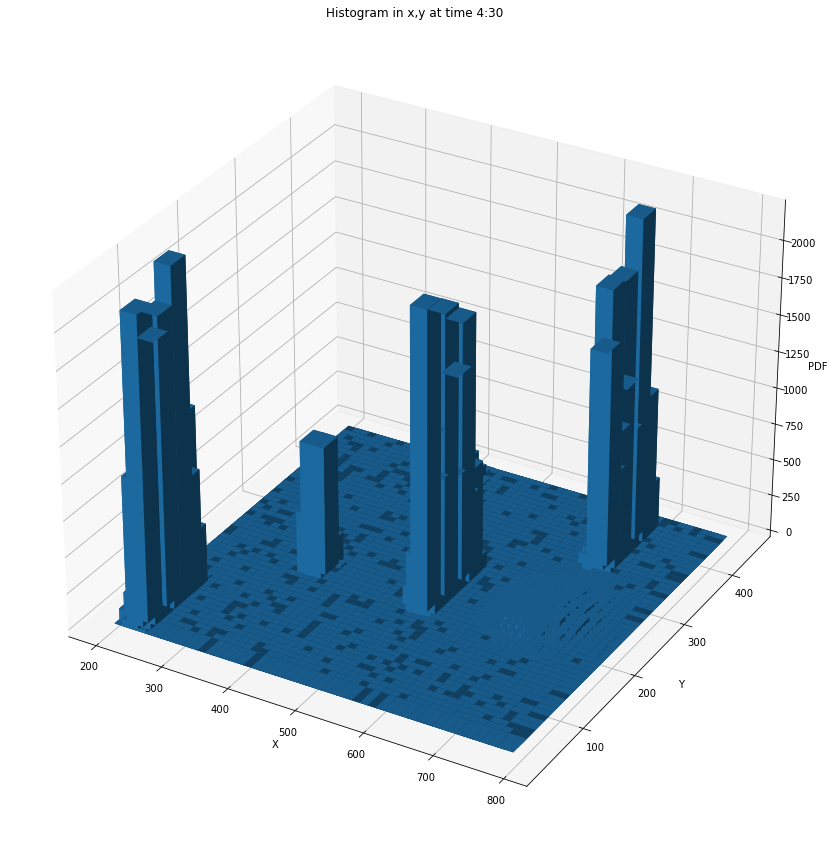

[[5.32522322e-07 1.36680729e-05 2.87562054e-05 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [8.52035715e-06 1.78039963e-04 3.68150432e-04 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [3.19513393e-06 5.32522322e-05 1.20350045e-04 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]]


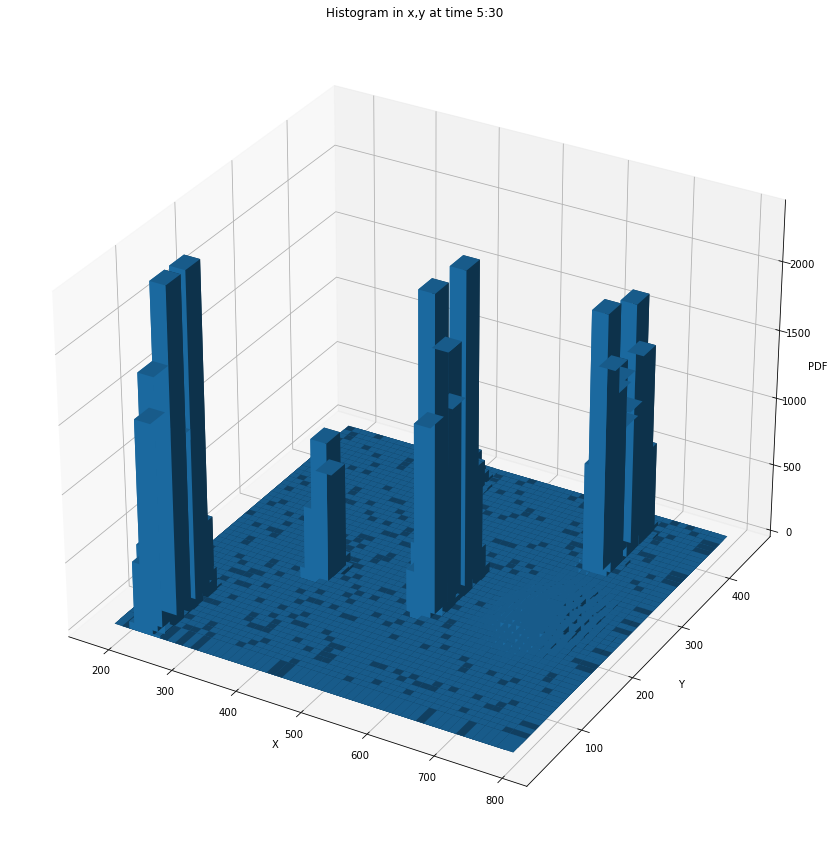

[[0.00000000e+00 1.68891901e-07 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 5.06675702e-07 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [8.78237884e-06 7.88725177e-05 9.55928159e-05 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]]


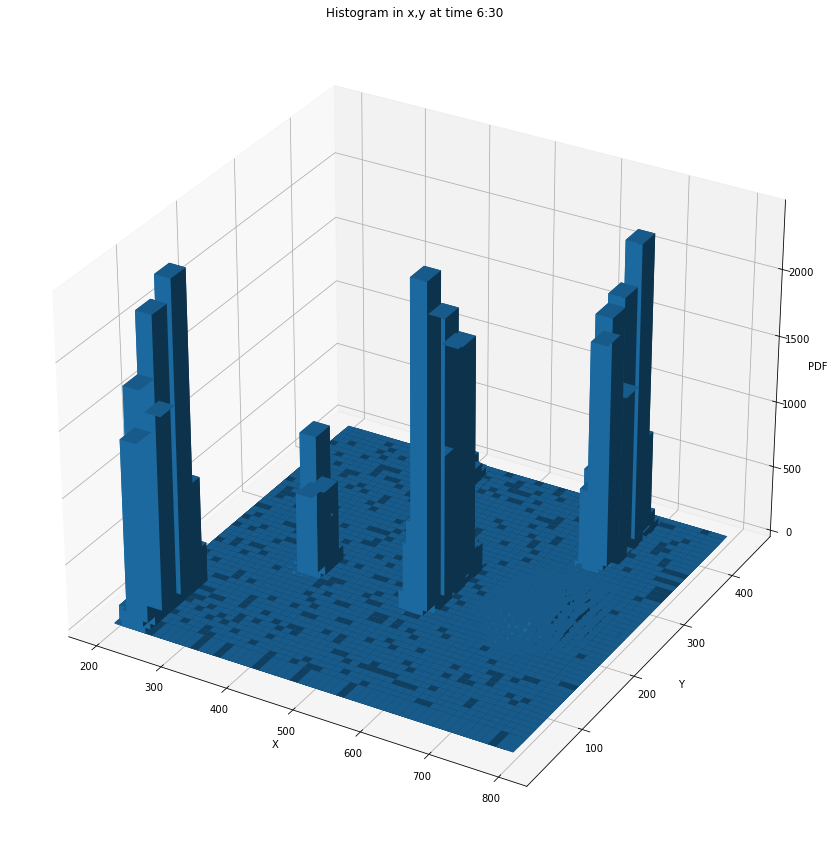

[[1.40815289e-06 1.95381214e-05 1.93621023e-05 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [2.20023889e-05 2.43434431e-04 3.07857426e-04 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [8.62493646e-06 9.85707024e-05 1.14588442e-04 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]]


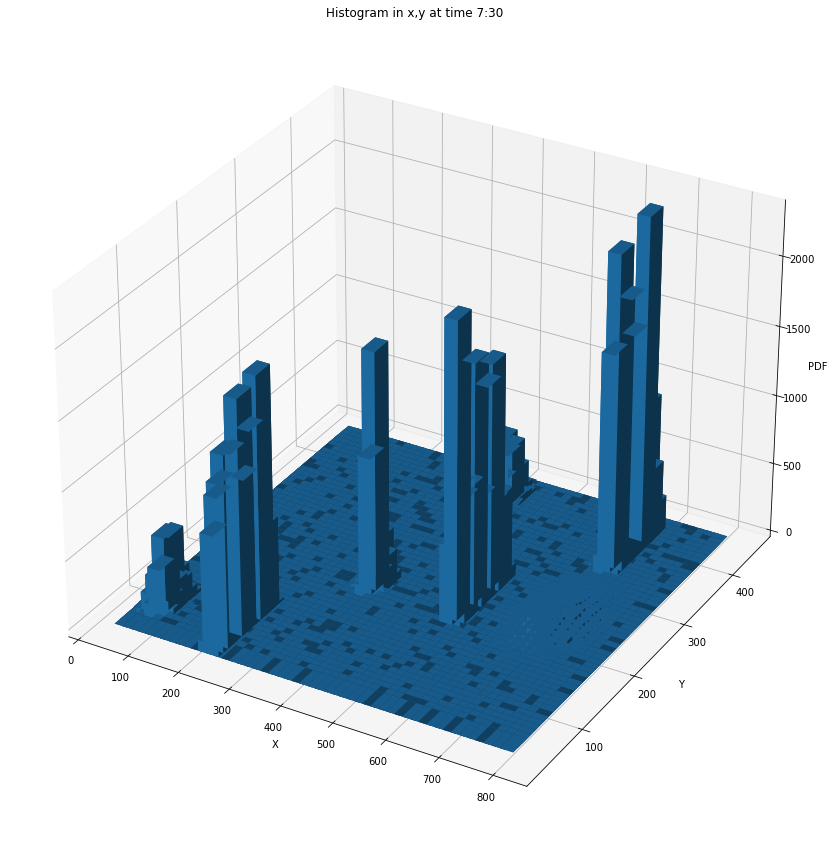

[[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 1.35687758e-07 6.78438790e-07 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 1.35687758e-07 2.57806740e-06 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]]


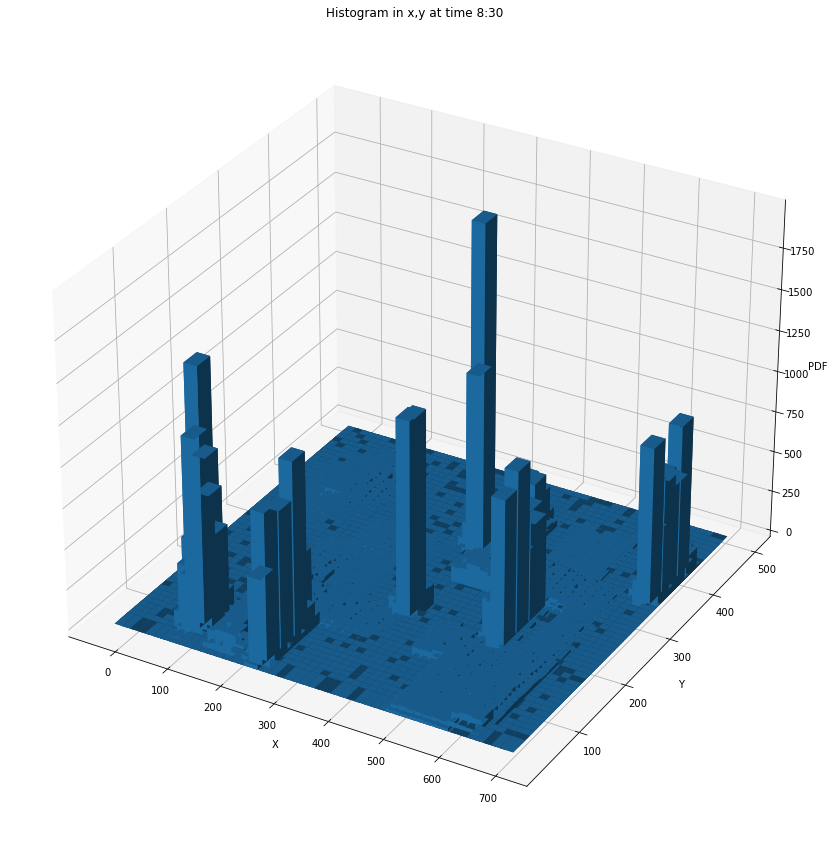

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]


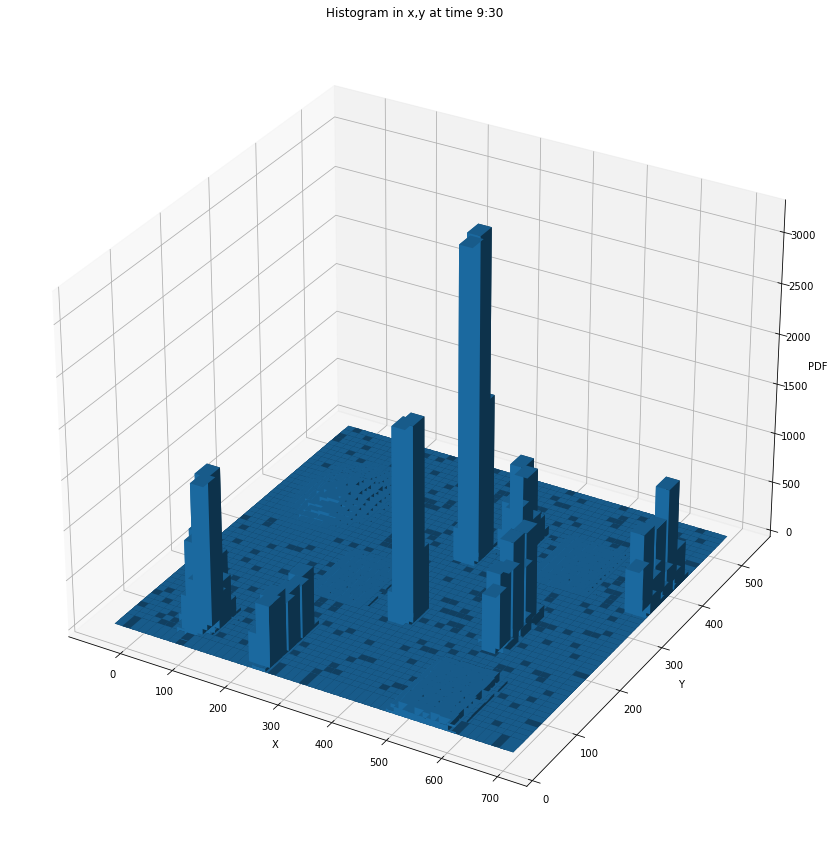

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]


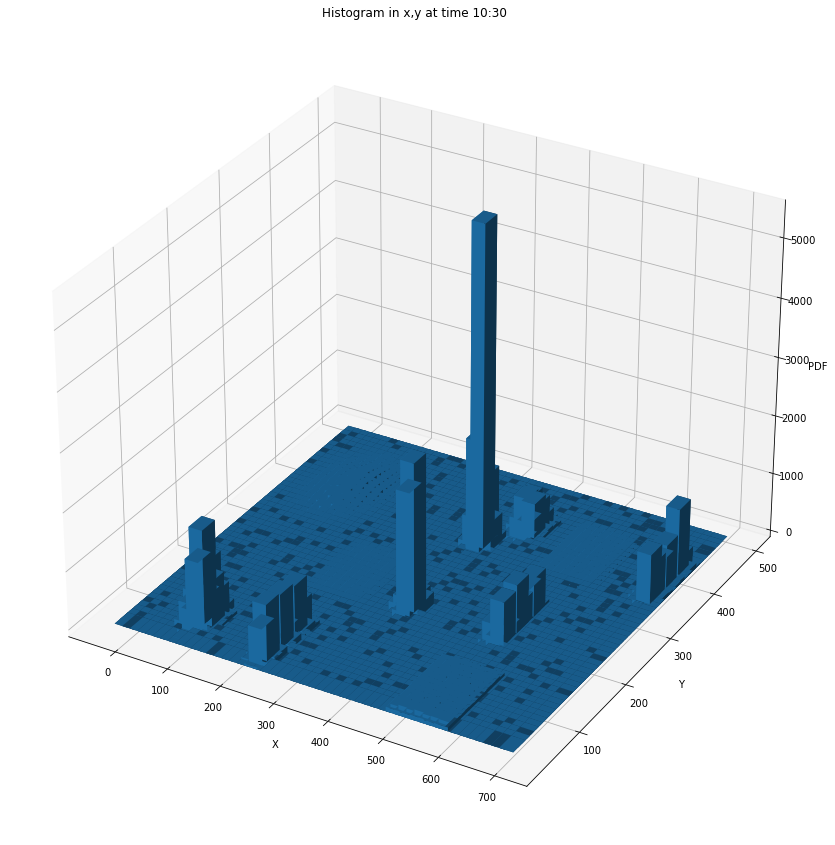

[[0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  1.2466839e-07 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]


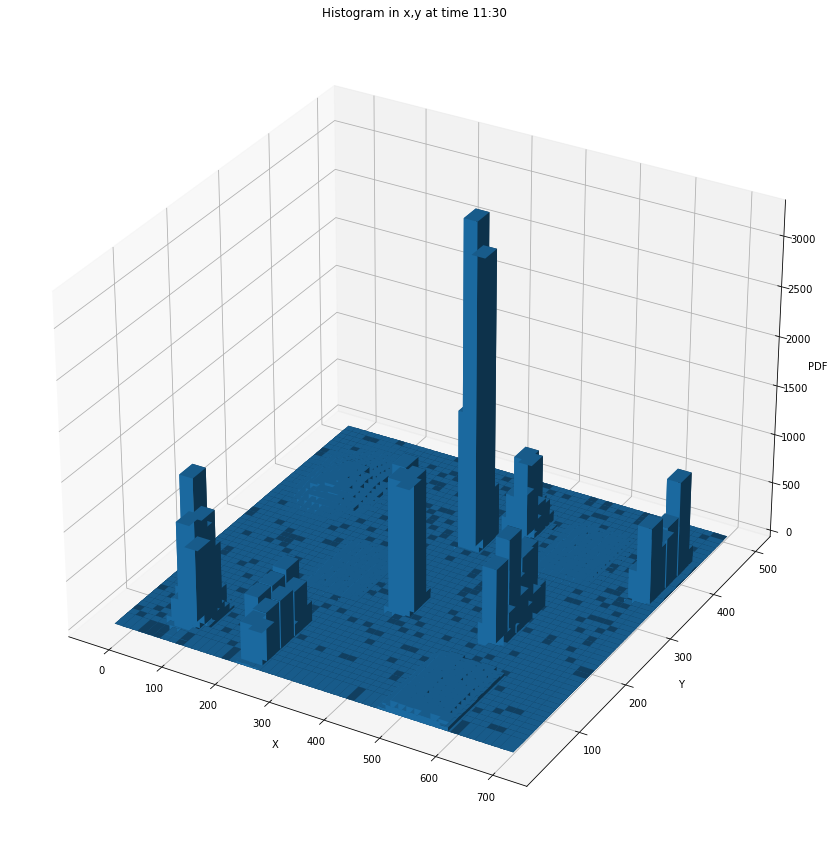

[[0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 1.2598515e-07
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]


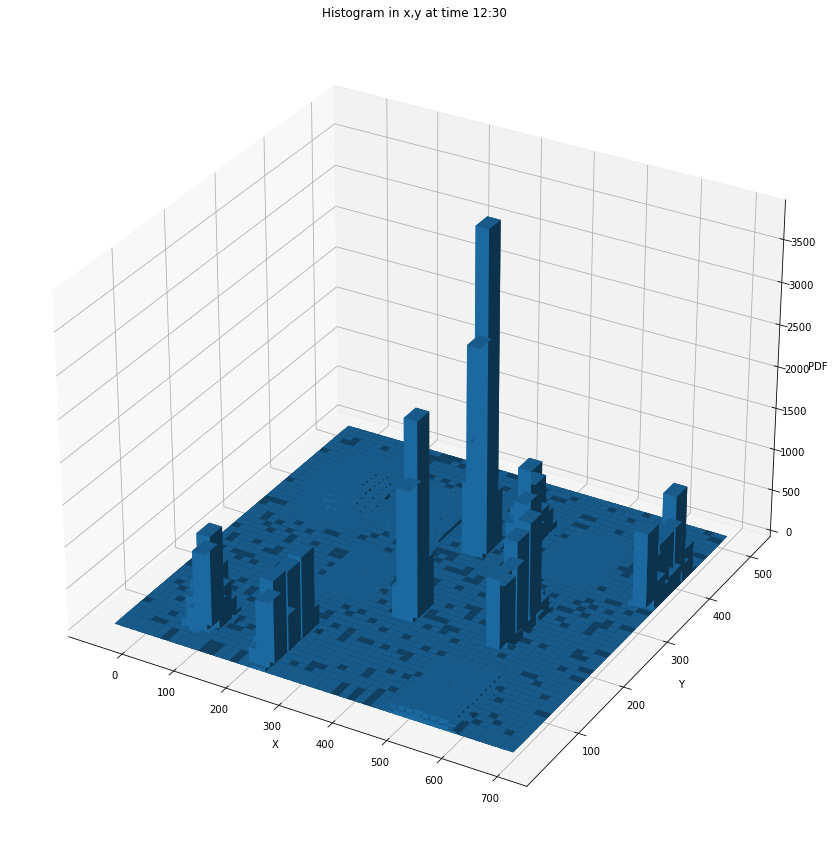

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]


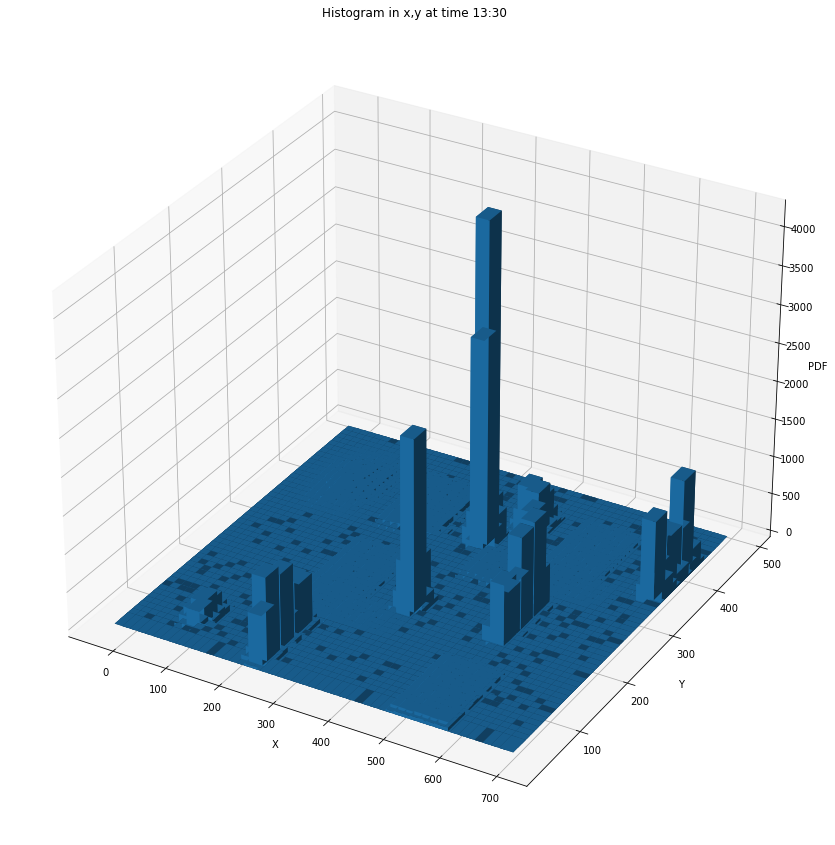

[[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 2.57719364e-07
  0.00000000e+00 1.28859682e-07]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]]


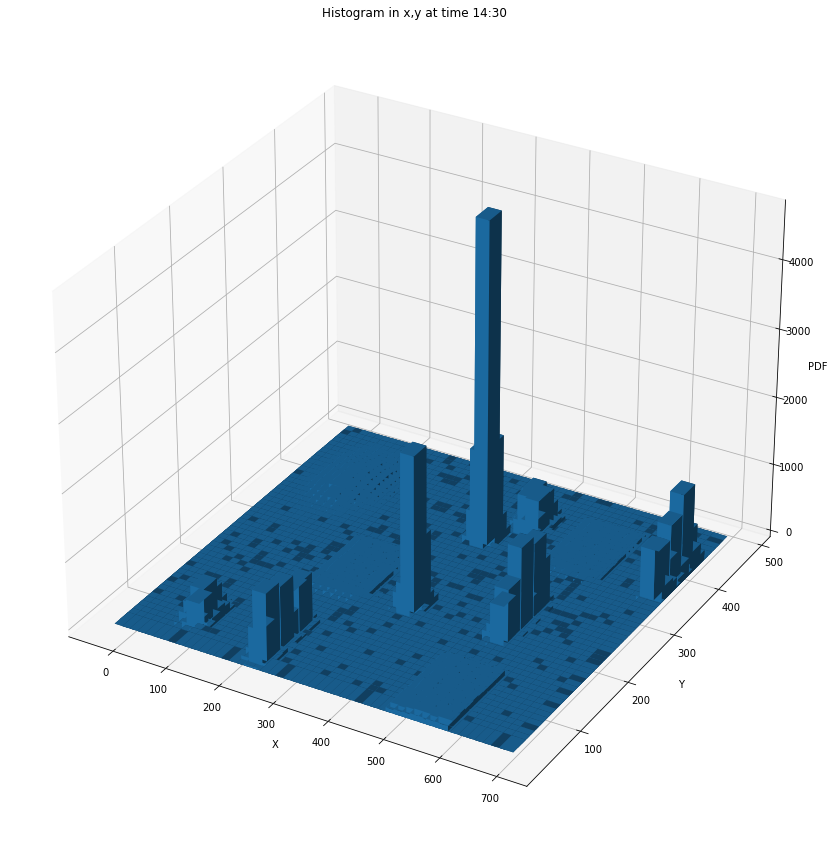

[[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 3.89961205e-07
  0.00000000e+00 1.29987068e-07]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]]


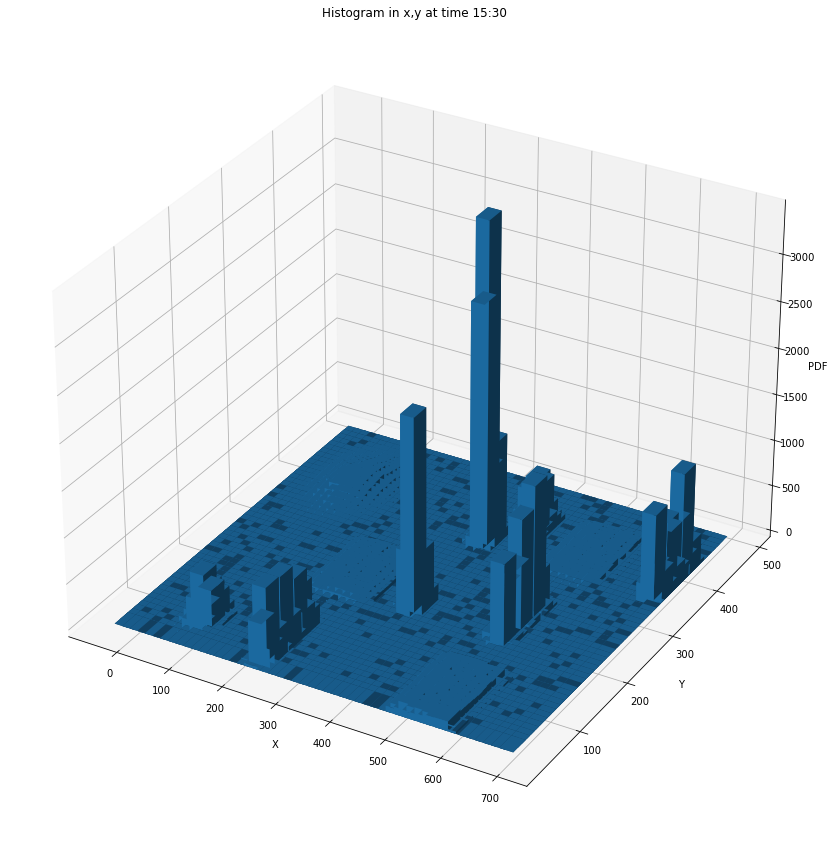

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]


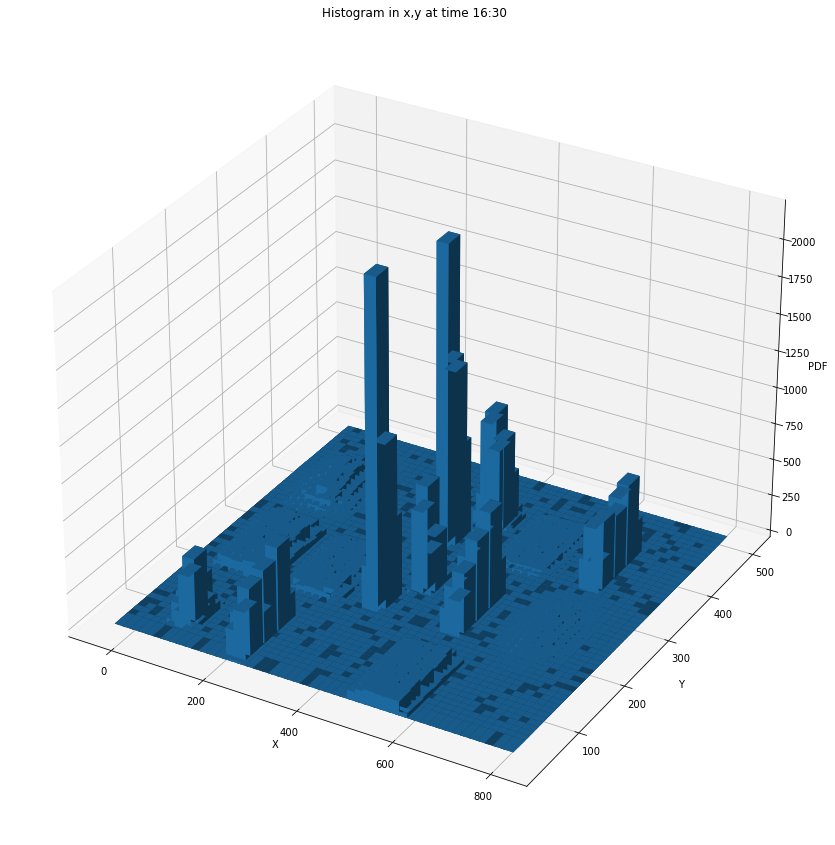

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]


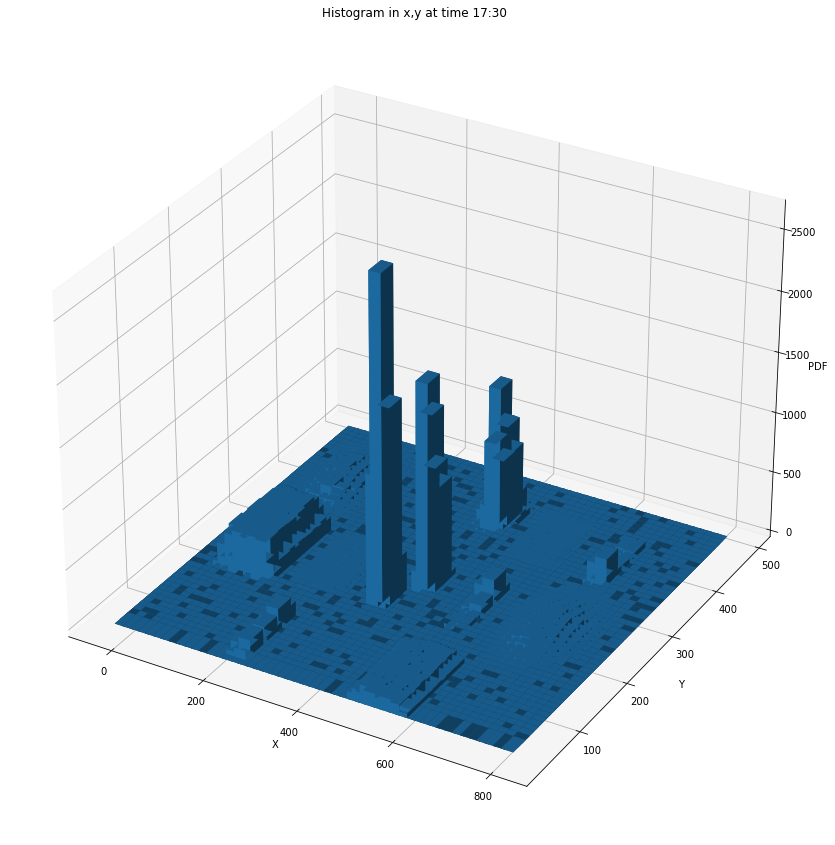

[[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.10357831e-07
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]]


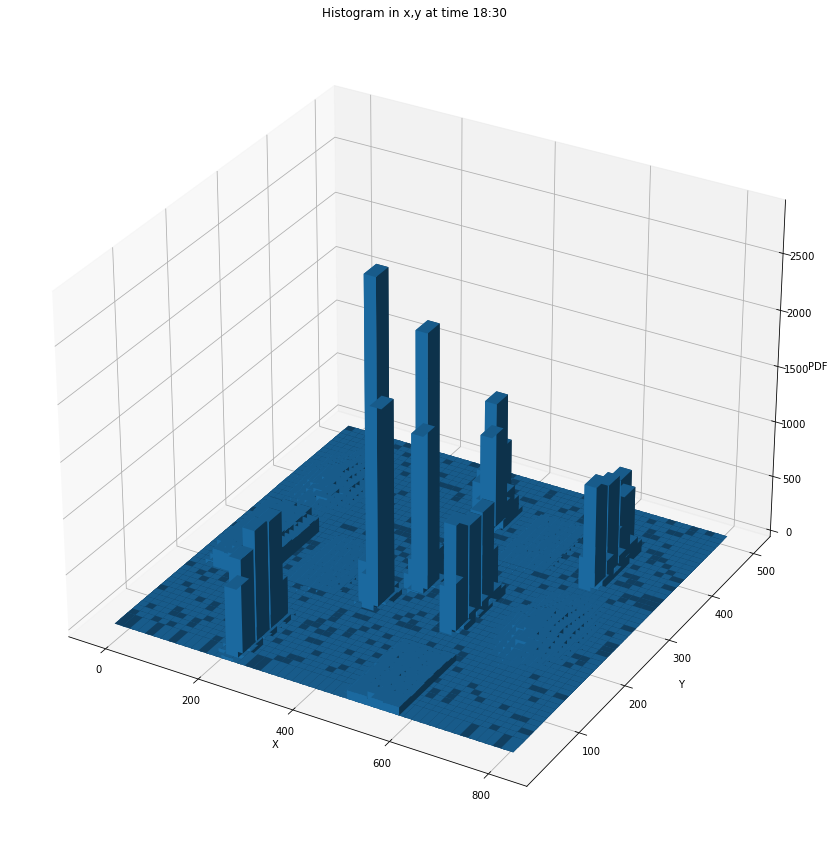

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]


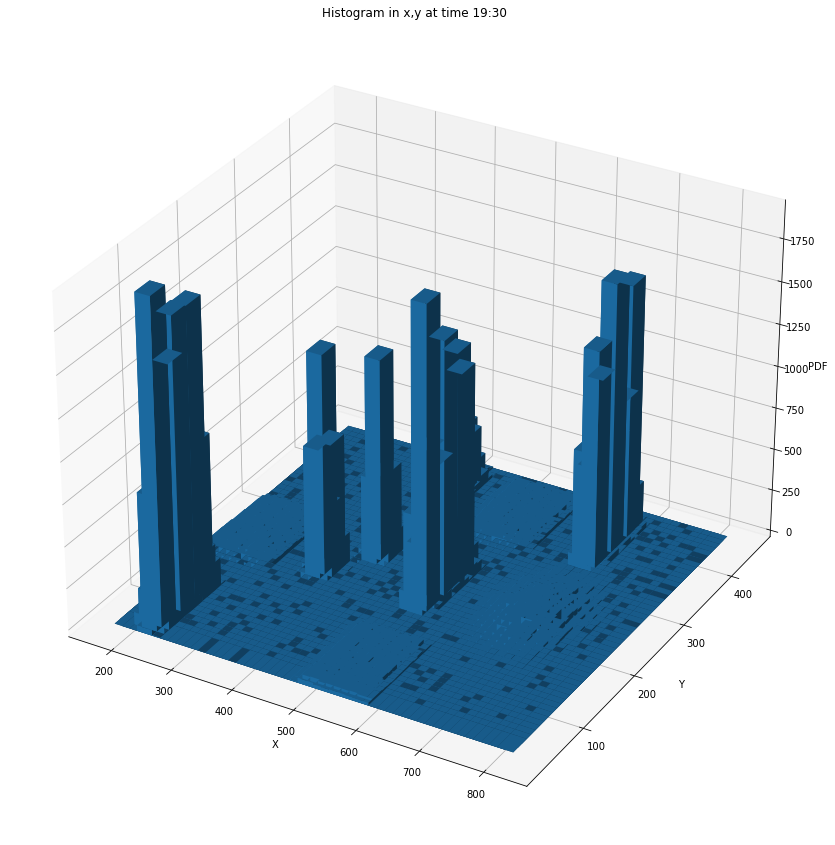

[[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 3.20808384e-07 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 1.18699102e-05 3.11184132e-05 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]]


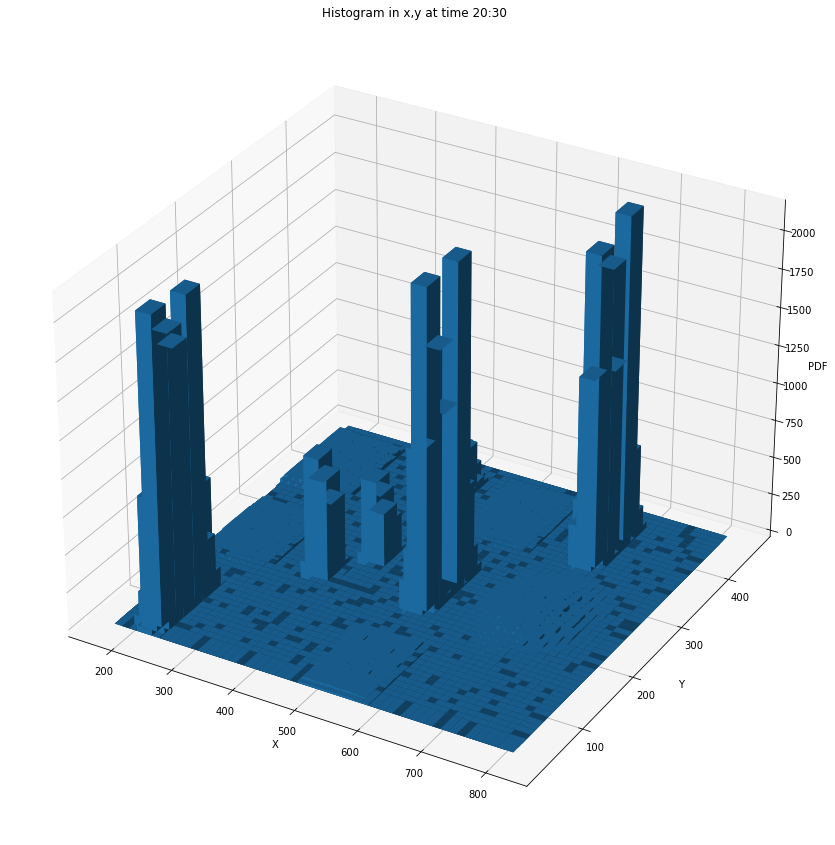

[[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 6.33503390e-06
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 5.38477881e-06
  0.00000000e+00 0.00000000e+00]
 [6.33503390e-07 1.07695576e-05 3.08832902e-05 ... 3.95939619e-06
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]]


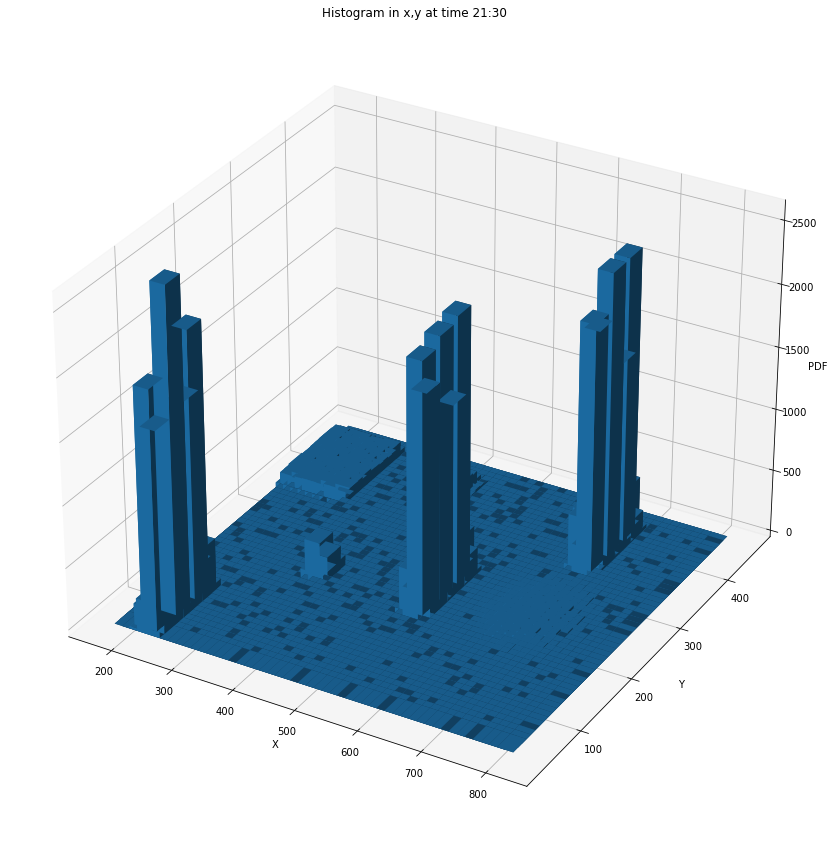

[[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.02047365e-05
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.06830835e-05
  0.00000000e+00 0.00000000e+00]
 [3.18898015e-06 2.72657803e-05 2.24823101e-05 ... 8.29134840e-06
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]]


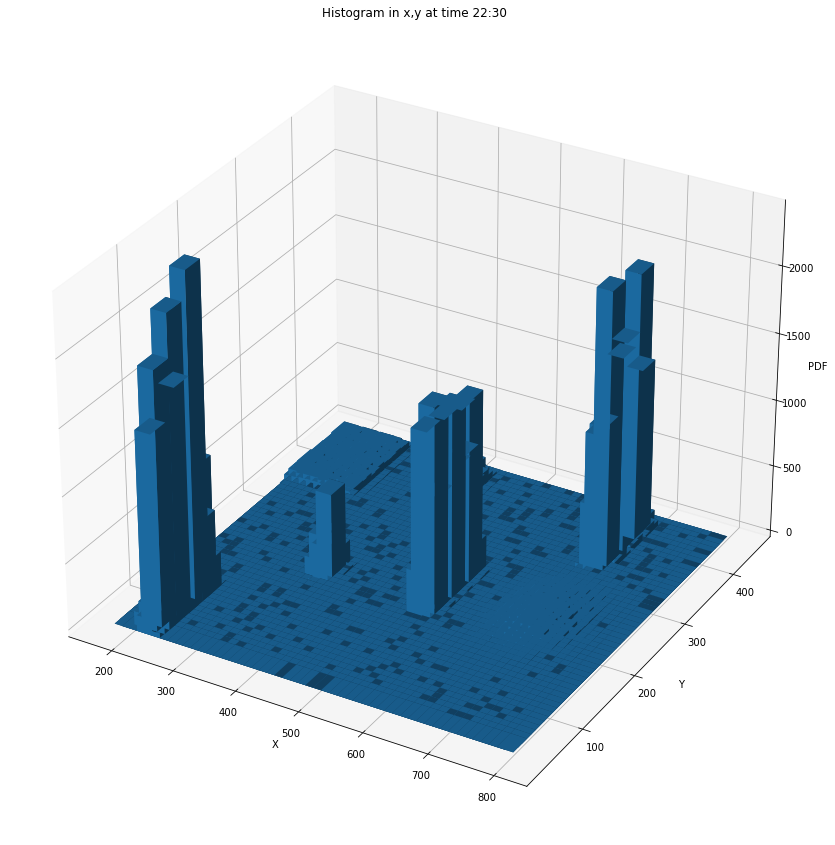

[[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 8.05565364e-06
  1.05730454e-05 3.02087011e-06]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.09086976e-05
  9.56608870e-06 2.85304400e-06]
 [1.00695670e-06 1.67826117e-05 2.45026132e-05 ... 7.72000140e-06
  1.00695670e-05 4.36347905e-06]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]]


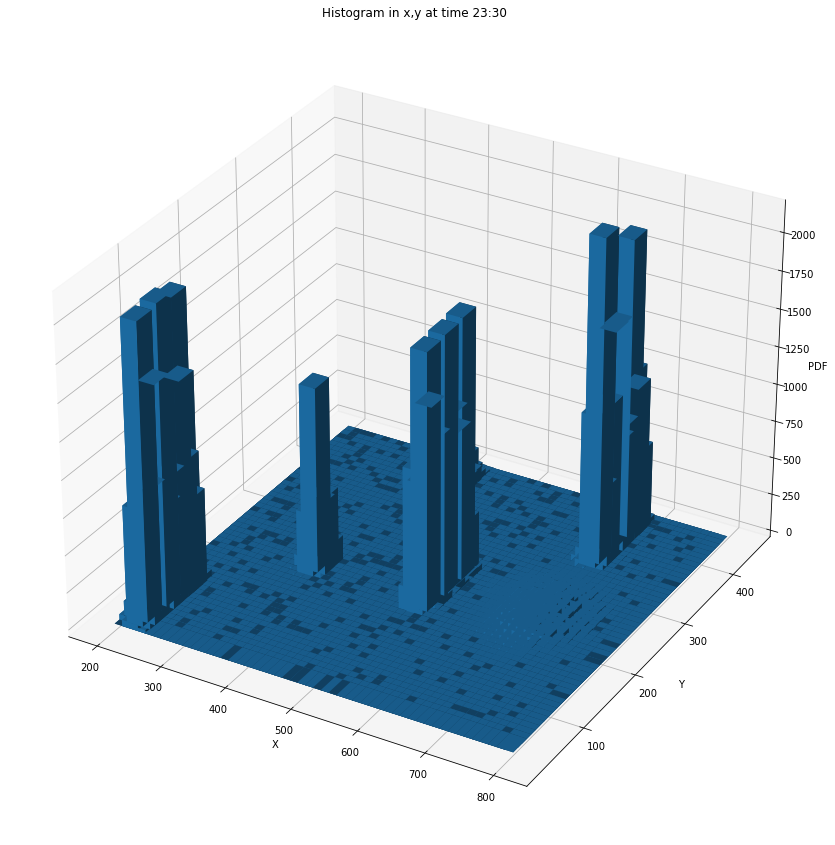

[[0.00000000e+00 6.23435395e-06 1.71444734e-05 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [7.10023644e-06 1.35597198e-04 3.42889467e-04 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [3.80988297e-06 5.64555385e-05 1.55685672e-04 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]]


In [58]:
arr = []
for i in range(0, 24):
    fig = plt.figure(figsize=(15, 15))
    ax = fig.add_subplot(projection='3d')
    hist, xedges, yedges = np.histogram2d(df['X'][(df["hour"]==i) & (df["min"]==30)], df['Y'][(df["hour"]==i) & (df["min"]==30)], bins=50)
# Construct arrays for the anchor positions of the 16 bars.
    xpos, ypos = np.meshgrid(xedges[:-1] + 25, yedges[:-1] + 25, indexing="ij")
    xpos = xpos.ravel()
    ypos = ypos.ravel()
    zpos = 0

# Construct arrays with the dimensions for the 16 bars.
    dx = dy = 25 * np.ones_like(zpos)
    dz = hist.ravel()
    arr.append(hist)
    ax.bar3d(xpos, ypos, zpos, dx, dy, dz, zsort='average')
    ax.set_title('Histogram in x,y at time {}:30'.format(i))
    ax.set_xlabel('X')
    ax.set_ylabel('Y')
    ax.set_zlabel('PDF')
    plt.show()
    hist_prob = hist/len(df['X'][(df["hour"]==i) & (df["min"]==30)])
    hist_pdf = hist_prob/((xedges[1]-xedges[0])*(yedges[1]-yedges[0]))
    print(hist_pdf)

In [59]:
df = pd.DataFrame(pd.read_csv("thursday.csv"))

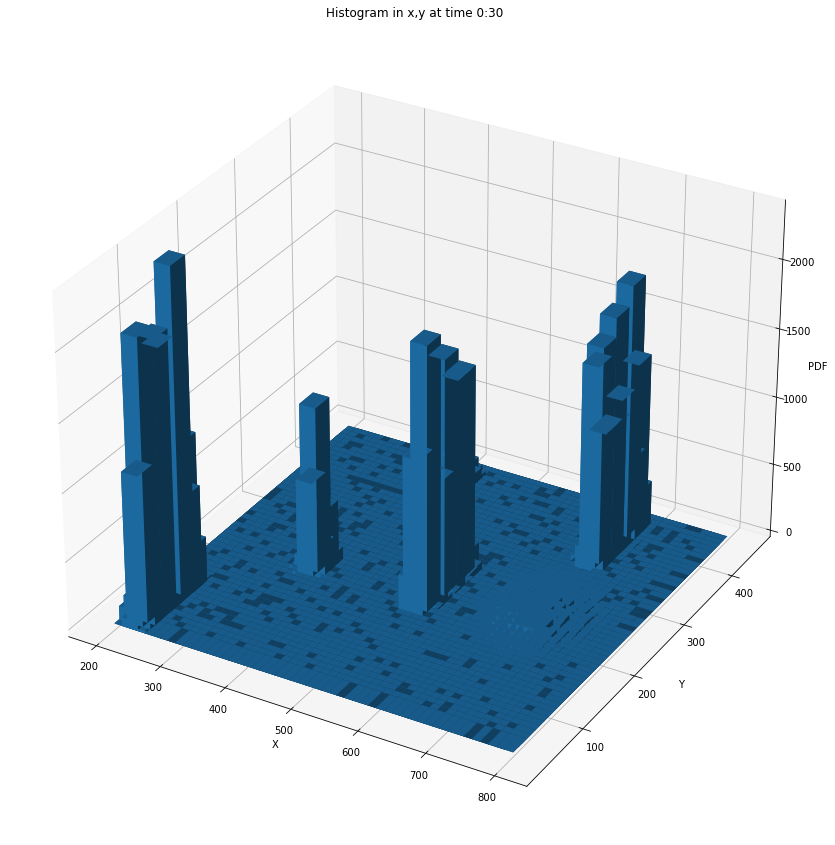

[[6.93192319e-07 1.73298080e-05 2.61680100e-05 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [1.10910771e-05 1.90801186e-04 3.56300852e-04 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [3.11936543e-06 6.36003952e-05 1.03805550e-04 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]]


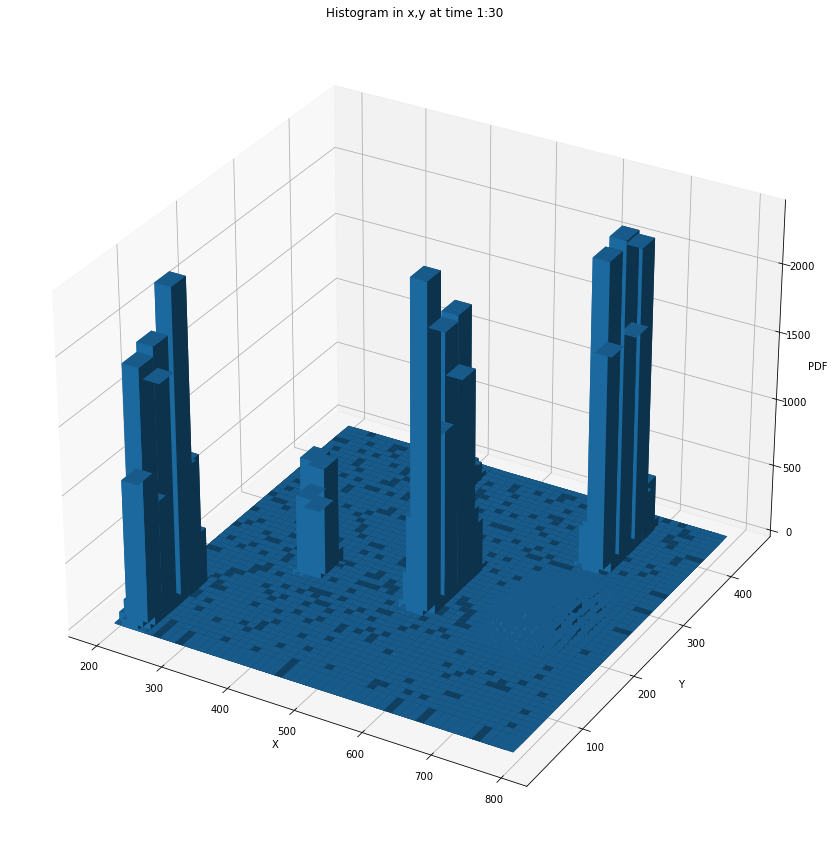

[[1.22548923e-06 1.01540536e-05 2.13585265e-05 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [9.97898371e-06 1.85048873e-04 3.28080973e-04 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [2.45097846e-06 7.31792139e-05 1.54236573e-04 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]]


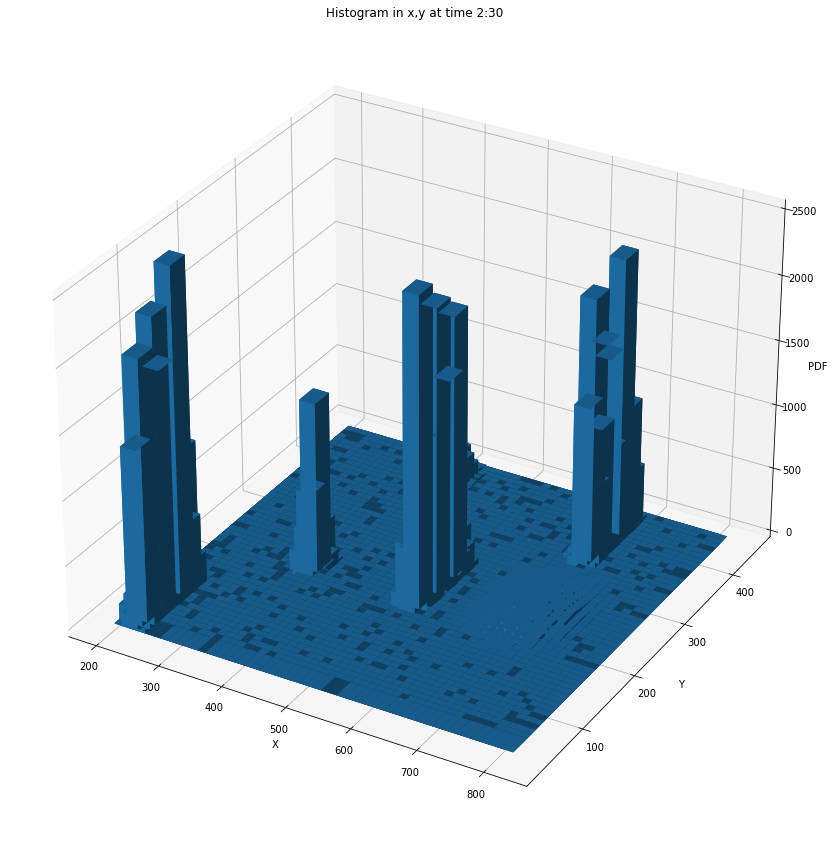

[[8.50256859e-07 2.14264729e-05 2.94188873e-05 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [1.83655482e-05 2.31269866e-04 3.43503771e-04 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [3.23097607e-06 5.59469013e-05 7.99241448e-05 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]]


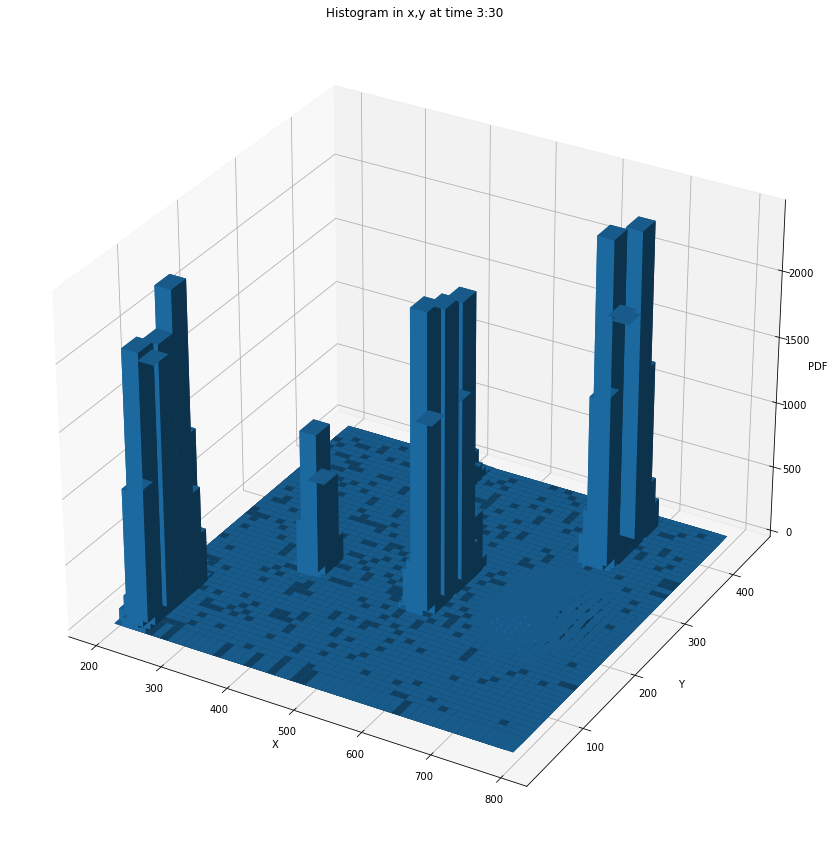

[[8.86365122e-07 1.52454801e-05 2.74773188e-05 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [1.18772926e-05 1.80818485e-04 3.60396059e-04 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [5.67273678e-06 5.92091902e-05 1.15050193e-04 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]]


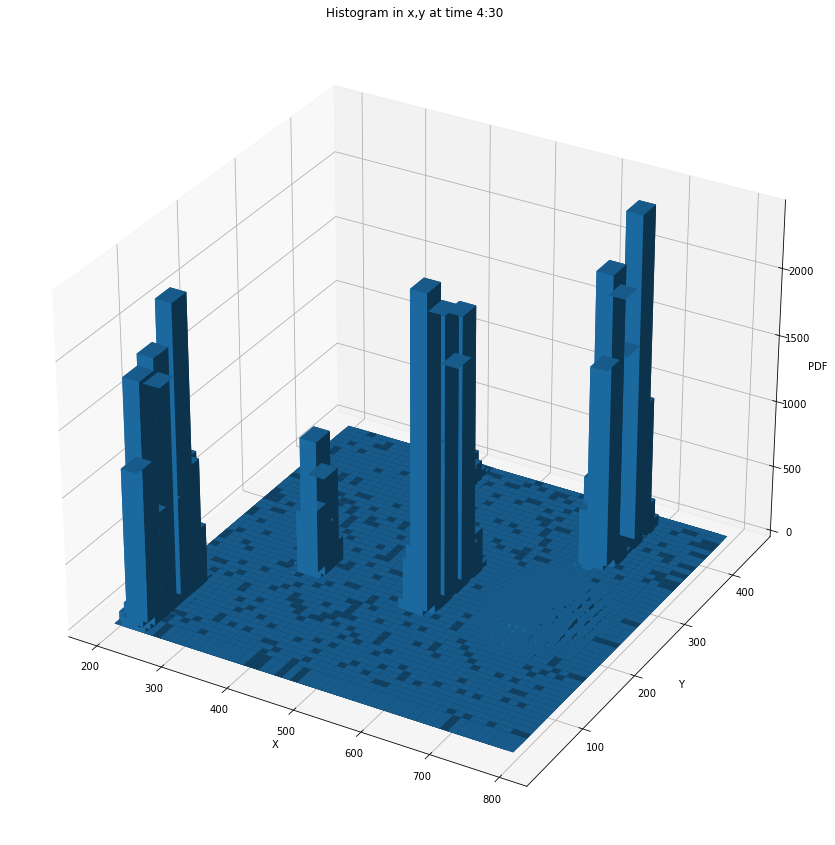

[[5.28465223e-07 1.10977697e-05 1.76155074e-05 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [1.33877856e-05 2.04516041e-04 3.17959909e-04 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [6.34158267e-06 8.52590559e-05 1.42685610e-04 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]]


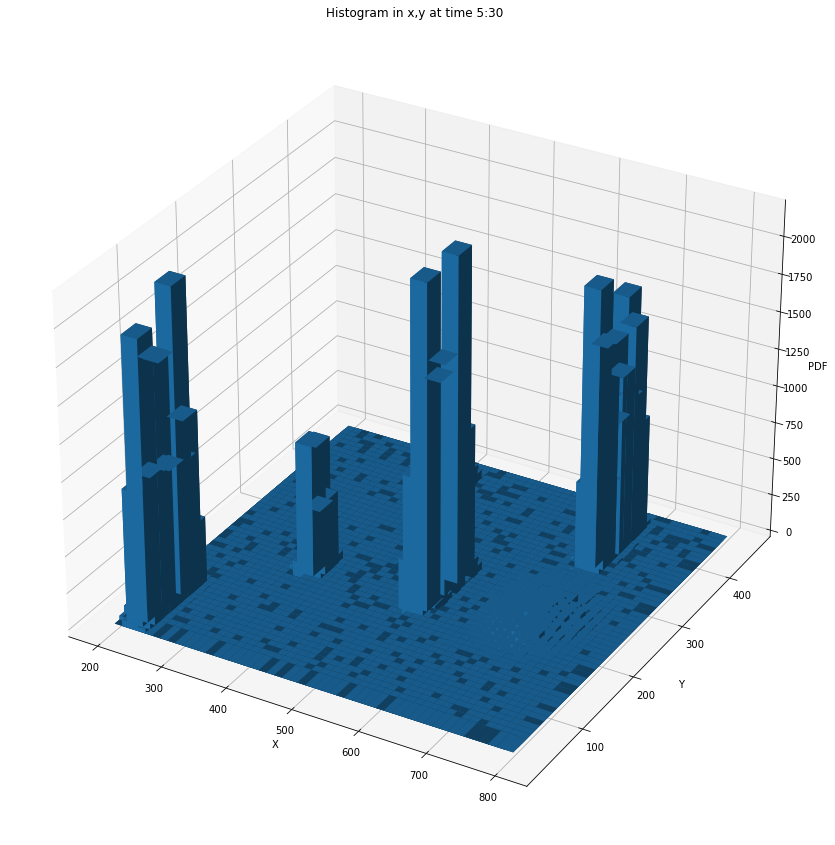

[[0.00000000e+00 4.42561231e-06 1.15746783e-05 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [6.97885018e-06 1.53875136e-04 3.21707972e-04 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [4.93625988e-06 7.69375678e-05 1.69534995e-04 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]]


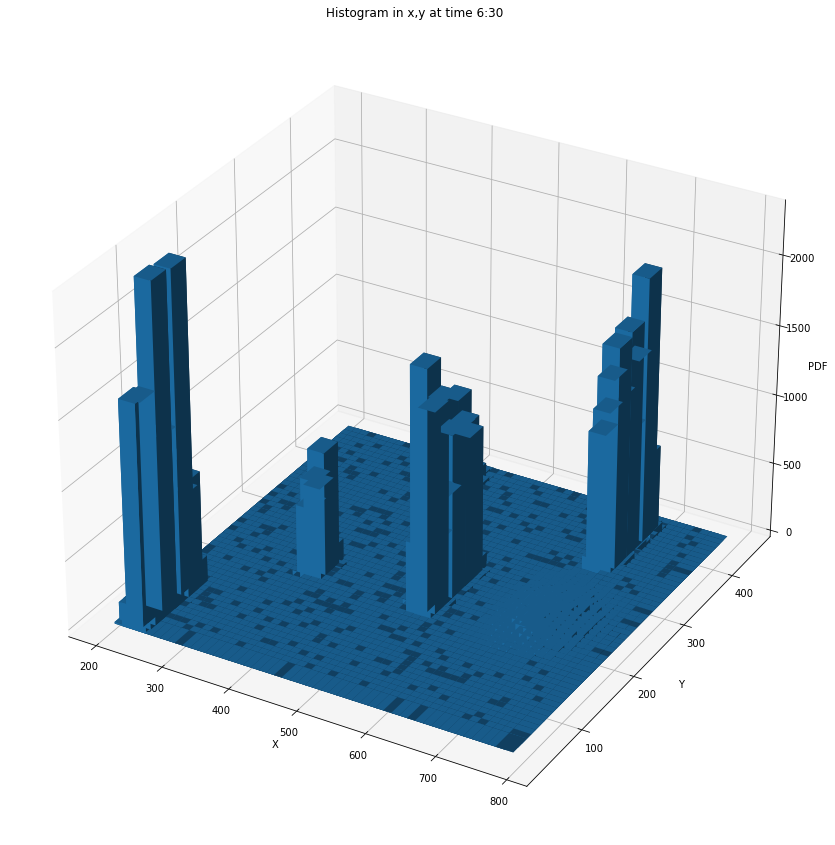

[[2.16212858e-06 2.30627049e-05 2.32428823e-05 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [3.11706871e-05 2.87743279e-04 2.84139731e-04 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [1.17115298e-05 9.94579148e-05 1.06304655e-04 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]]


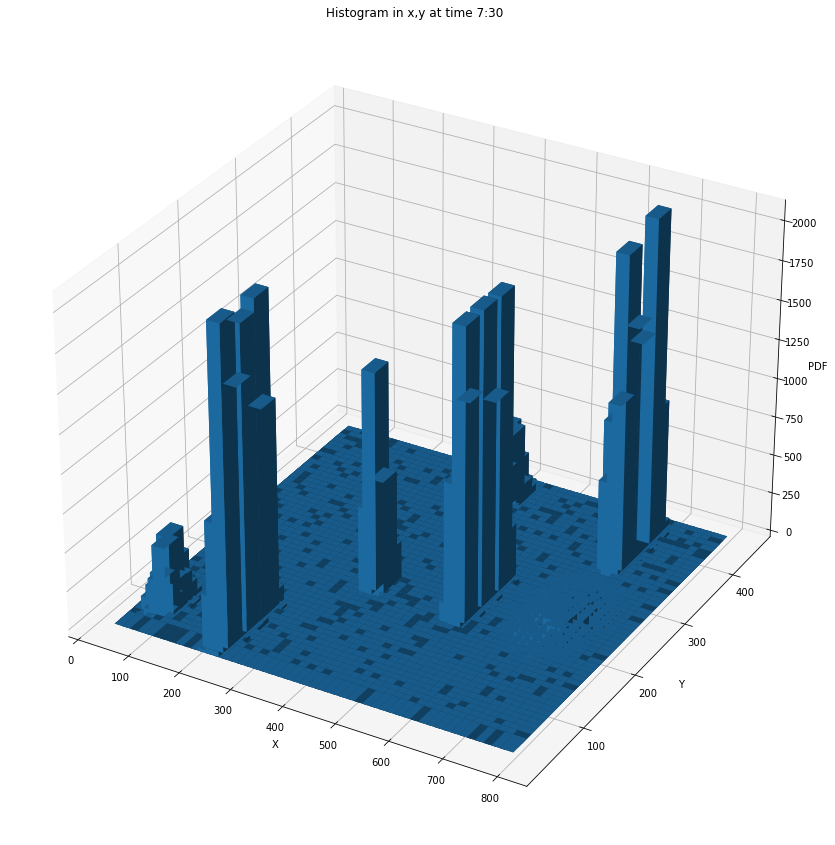

[[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 4.08576693e-07 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 1.77049900e-06 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]]


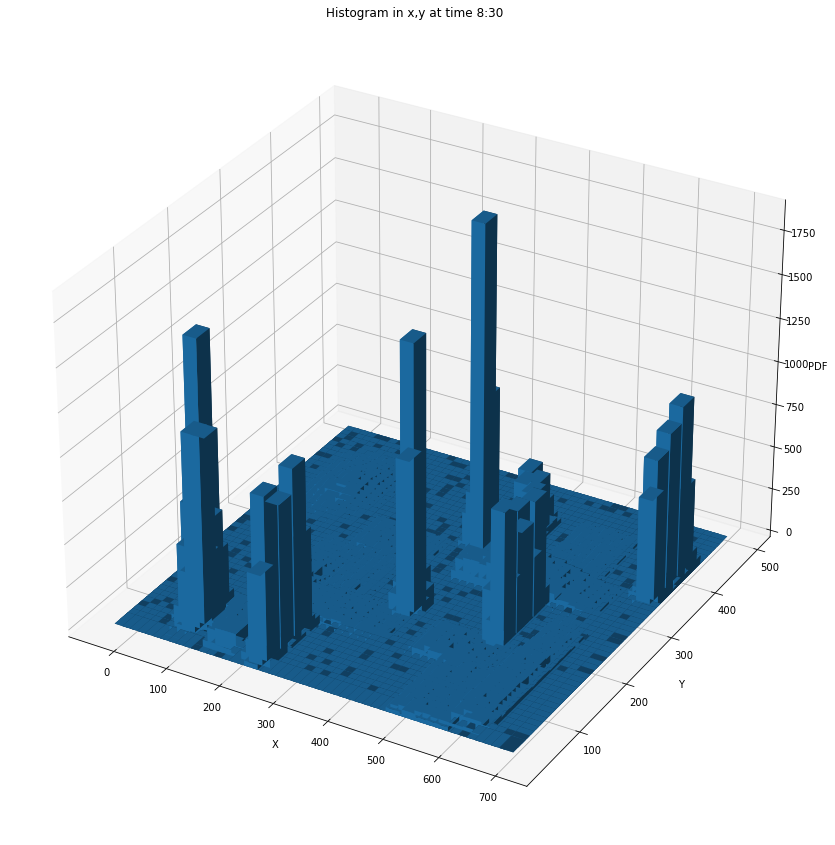

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]


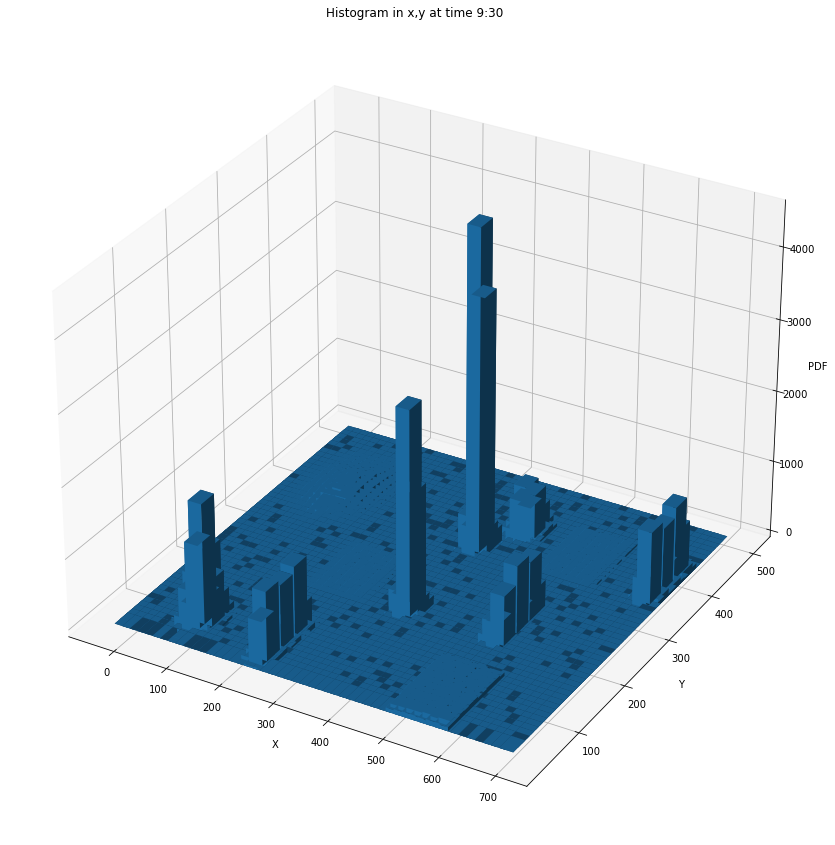

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]


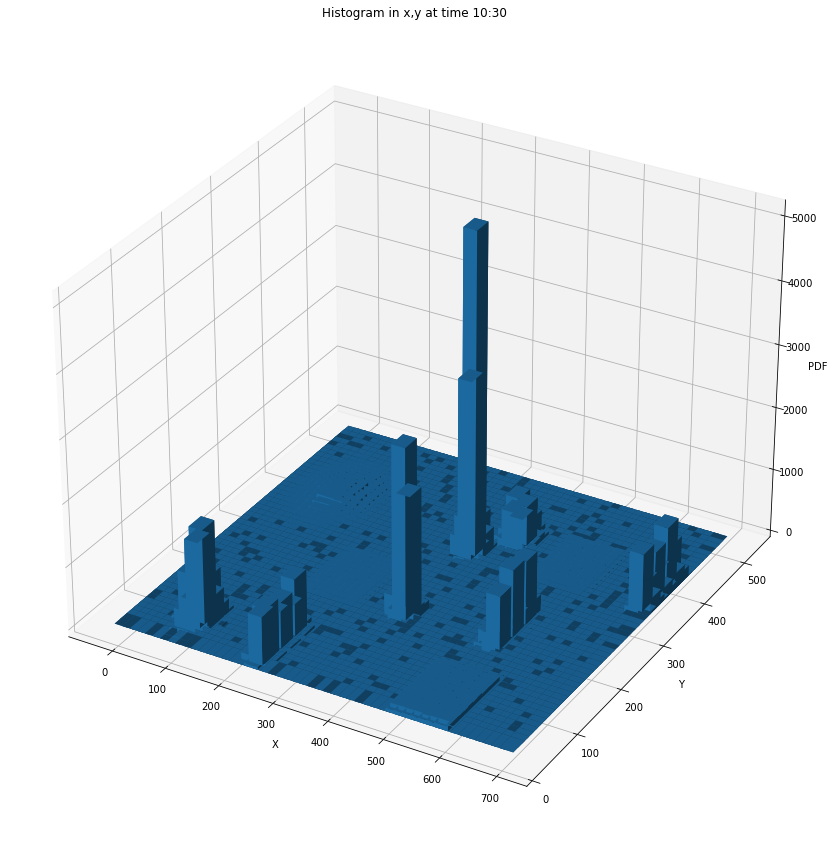

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]


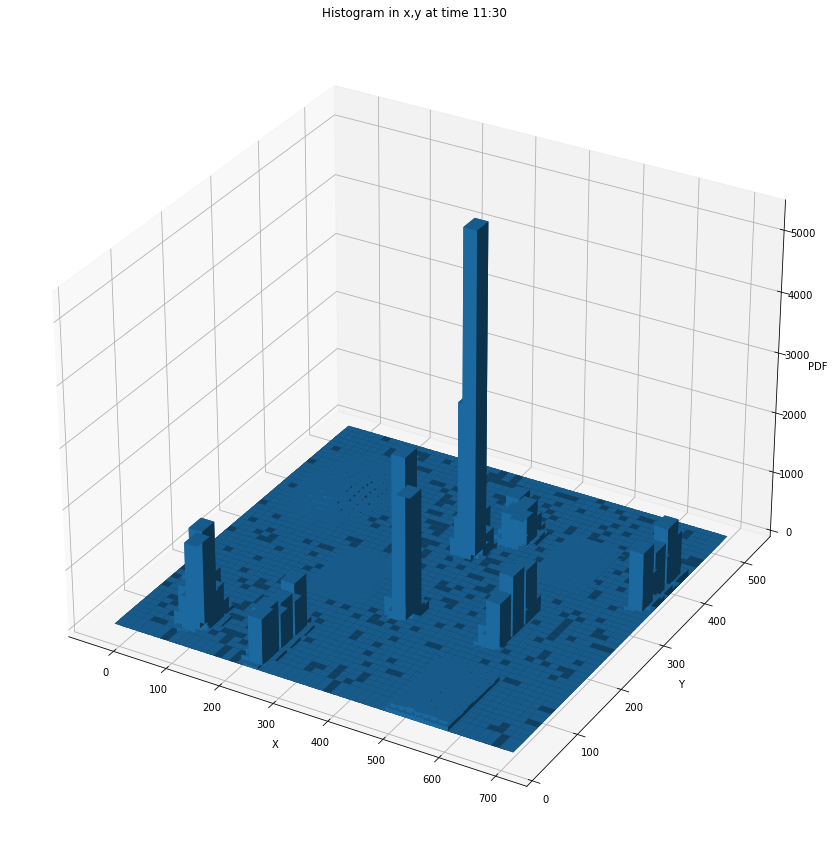

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]


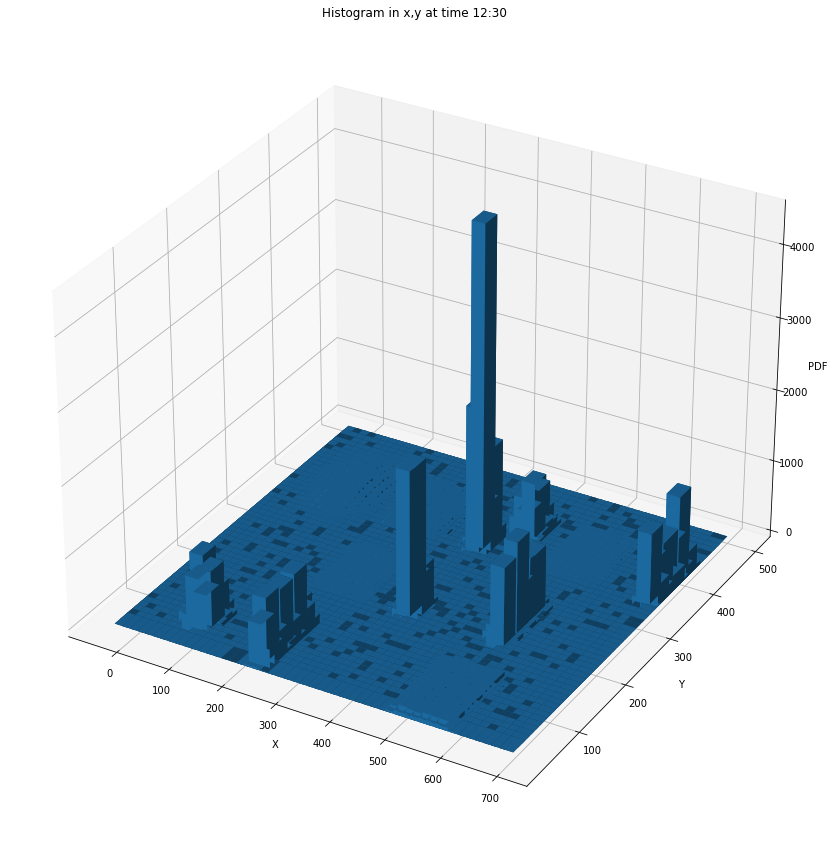

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]


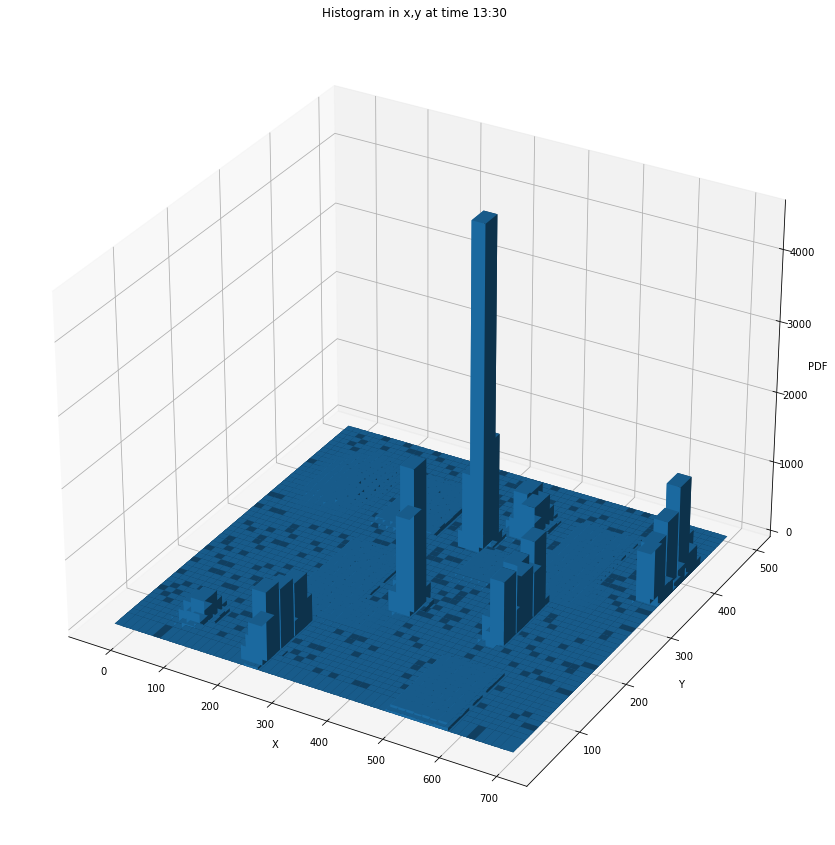

[[0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  1.2745515e-07 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 1.2745515e-07
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]


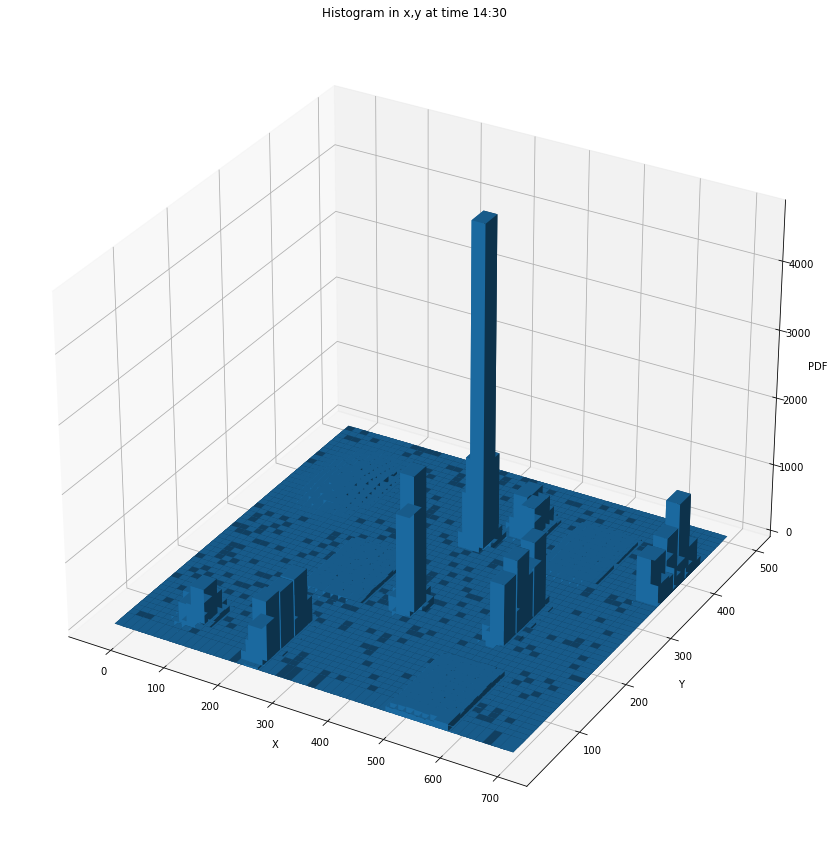

[[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  1.27461199e-07 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]]


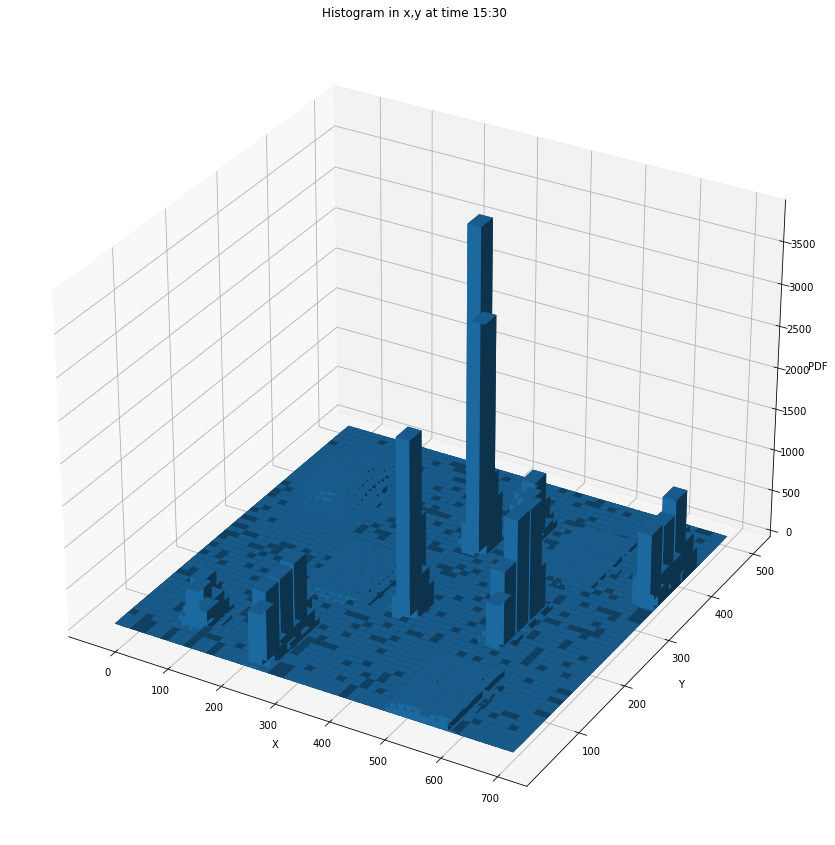

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]


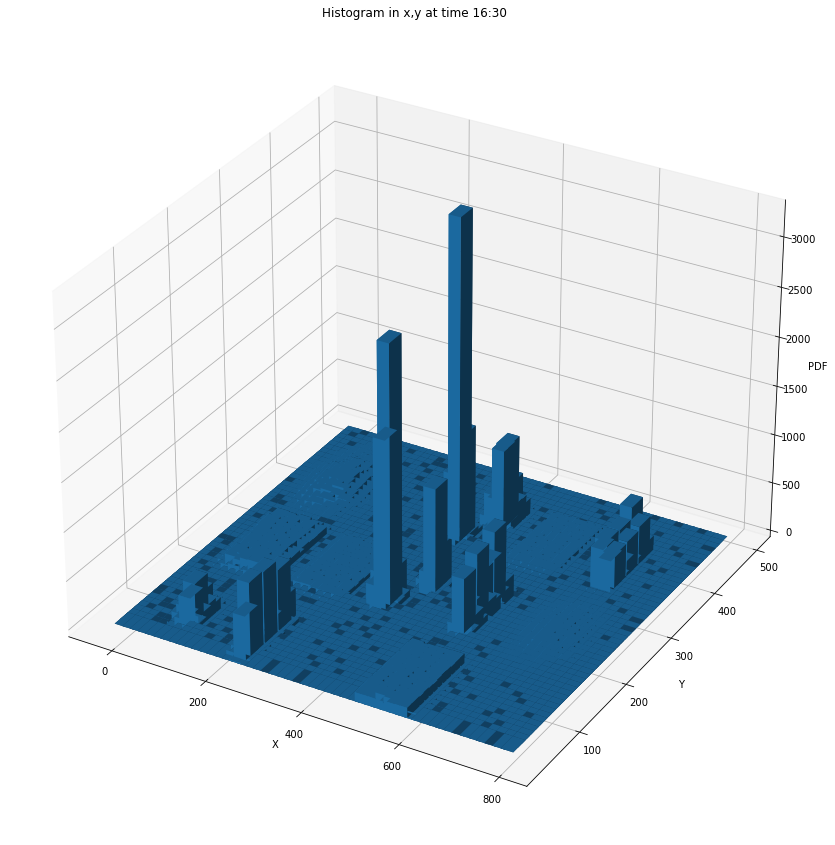

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]


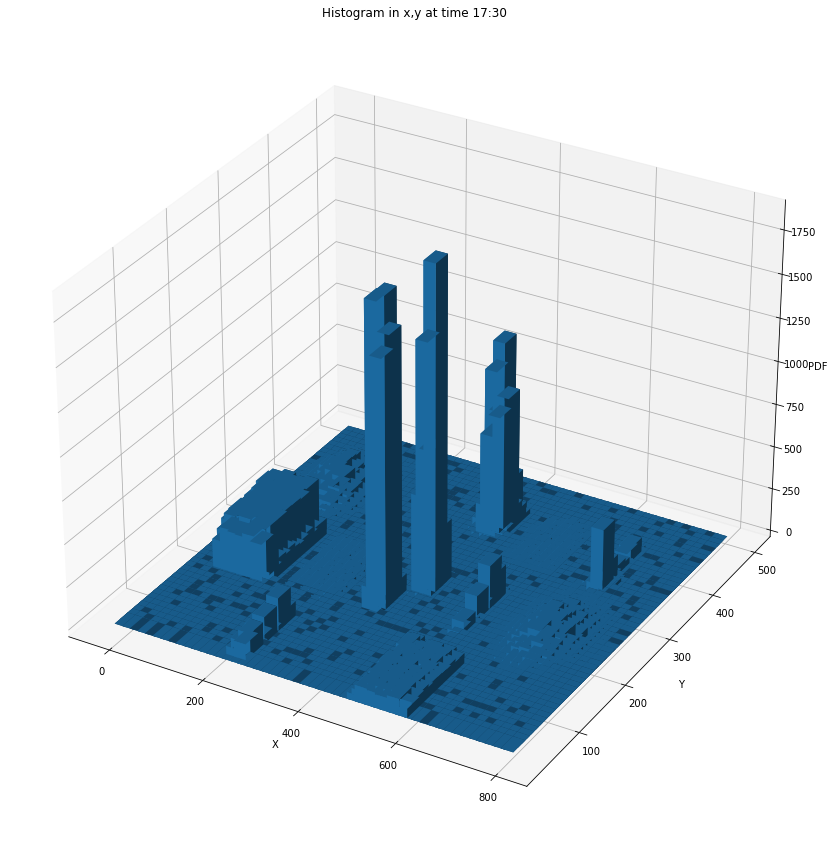

[[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.09812744e-07
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]]


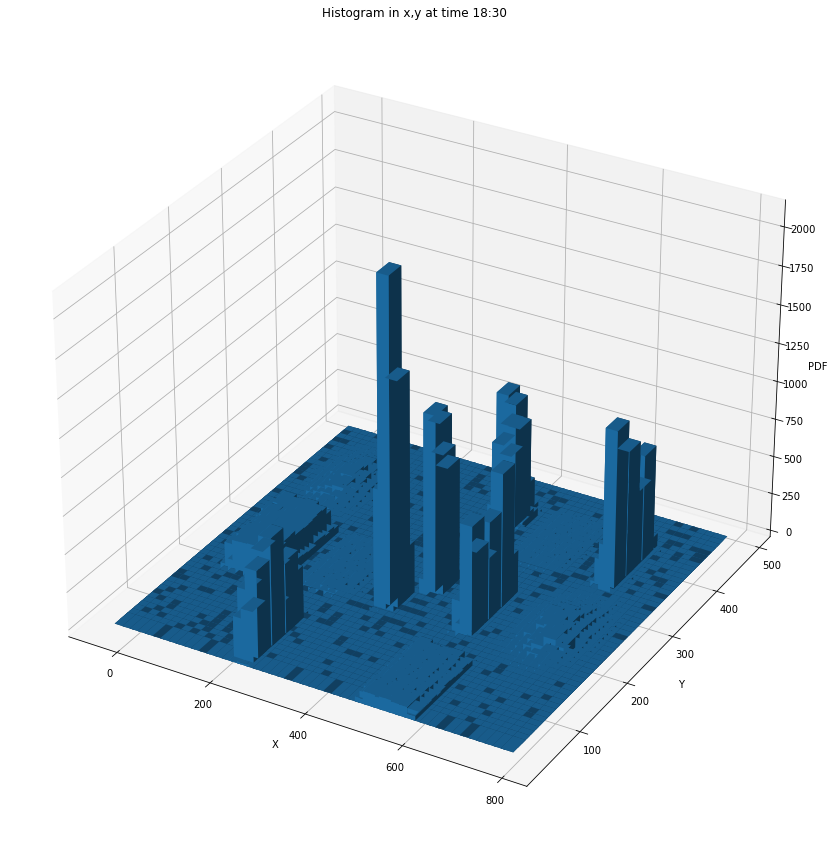

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]


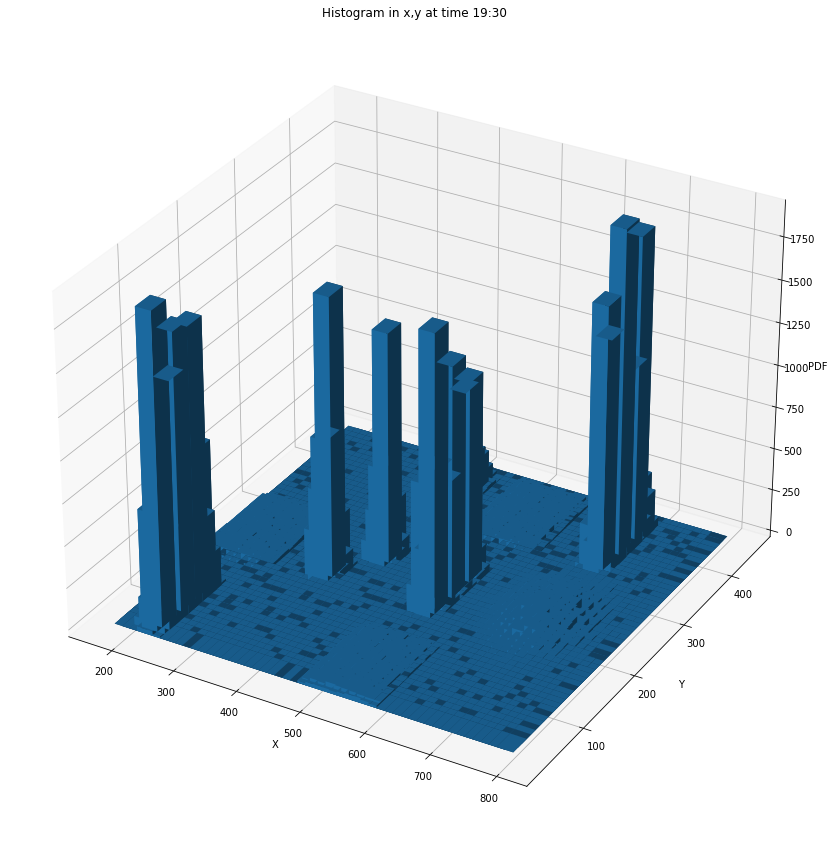

[[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [3.31772388e-07 8.46019589e-06 2.33899533e-05 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]]


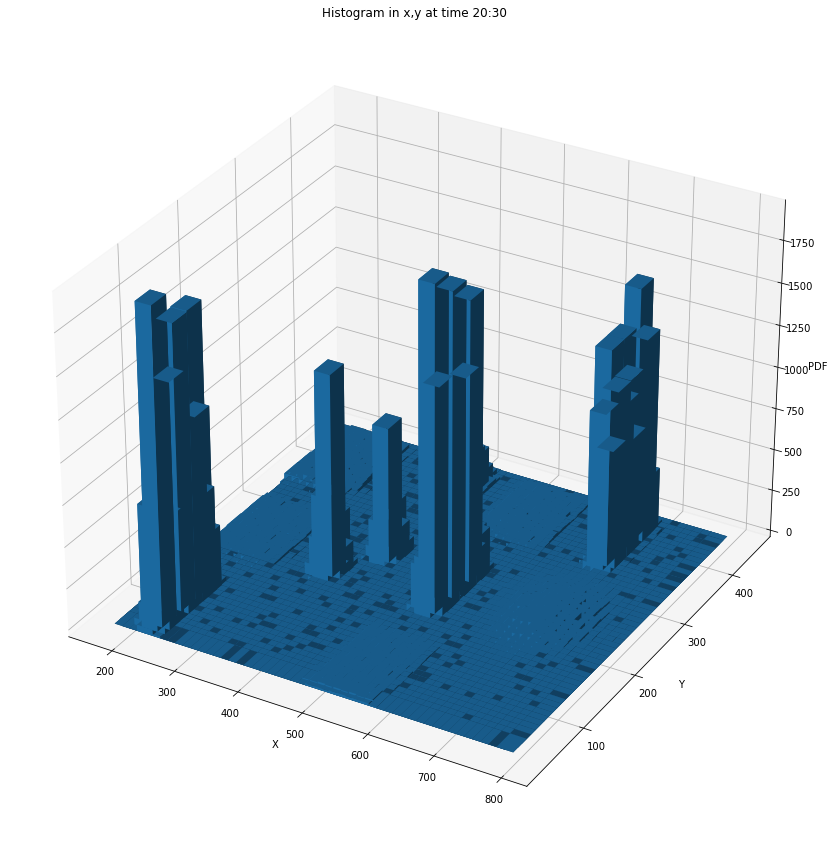

[[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 4.55743517e-06
  5.40140465e-06 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 4.55743517e-06
  6.75175581e-06 0.00000000e+00]
 [3.37587791e-07 6.92054971e-06 1.90737102e-05 ... 5.73899244e-06
  5.40140465e-06 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]]


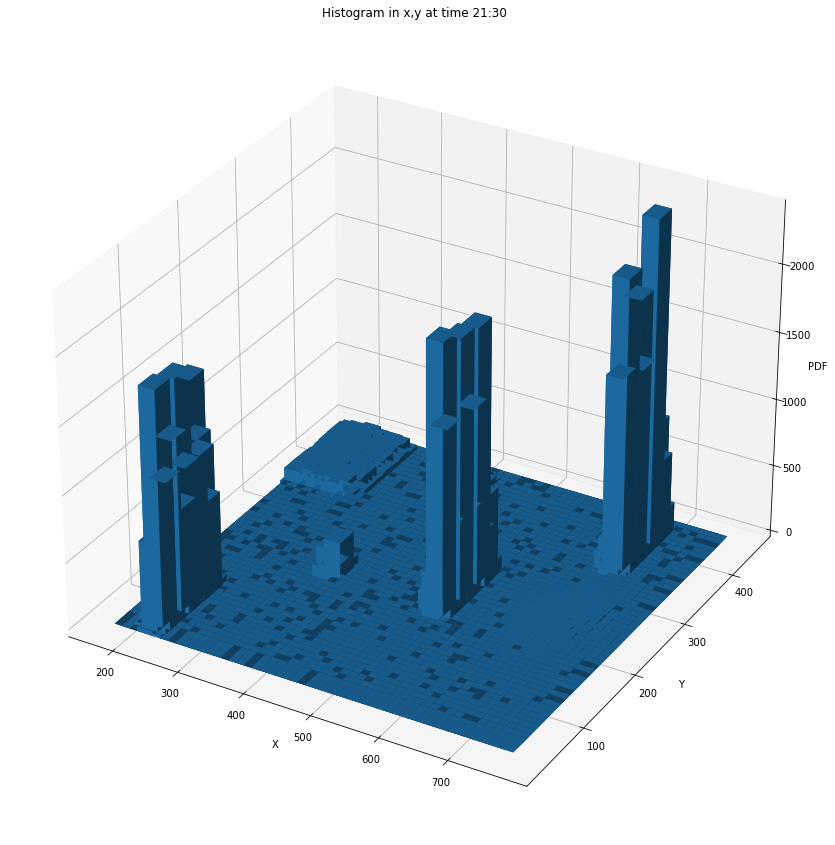

[[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.66912915e-05
  1.37044288e-05 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.61641980e-05
  1.58128024e-05 0.00000000e+00]
 [0.00000000e+00 4.56814293e-06 1.22988463e-05 ... 1.47586156e-05
  1.56371046e-05 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]]


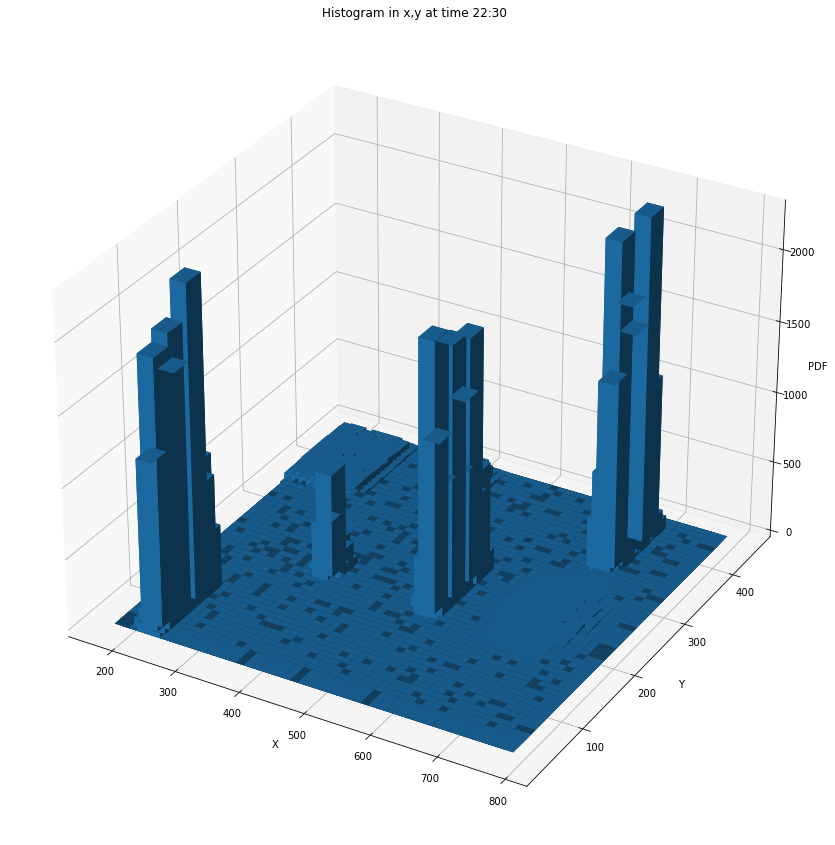

[[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 9.96783323e-06
  9.10853726e-06 1.03115516e-06]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 9.96783323e-06
  1.03115516e-05 1.03115516e-06]
 [1.03115516e-06 9.10853726e-06 1.54673274e-05 ... 9.79597404e-06
  7.04622694e-06 8.59295968e-07]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]]


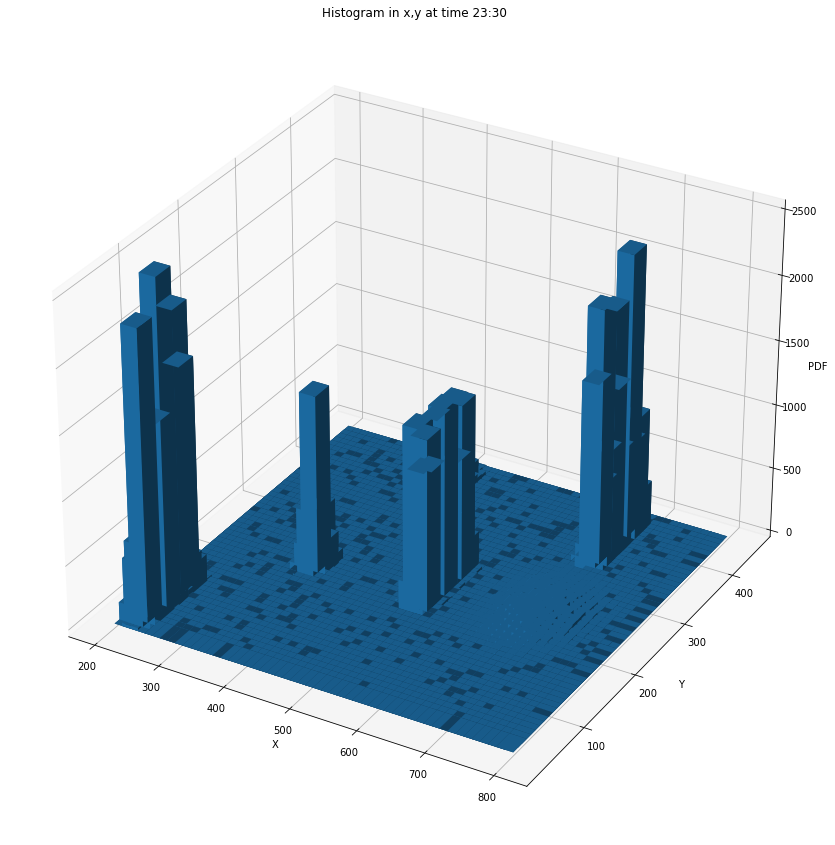

[[1.73095952e-07 2.35410494e-05 7.82393702e-05 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [3.98120689e-06 1.10262121e-04 3.89292795e-04 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [5.19287855e-07 1.45400599e-05 5.38328410e-05 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]]


In [60]:
arr = []
for i in range(0, 24):
    fig = plt.figure(figsize=(15, 15))
    ax = fig.add_subplot(projection='3d')
    hist, xedges, yedges = np.histogram2d(df['X'][(df["hour"]==i) & (df["min"]==30)], df['Y'][(df["hour"]==i) & (df["min"]==30)], bins=50)
# Construct arrays for the anchor positions of the 16 bars.
    xpos, ypos = np.meshgrid(xedges[:-1] + 25, yedges[:-1] + 25, indexing="ij")
    xpos = xpos.ravel()
    ypos = ypos.ravel()
    zpos = 0

# Construct arrays with the dimensions for the 16 bars.
    dx = dy = 25 * np.ones_like(zpos)
    dz = hist.ravel()
    arr.append(hist)
    ax.bar3d(xpos, ypos, zpos, dx, dy, dz, zsort='average')
    ax.set_title('Histogram in x,y at time {}:30'.format(i))
    ax.set_xlabel('X')
    ax.set_ylabel('Y')
    ax.set_zlabel('PDF')
    plt.show()
    hist_prob = hist/len(df['X'][(df["hour"]==i) & (df["min"]==30)])
    hist_pdf = hist_prob/((xedges[1]-xedges[0])*(yedges[1]-yedges[0]))
    print(hist_pdf)

In [61]:
df = pd.DataFrame(pd.read_csv("friday.csv"))

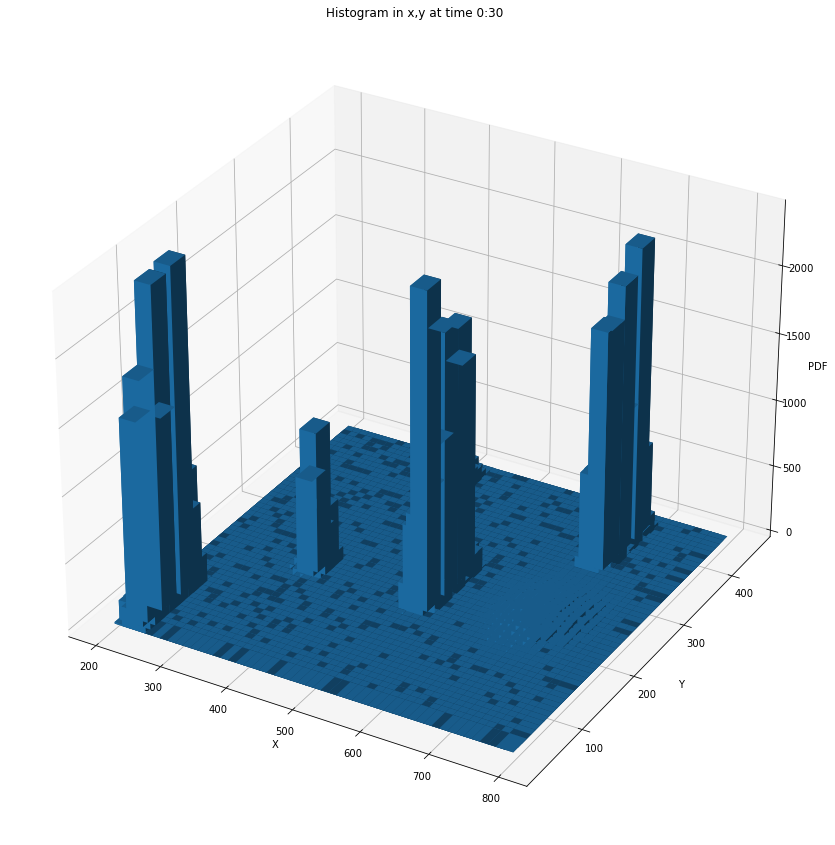

[[2.11267974e-06 2.58803268e-05 2.69366666e-05 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [2.60563834e-05 2.68134270e-04 3.15845620e-04 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [8.62677559e-06 7.16550544e-05 8.92607188e-05 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]]


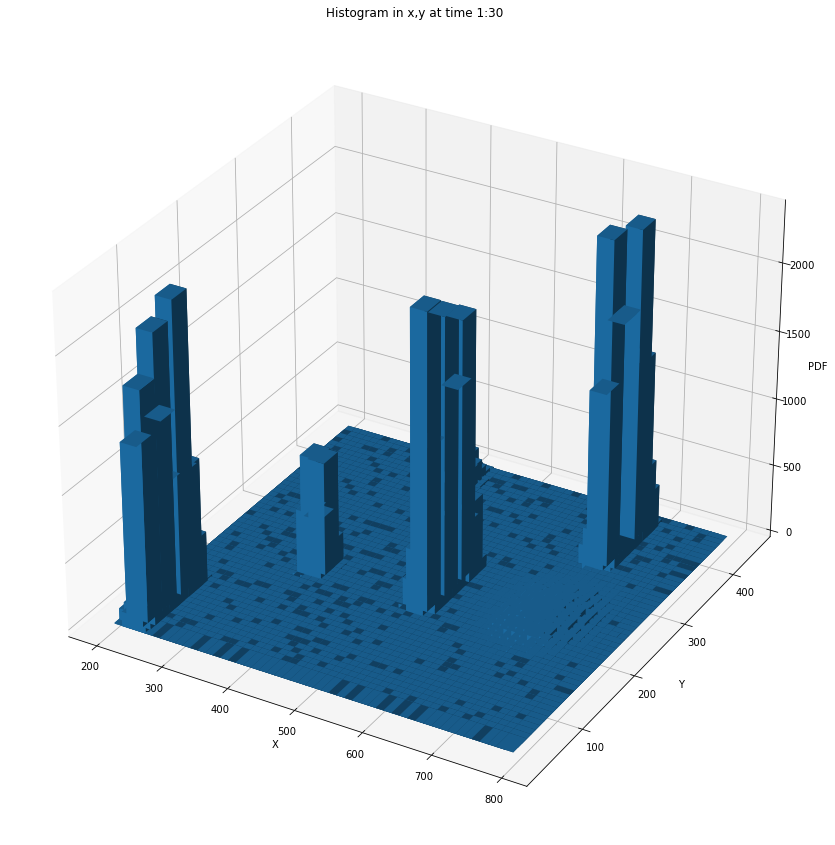

[[1.24771608e-06 1.49725930e-05 1.78245154e-05 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [1.90722315e-05 2.37244301e-04 3.04799214e-04 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [1.05164641e-05 1.03916925e-04 1.30653698e-04 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]]


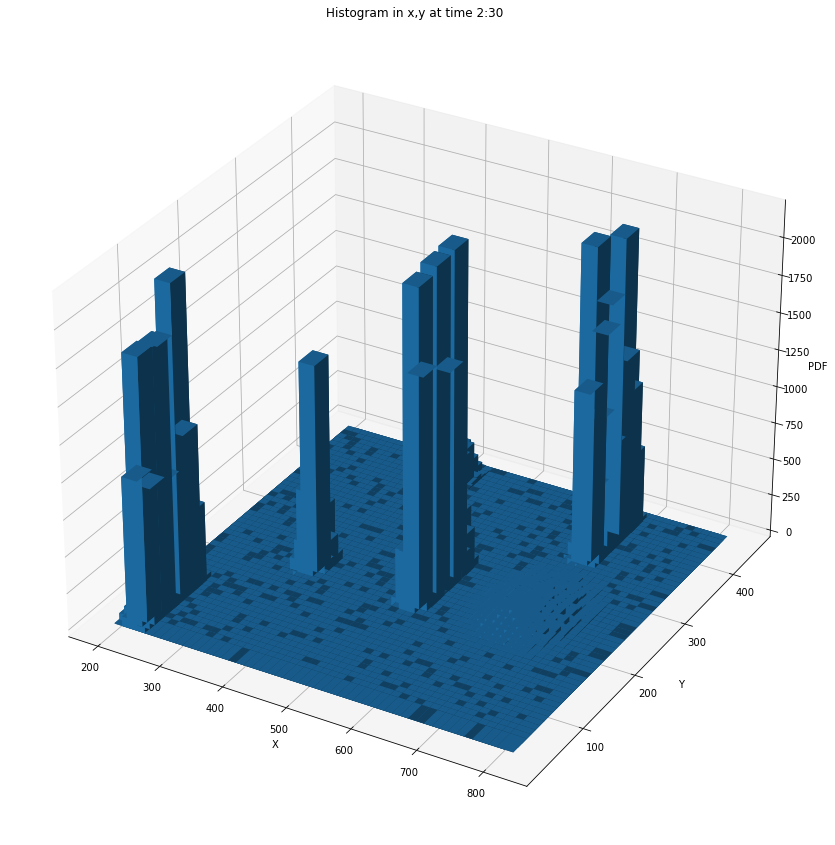

[[6.76172299e-07 7.43789528e-06 1.06497137e-05 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [1.09877999e-05 1.67014558e-04 3.01234759e-04 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [6.59267991e-06 8.92547434e-05 1.56533887e-04 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]]


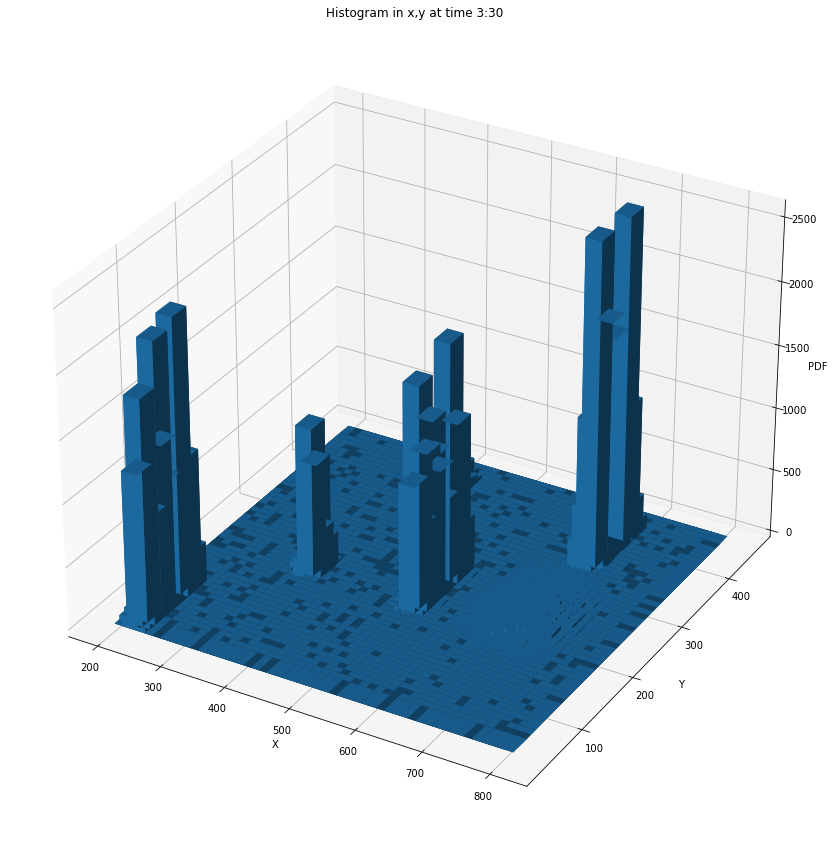

[[3.36000192e-07 6.04800346e-06 1.07520062e-05 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [1.49520086e-05 2.02104116e-04 2.96184170e-04 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [5.88000337e-06 9.96240571e-05 1.44480083e-04 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]]


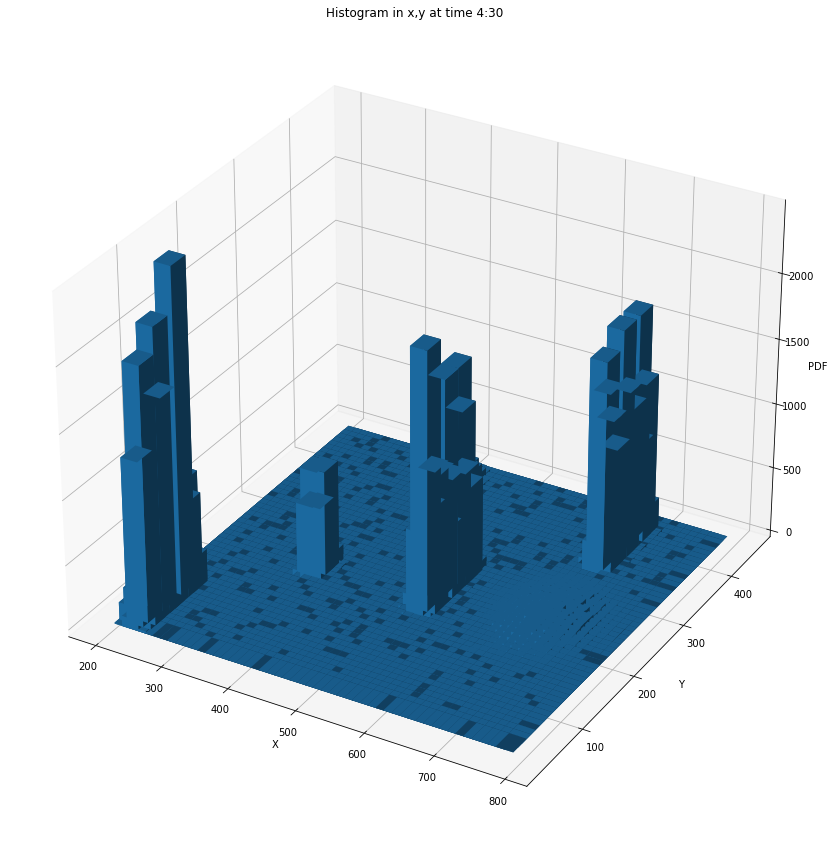

[[1.42280242e-06 2.40097908e-05 3.91270664e-05 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [1.40501739e-05 2.25692033e-04 3.48408741e-04 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [3.02345513e-06 6.52710608e-05 9.78176660e-05 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]]


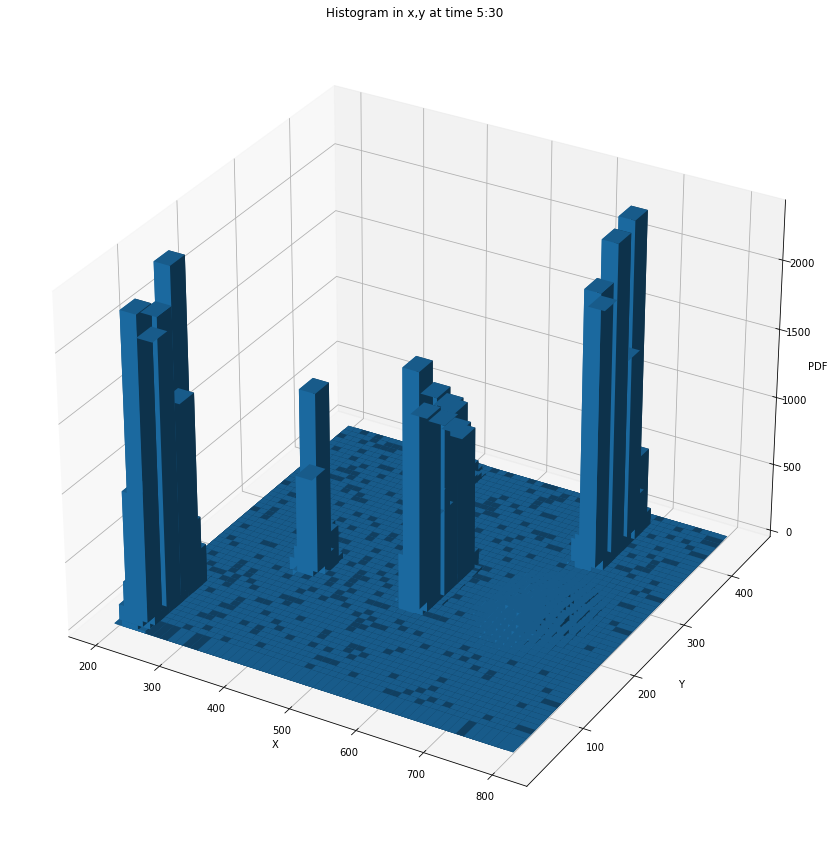

[[8.59130968e-07 1.94163599e-05 4.31283746e-05 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [7.56035252e-06 1.65468624e-04 3.81625976e-04 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [2.74921910e-06 3.86608936e-05 8.24765730e-05 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]]


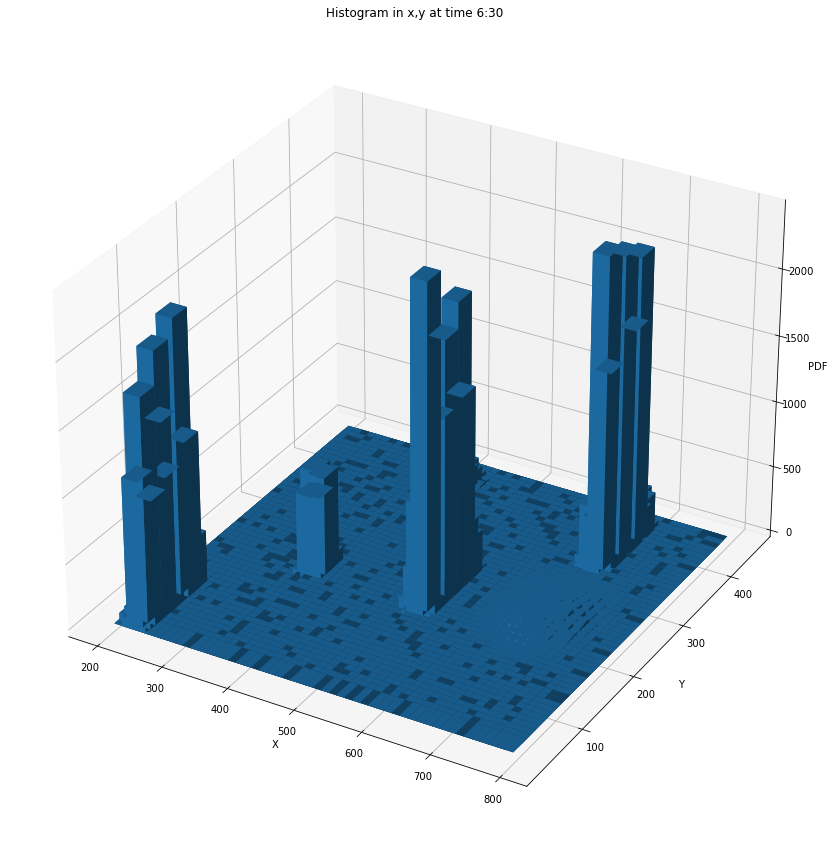

[[8.72497769e-07 8.89947724e-06 1.20404692e-05 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [1.30874665e-05 1.91600510e-04 2.96125743e-04 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [7.32898126e-06 1.09062221e-04 1.64553079e-04 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]]


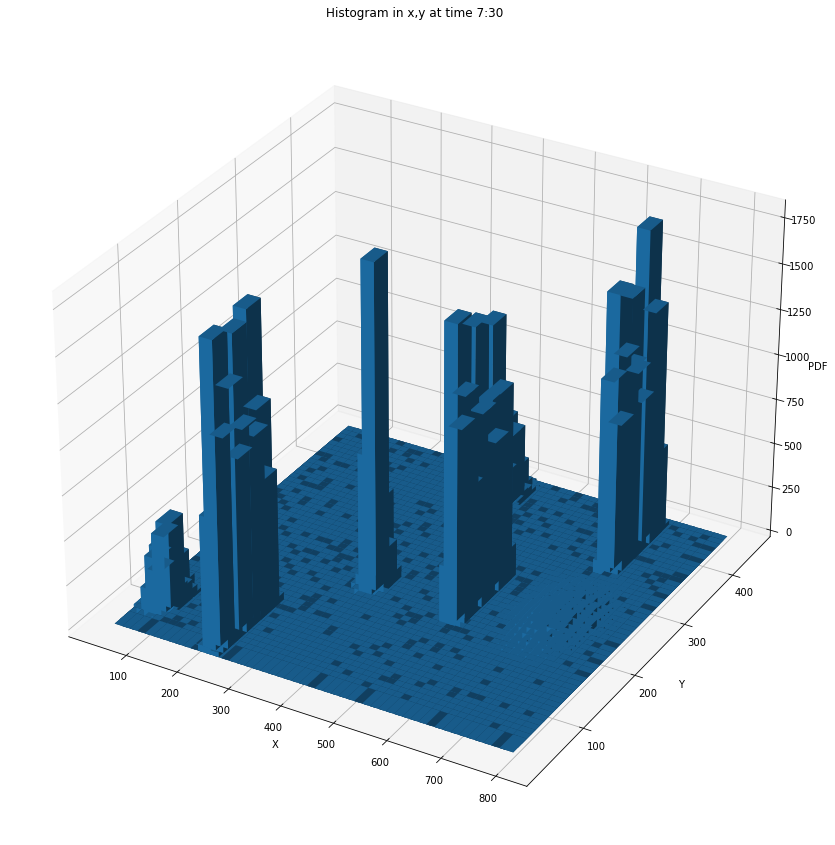

[[0.00000000e+00 0.00000000e+00 1.36328035e-07 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 5.45312141e-07 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 1.36328035e-07 6.81640176e-07 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]]


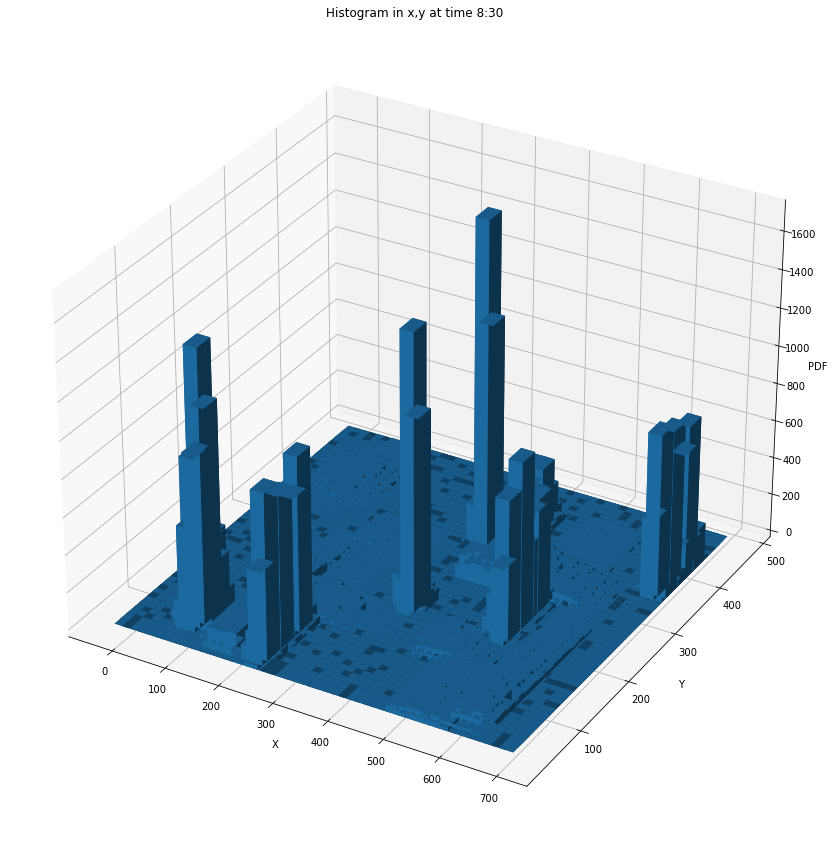

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]


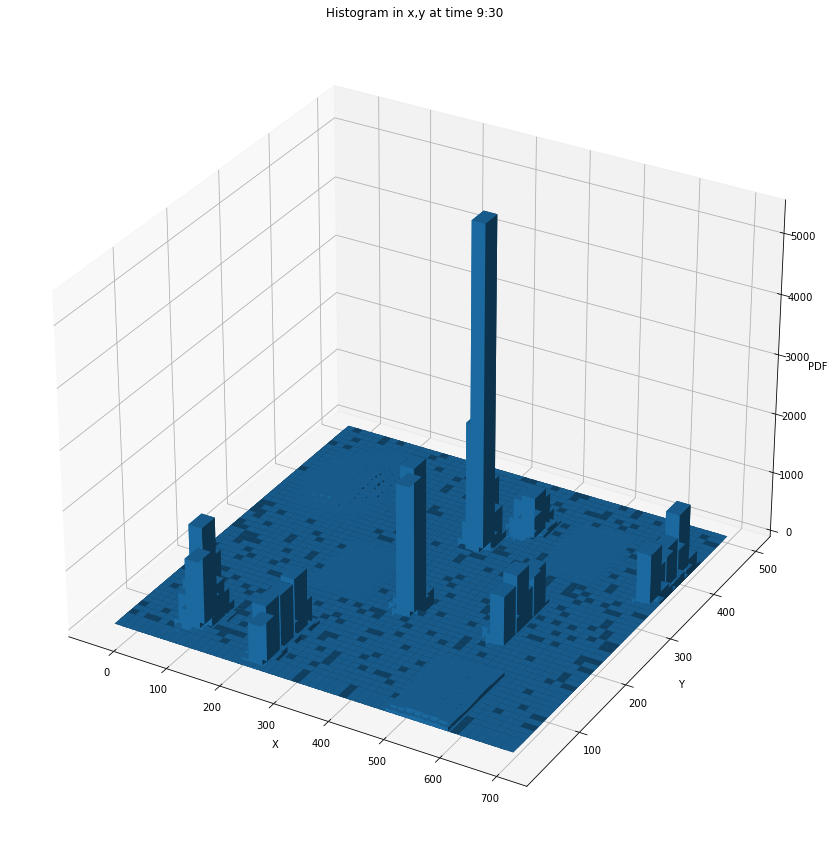

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]


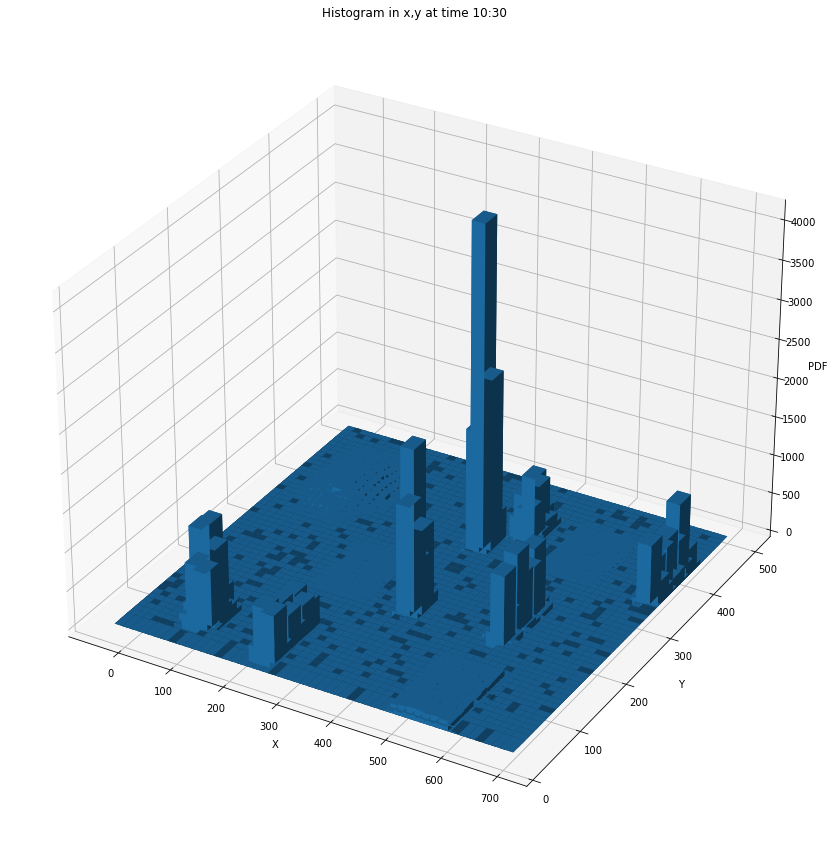

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]


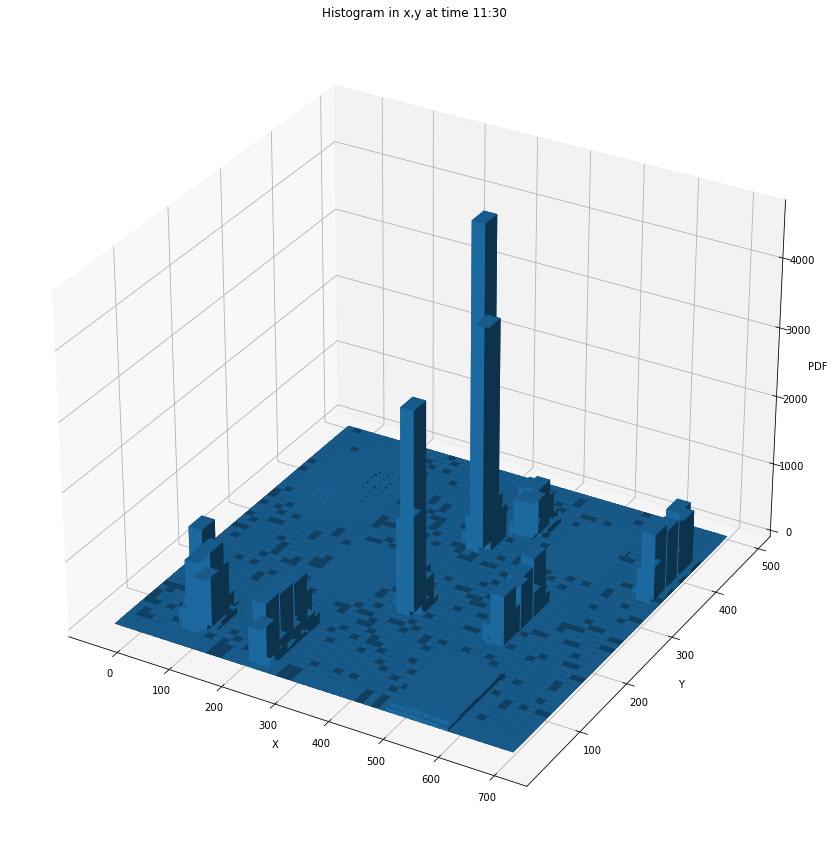

[[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.25370322e-07
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]]


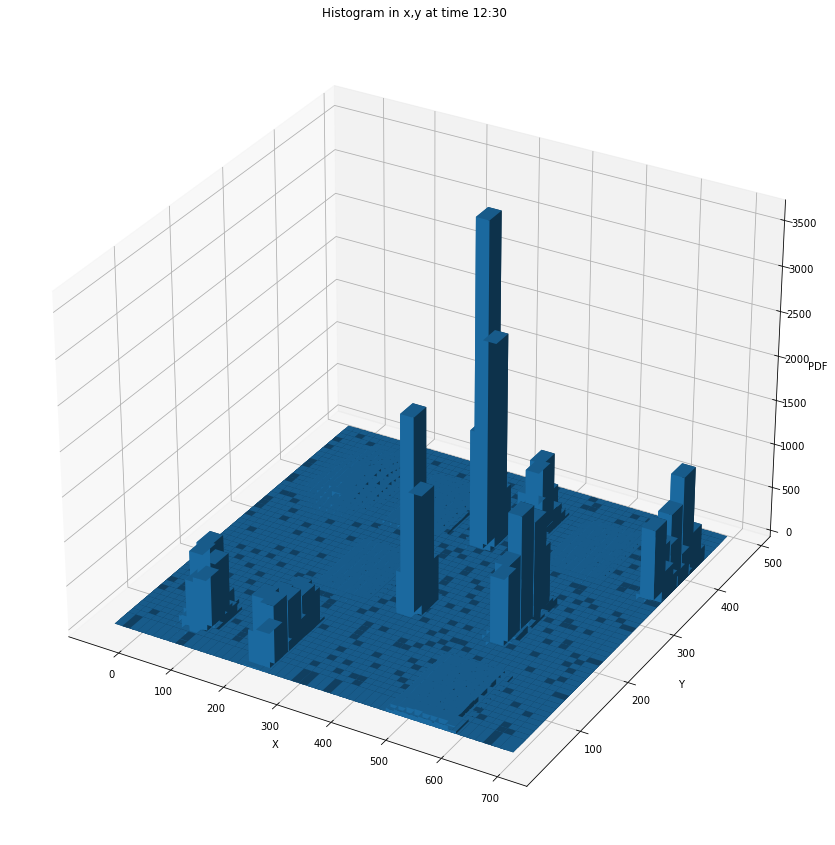

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]


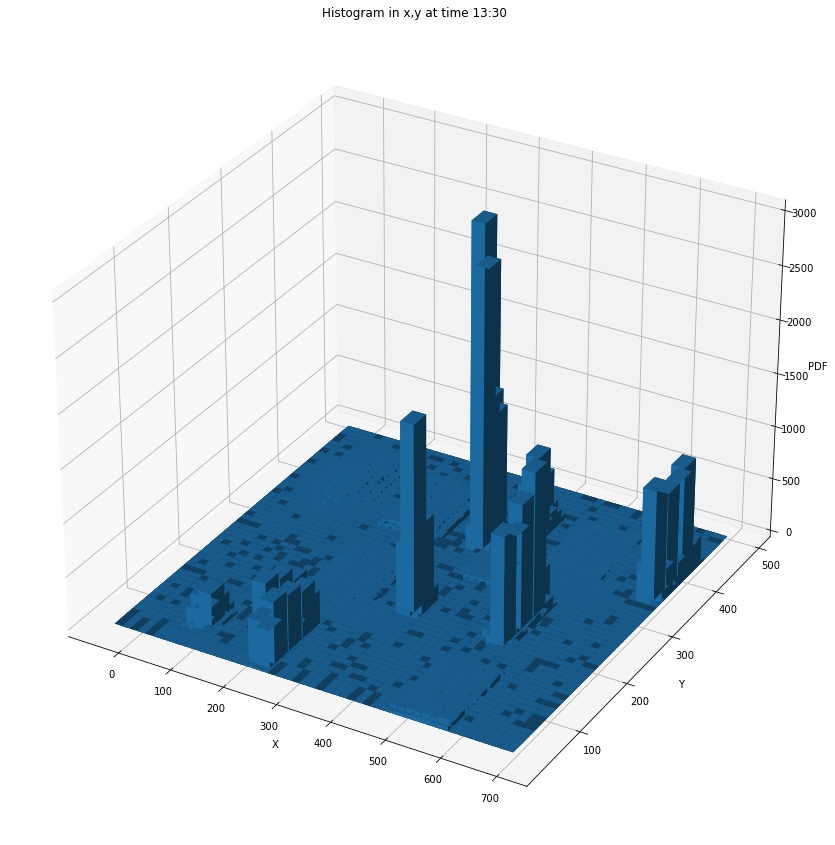

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]


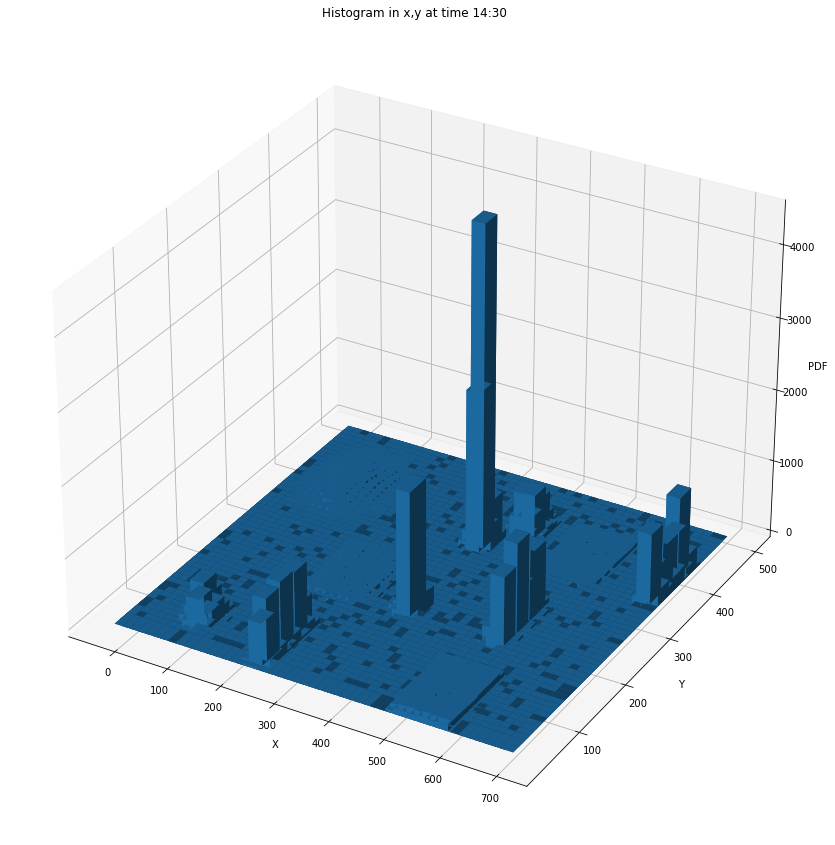

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]


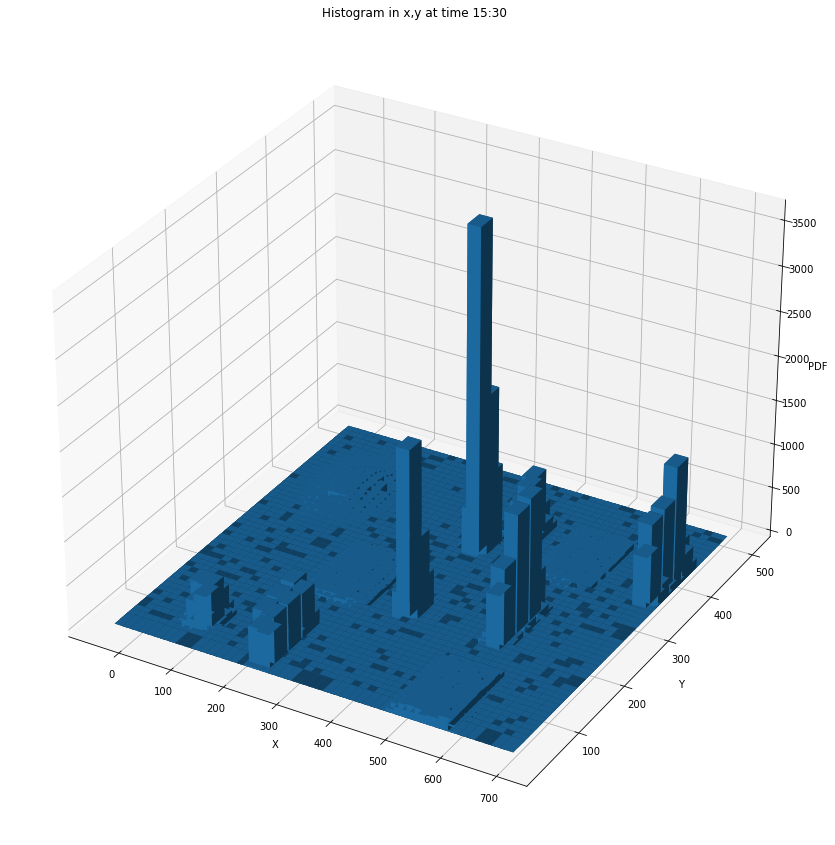

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]


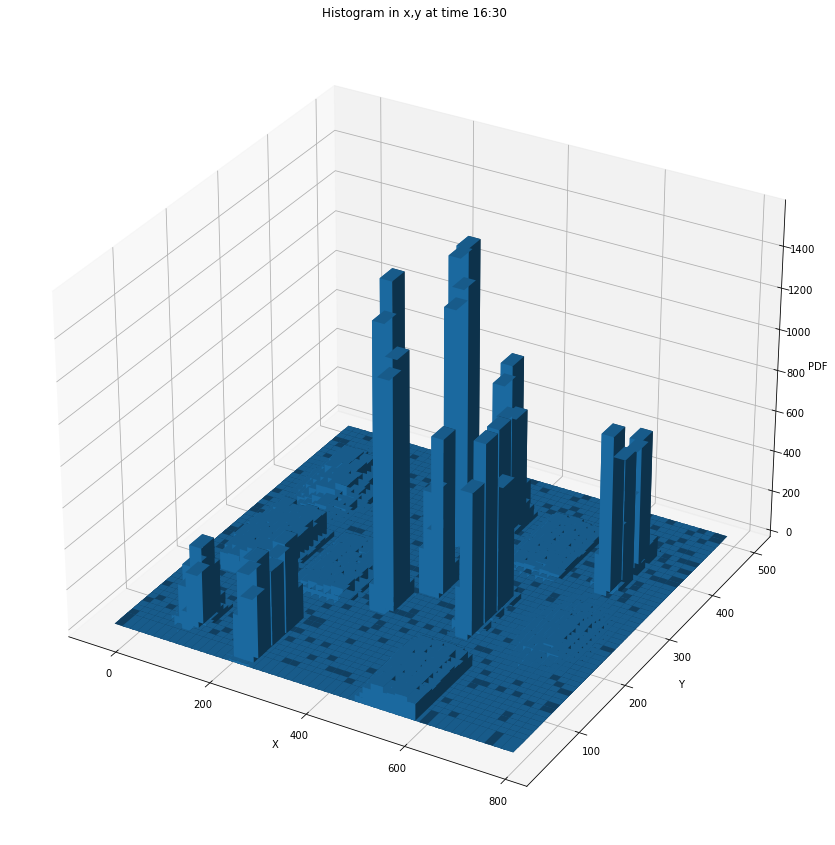

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]


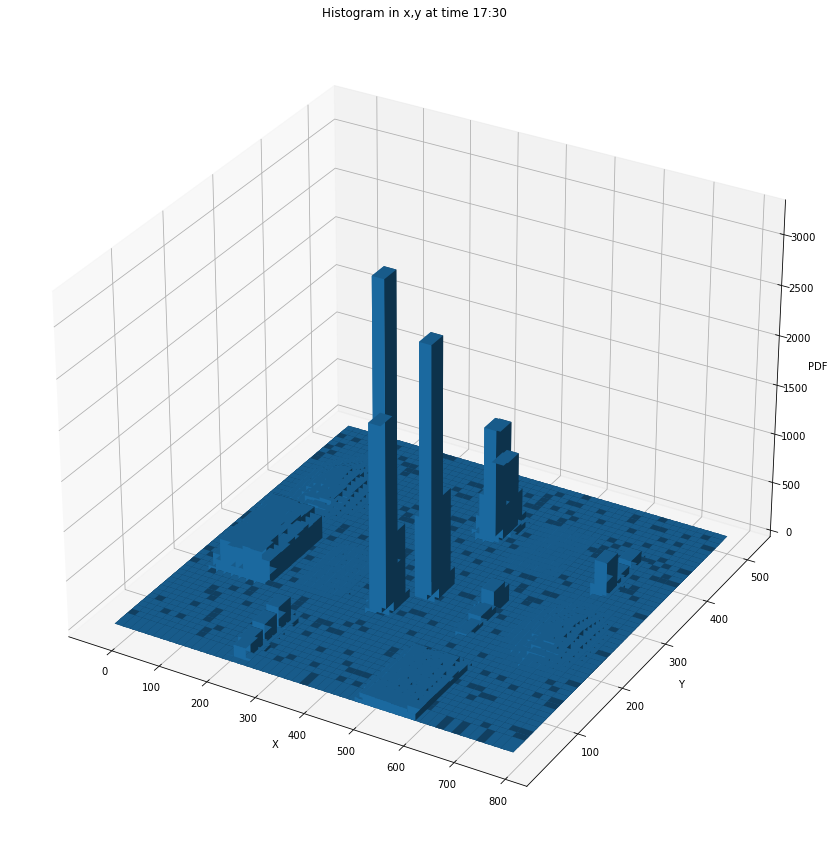

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]


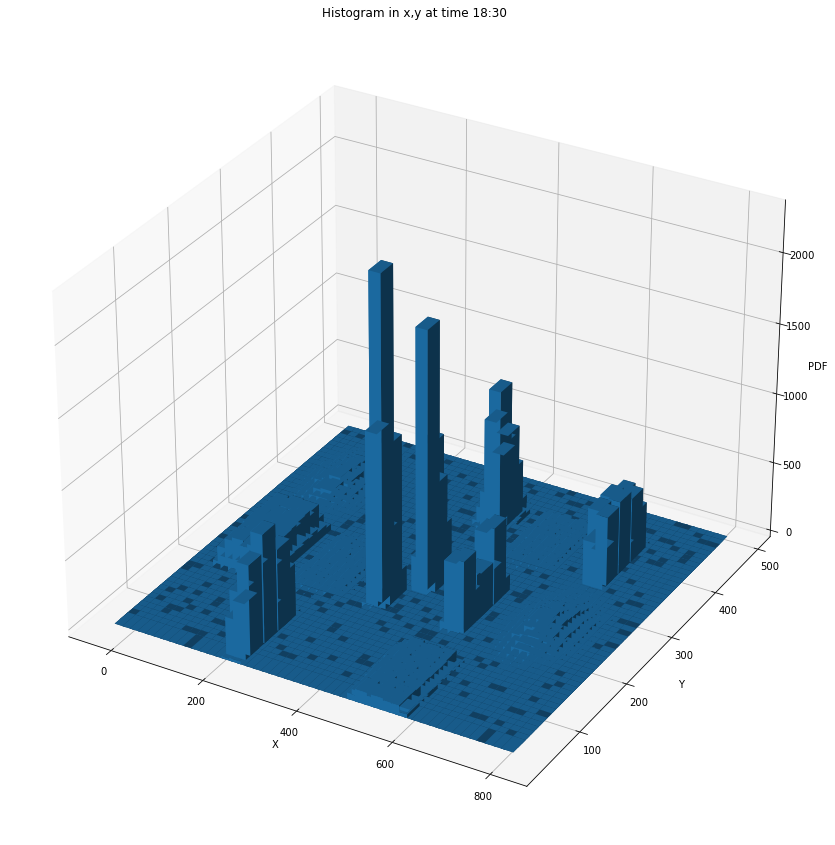

[[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.09681162e-07
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]]


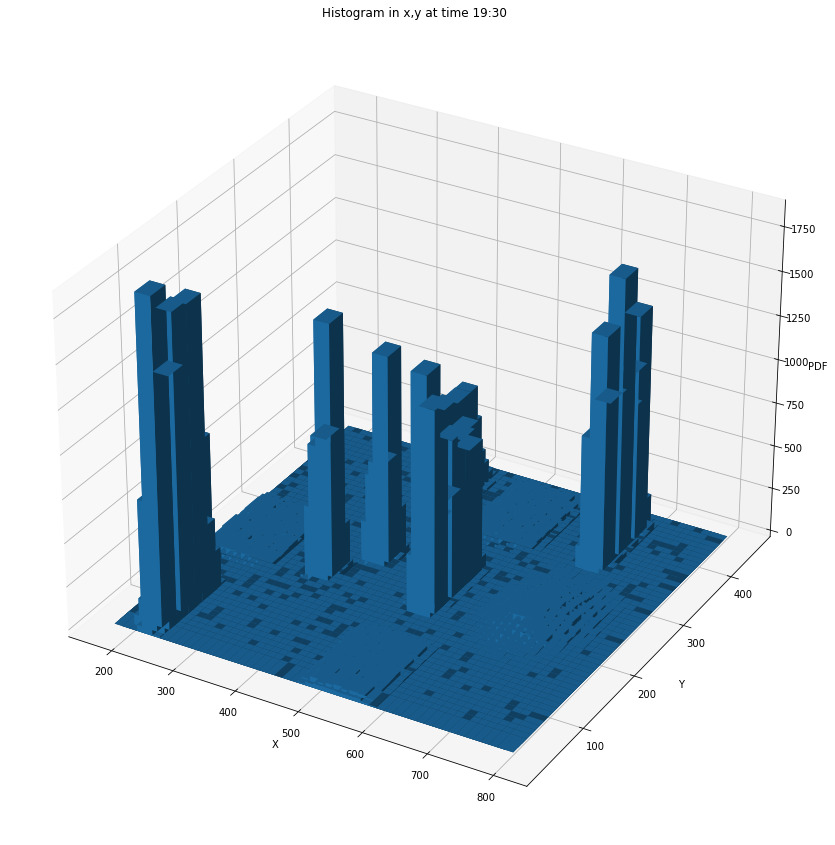

[[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [1.64001298e-07 9.84007785e-06 2.09921661e-05 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]]


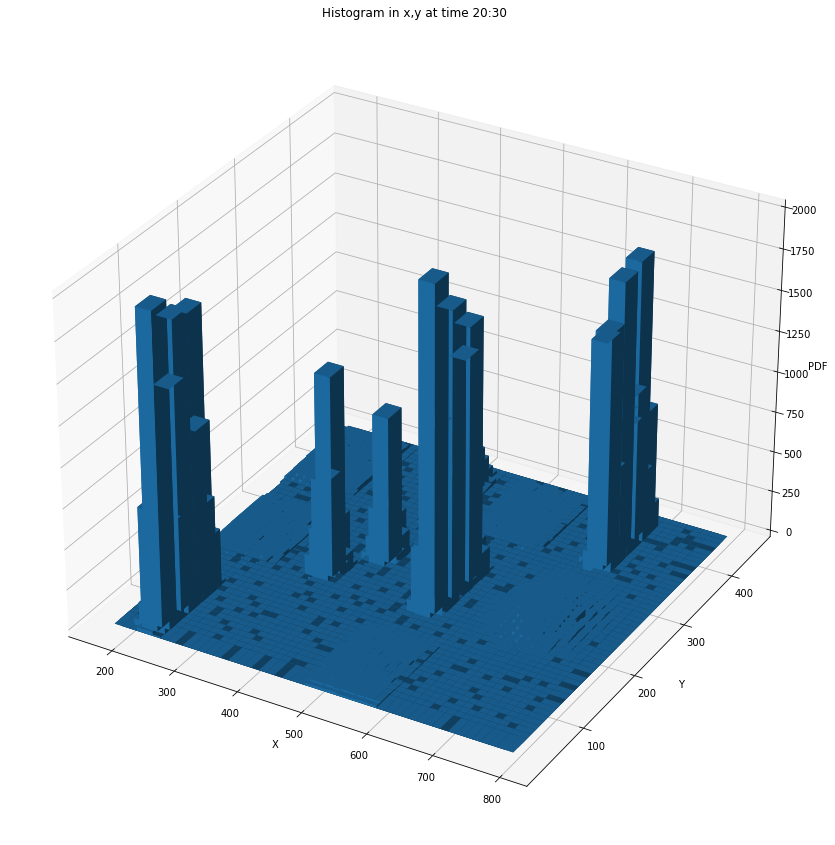

[[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 4.68255073e-06
  3.51191305e-06 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 4.84978469e-06
  4.01361492e-06 0.00000000e+00]
 [0.00000000e+00 6.52212424e-06 1.87302029e-05 ... 4.84978469e-06
  4.51531678e-06 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]]


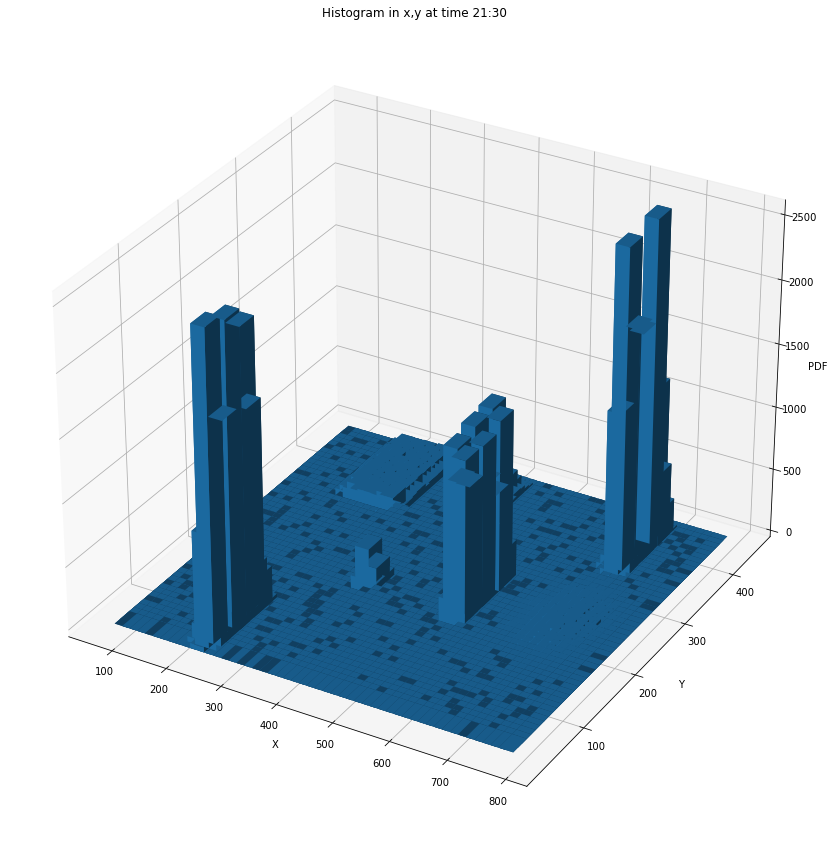

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]


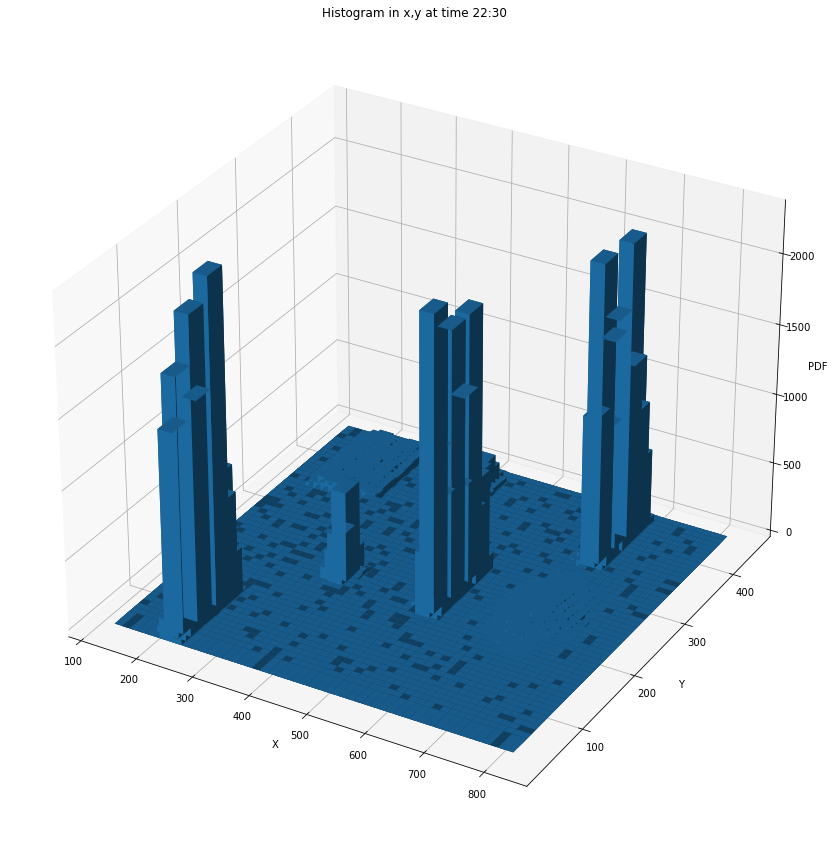

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]


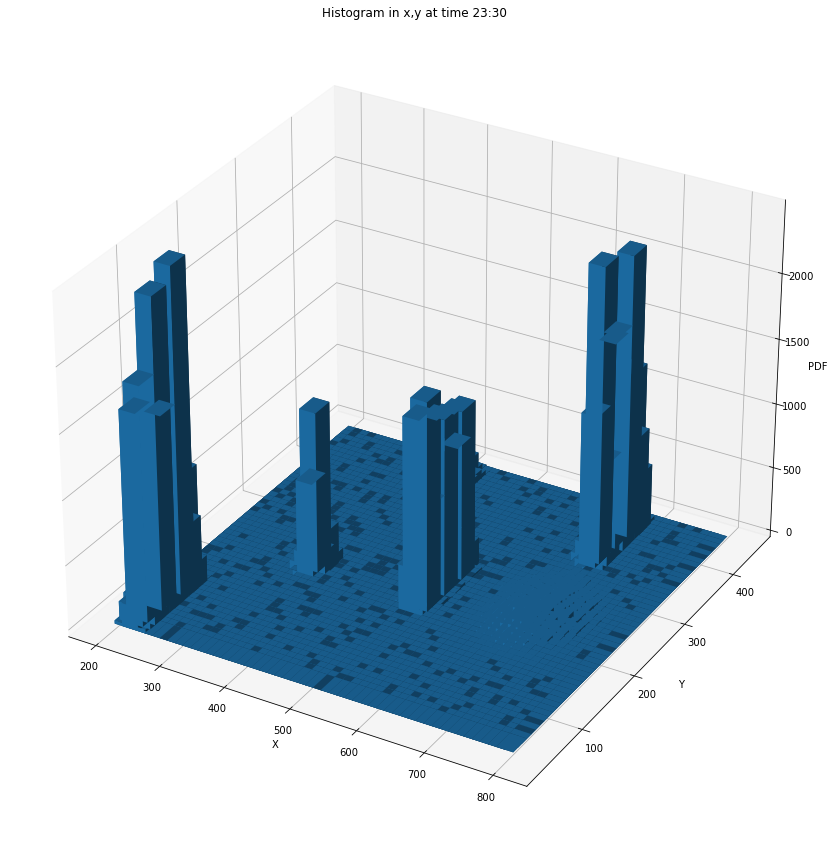

[[4.38084281e-06 2.50584209e-05 3.18925356e-05 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [3.15420682e-05 2.85806185e-04 3.16822552e-04 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [5.25701137e-06 6.37850713e-05 7.51752626e-05 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]]


In [62]:
arr = []
for i in range(0, 24):
    fig = plt.figure(figsize=(15, 15))
    ax = fig.add_subplot(projection='3d')
    hist, xedges, yedges = np.histogram2d(df['X'][(df["hour"]==i) & (df["min"]==30)], df['Y'][(df["hour"]==i) & (df["min"]==30)], bins=50)
# Construct arrays for the anchor positions of the 16 bars.
    xpos, ypos = np.meshgrid(xedges[:-1] + 25, yedges[:-1] + 25, indexing="ij")
    xpos = xpos.ravel()
    ypos = ypos.ravel()
    zpos = 0

# Construct arrays with the dimensions for the 16 bars.
    dx = dy = 25 * np.ones_like(zpos)
    dz = hist.ravel()
    arr.append(hist)
    ax.bar3d(xpos, ypos, zpos, dx, dy, dz, zsort='average')
    ax.set_title('Histogram in x,y at time {}:30'.format(i))
    ax.set_xlabel('X')
    ax.set_ylabel('Y')
    ax.set_zlabel('PDF')
    plt.show()
    hist_prob = hist/len(df['X'][(df["hour"]==i) & (df["min"]==30)])
    hist_pdf = hist_prob/((xedges[1]-xedges[0])*(yedges[1]-yedges[0]))
    print(hist_pdf)

In [65]:
df = pd.DataFrame(pd.read_csv("saturday.csv"))

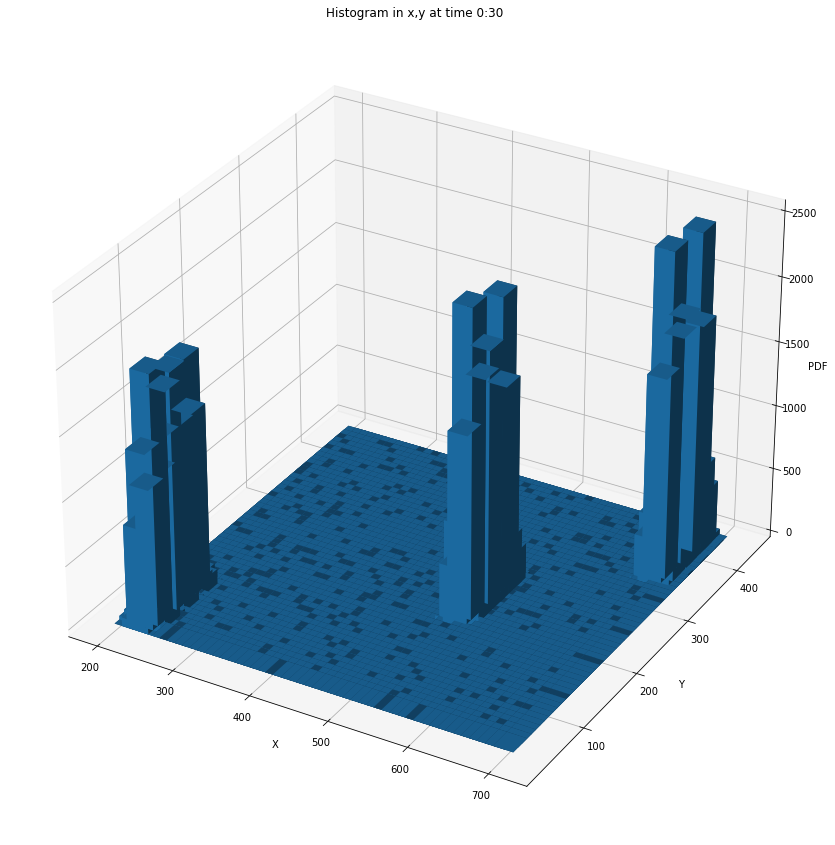

[[2.12908698e-07 6.17435223e-06 1.02196175e-05 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [1.40519740e-05 1.62449336e-04 2.80400755e-04 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [1.98005089e-05 2.32070480e-04 4.13894508e-04 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 5.28439387e-04
  3.70886951e-04 2.98072177e-05]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.43926280e-04
  9.79380009e-05 8.94216530e-06]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.06454349e-06
  1.49036088e-06 0.00000000e+00]]


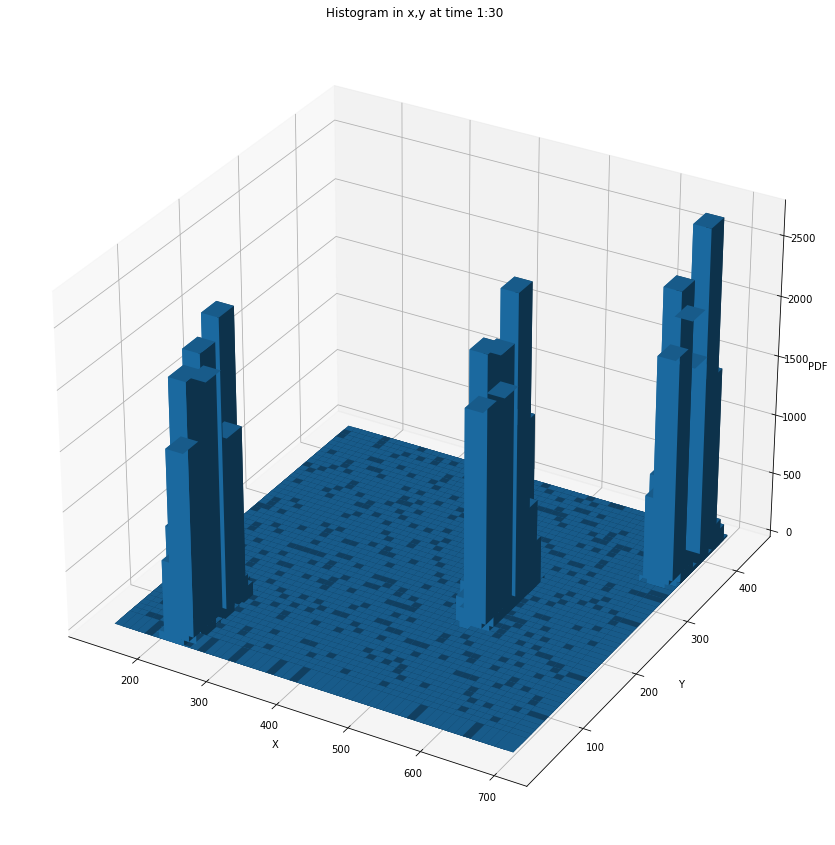

[[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.80806884e-04
  9.96361340e-05 5.96278022e-06]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 5.25878746e-04
  2.80443018e-04 1.69266019e-05]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 4.19318093e-05
  2.65439894e-05 2.50052074e-06]]


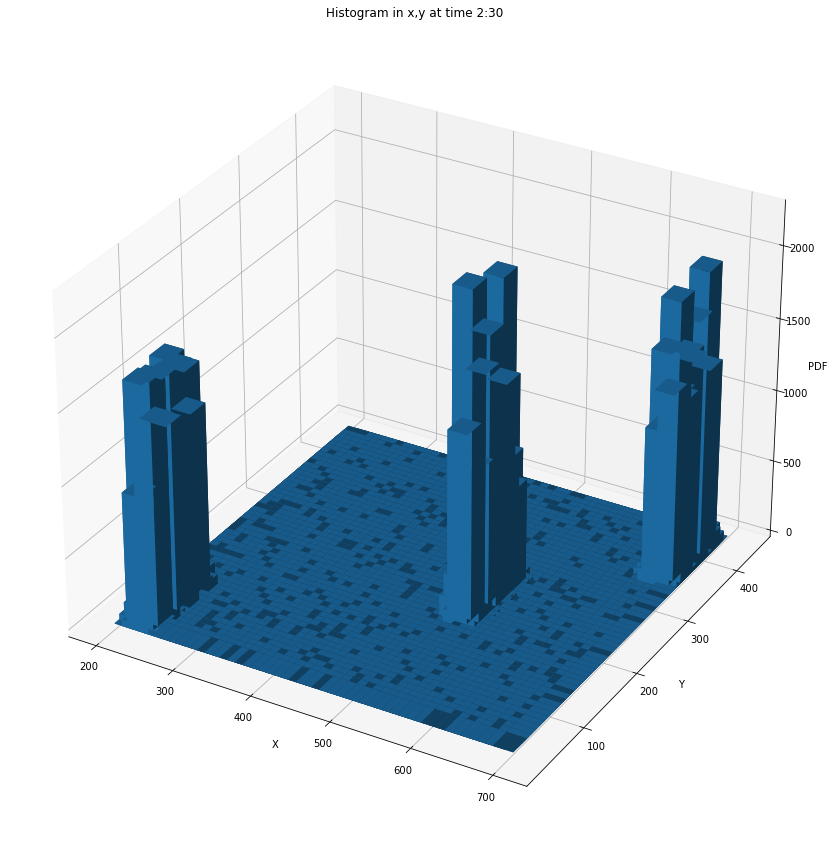

[[6.45931631e-07 8.61242175e-06 2.02391911e-05 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [9.25835338e-06 1.95286663e-04 3.55047087e-04 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [9.68897447e-06 1.78277130e-04 3.62582956e-04 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 3.47295907e-04
  2.10143091e-04 1.74401540e-05]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 4.23731150e-04
  2.73229080e-04 1.85167068e-05]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 2.69138180e-05
  1.46411170e-05 8.61242175e-07]]


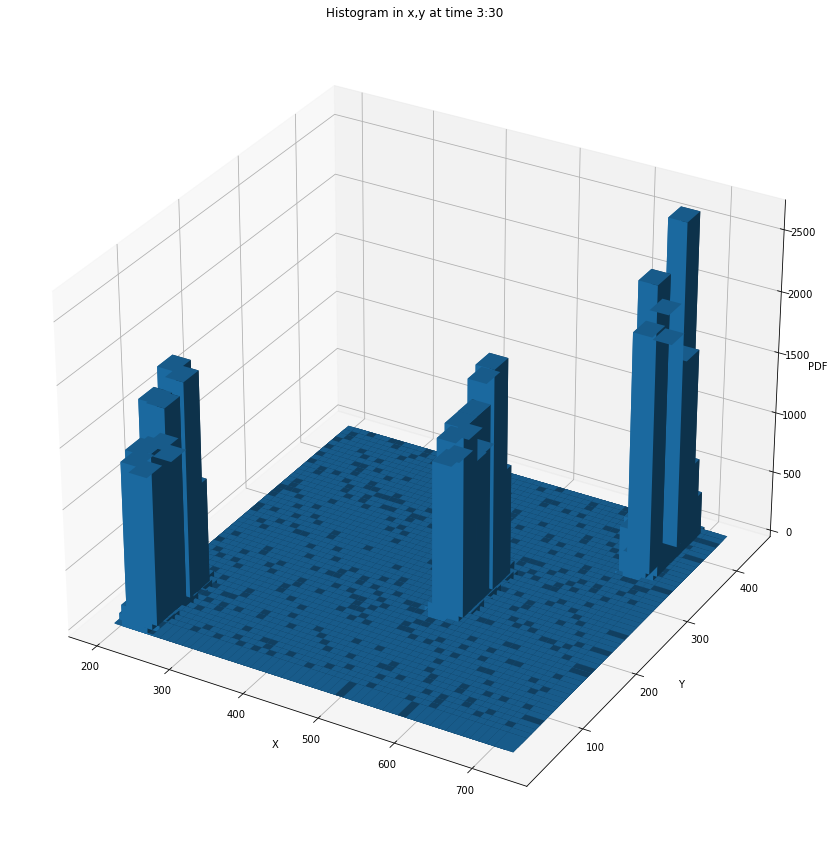

[[1.43262982e-06 1.10517158e-05 1.24843456e-05 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [3.64297298e-05 2.71381021e-04 2.84684012e-04 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [2.90619193e-05 2.57464045e-04 2.91028516e-04 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 6.13984210e-07
  8.18645613e-07 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]]


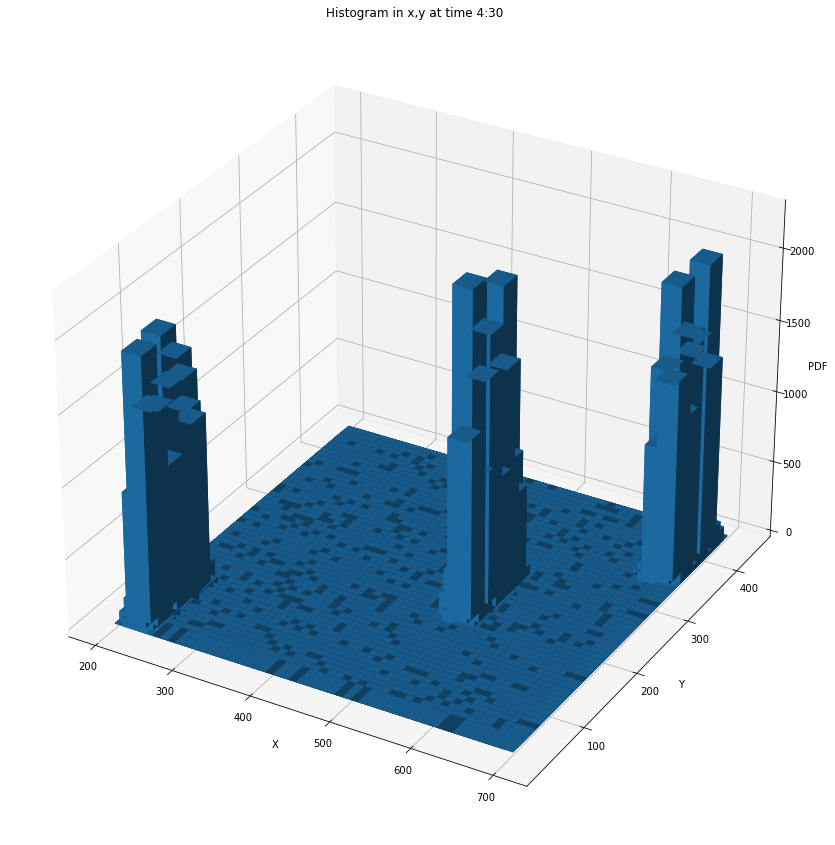

[[8.62946572e-07 1.29441986e-05 2.73985537e-05 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [1.25127253e-05 1.98046238e-04 4.00622946e-04 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [8.41372908e-06 1.49074020e-04 3.22094808e-04 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 3.18858758e-04
  2.07107177e-04 1.14340421e-05]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 4.38592595e-04
  2.79594689e-04 1.89848246e-05]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 3.55965461e-05
  2.15736643e-05 1.94162979e-06]]


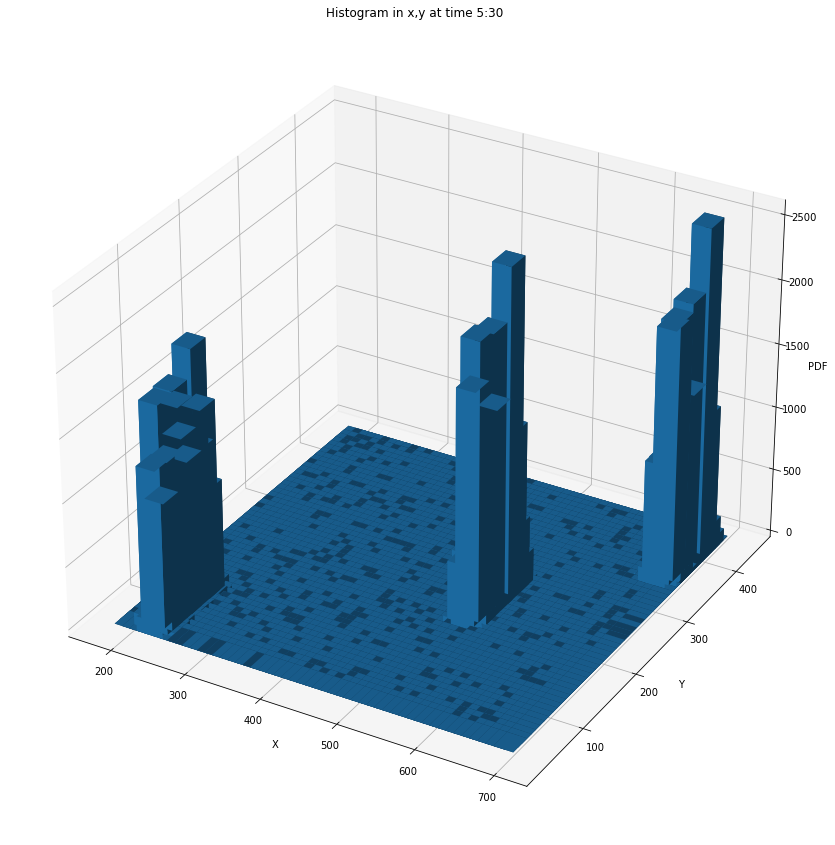

[[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [2.07187566e-07 1.96828188e-05 1.74037556e-05 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 2.58777270e-04
  9.48919054e-05 7.25156482e-06]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 5.30192982e-04
  2.20861946e-04 1.22240664e-05]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 4.70315776e-05
  1.96828188e-05 8.28750266e-07]]


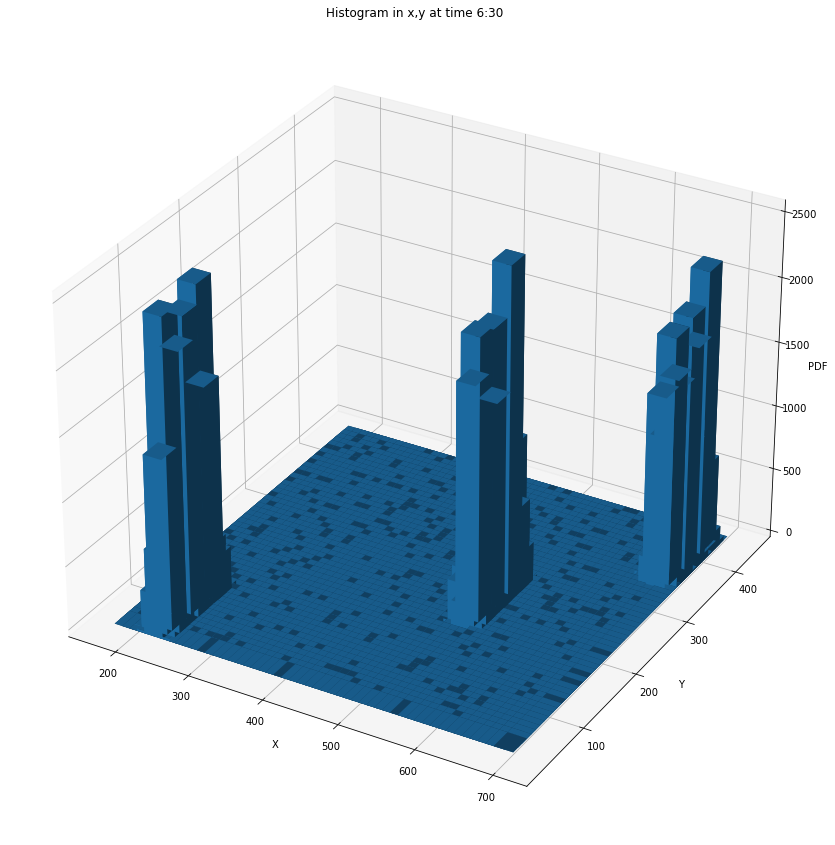

[[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 8.10402724e-07 2.02600681e-07 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 3.26389697e-04
  1.02718545e-04 3.44421158e-06]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 4.47342304e-04
  1.34526852e-04 5.47021839e-06]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 2.95796994e-05
  7.09102384e-06 0.00000000e+00]]


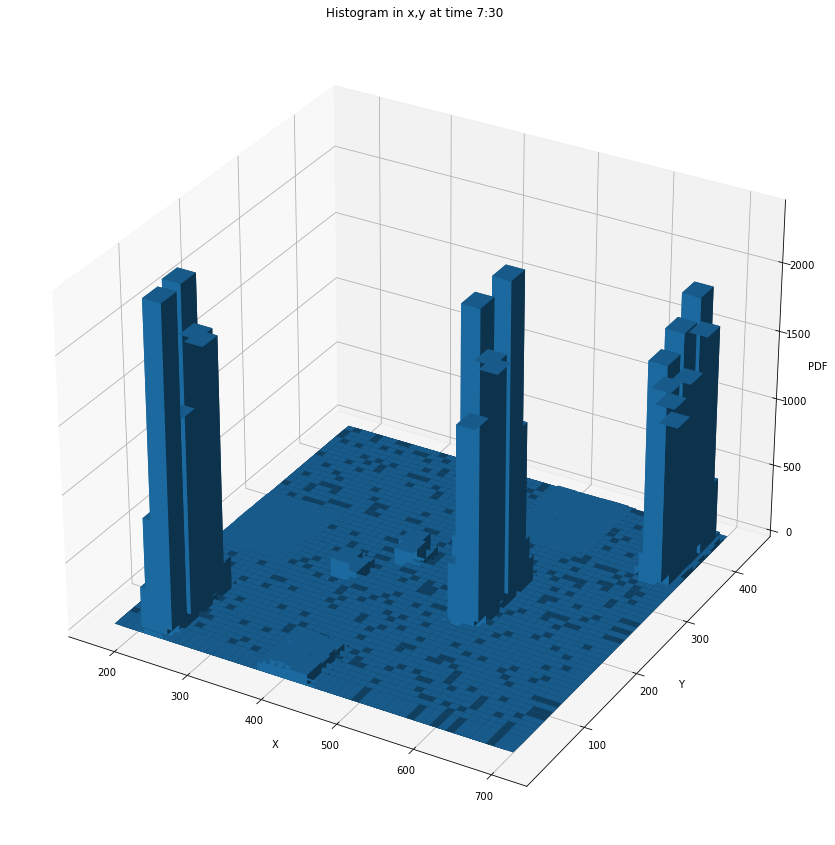

[[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 8.05972778e-07 2.41791833e-06 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 3.80822138e-04
  1.27948178e-04 4.02986389e-06]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 3.26015989e-04
  9.14779103e-05 3.22389111e-06]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 9.26868694e-06
  2.41791833e-06 0.00000000e+00]]


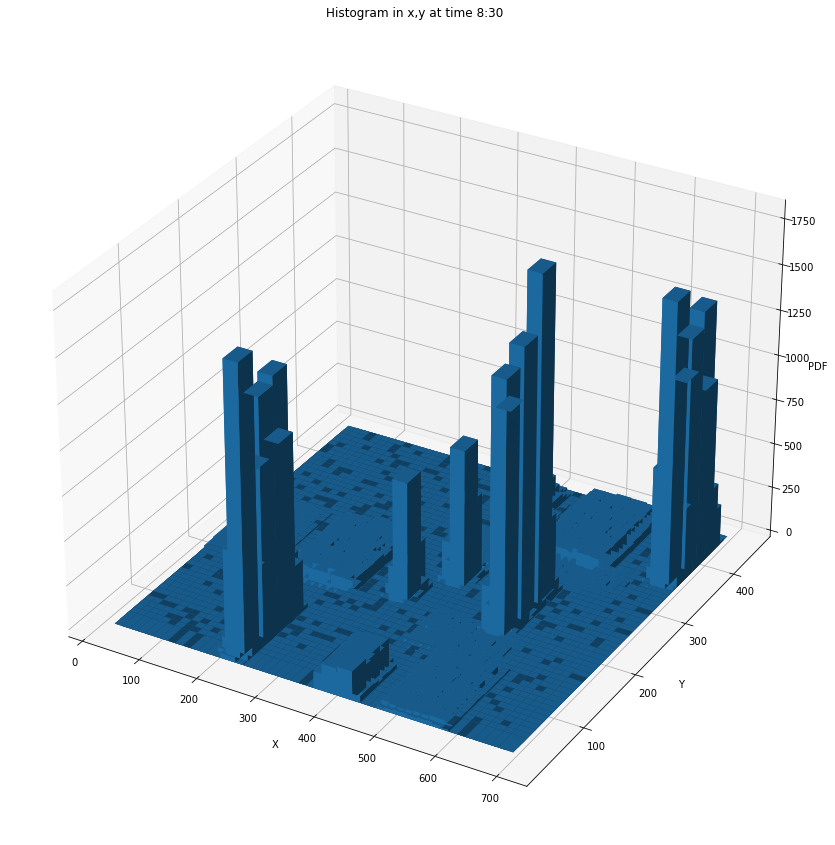

[[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 8.67815083e-06
  1.54966979e-07 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.43654390e-04
  1.02278206e-05 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 3.53324713e-05
  1.54966979e-06 0.00000000e+00]]


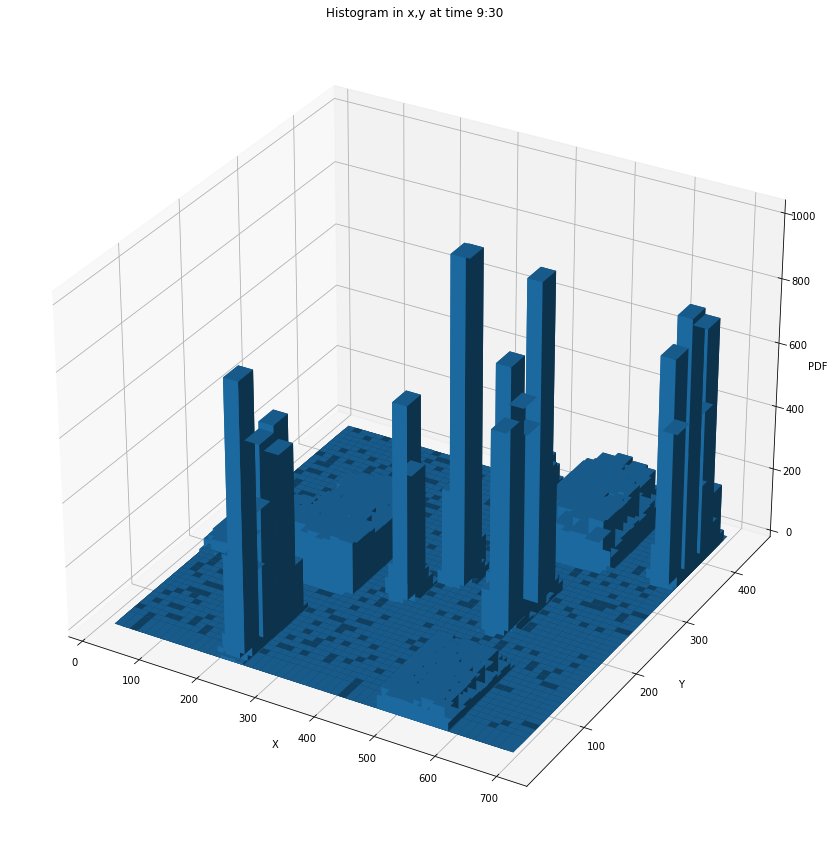

[[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 3.59559183e-06
  2.18862111e-06 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.11307017e-04
  2.29805217e-05 3.12660159e-07]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 3.00153753e-05
  5.15889263e-06 0.00000000e+00]]


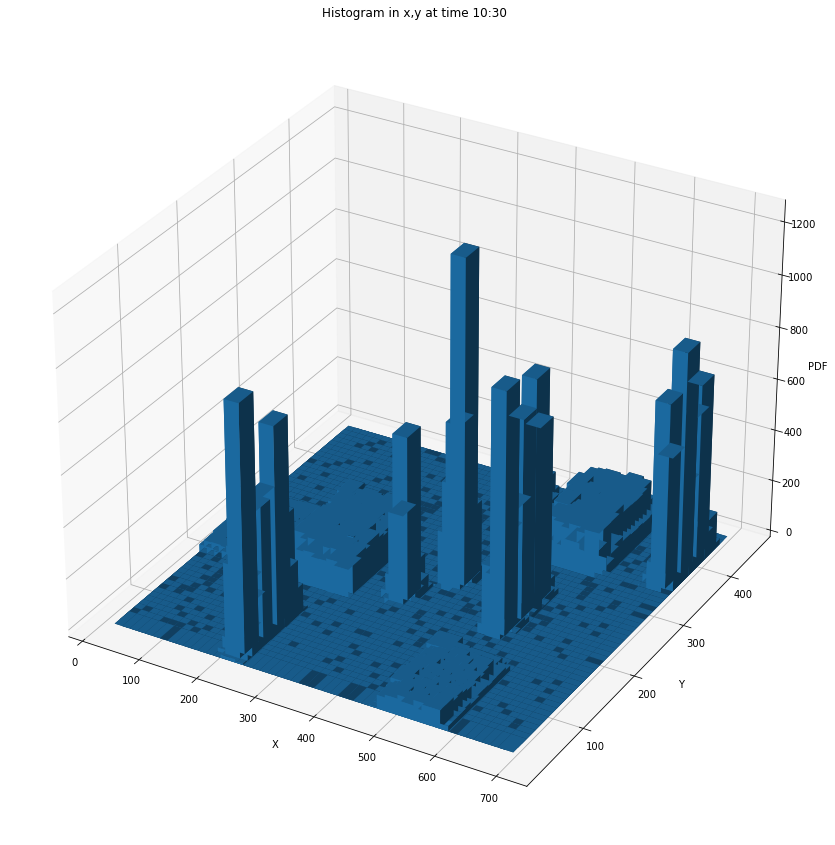

[[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.21934539e-06
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.43273084e-05
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 3.35319983e-06
  0.00000000e+00 0.00000000e+00]]


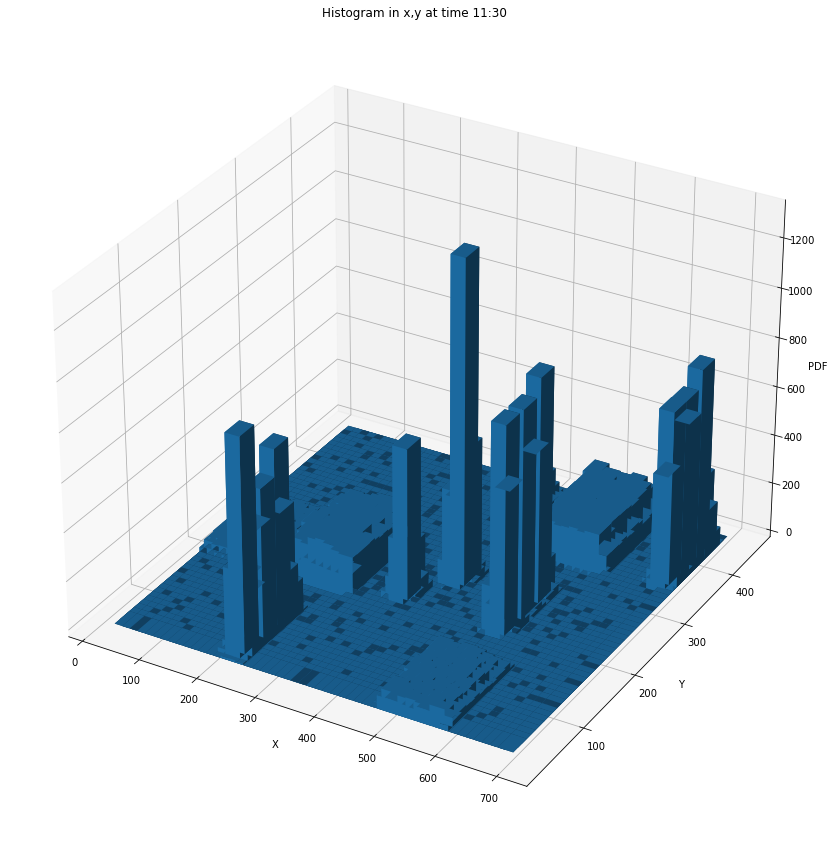

[[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.84901464e-06
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 4.71498732e-05
  2.00309919e-06 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.12481724e-05
  3.08169106e-07 0.00000000e+00]]


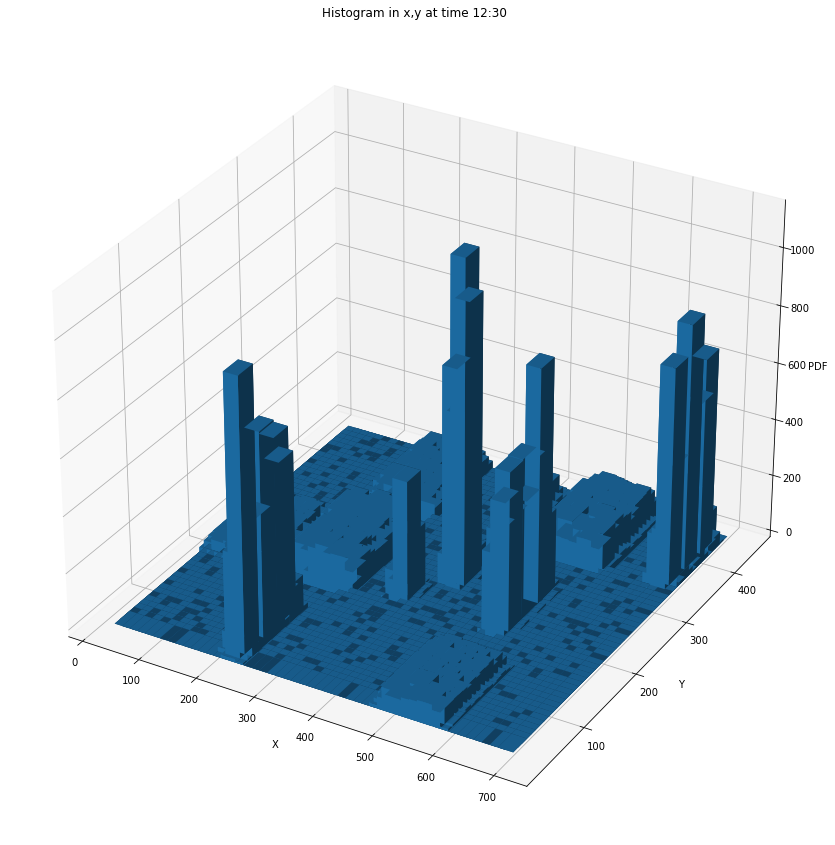

[[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 2.29332503e-05
  4.64863182e-06 1.54954394e-07]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.06763577e-04
  1.78197553e-05 3.09908788e-07]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 6.97294773e-06
  7.74771970e-07 0.00000000e+00]]


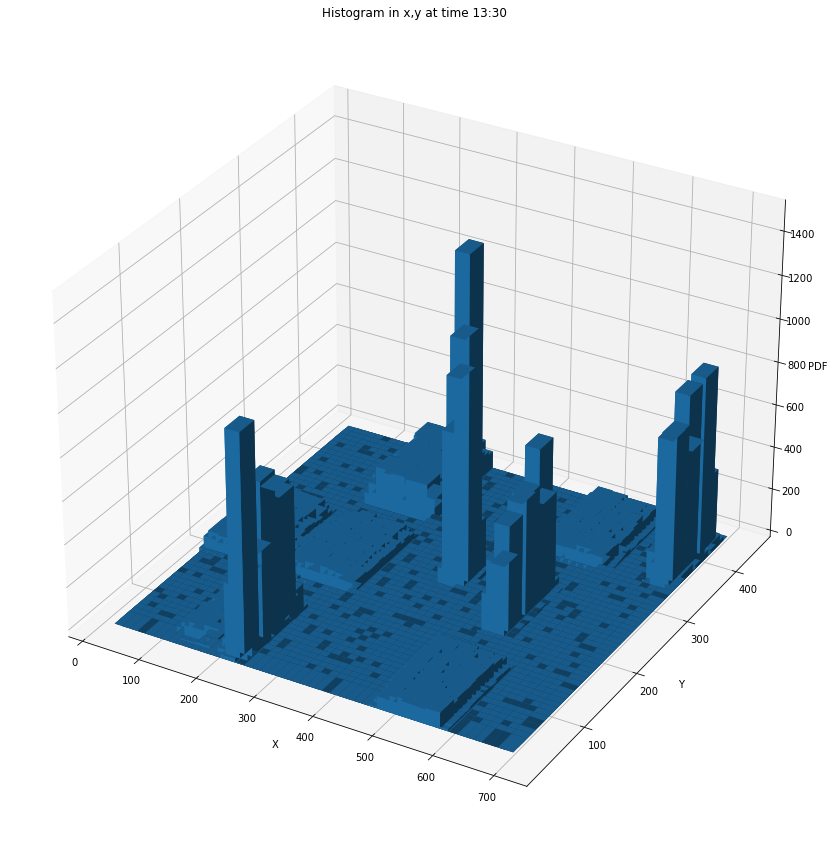

[[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 2.74869602e-05
  1.06199619e-05 6.24703642e-07]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.29626006e-04
  5.15380504e-05 4.68527731e-07]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 7.02791597e-06
  2.81116639e-06 0.00000000e+00]]


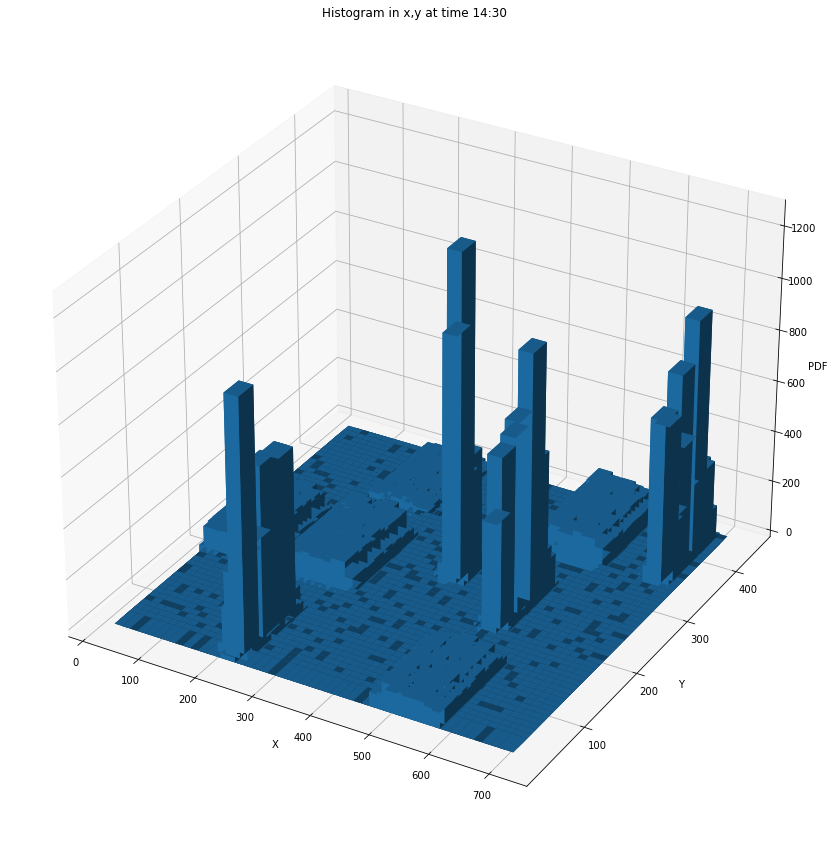

[[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.40699504e-04
  4.92139714e-05 1.07993041e-06]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 5.02939018e-05
  2.03644019e-05 7.71378861e-07]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.54275772e-07
  1.54275772e-07 0.00000000e+00]]


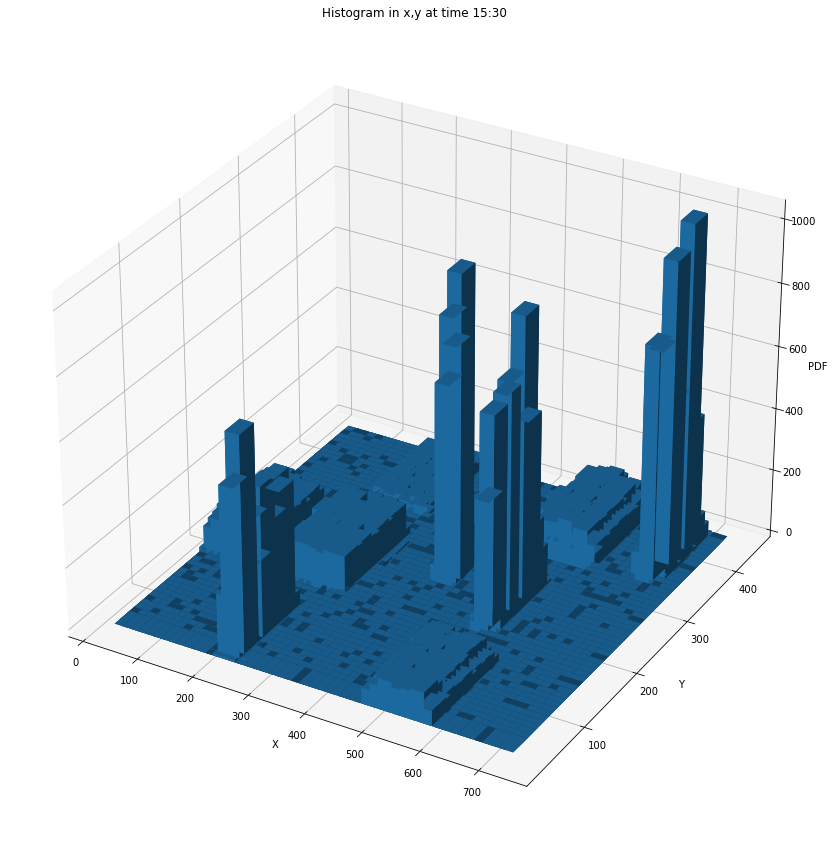

[[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.41237116e-05
  7.36236032e-06 4.50756754e-07]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]]


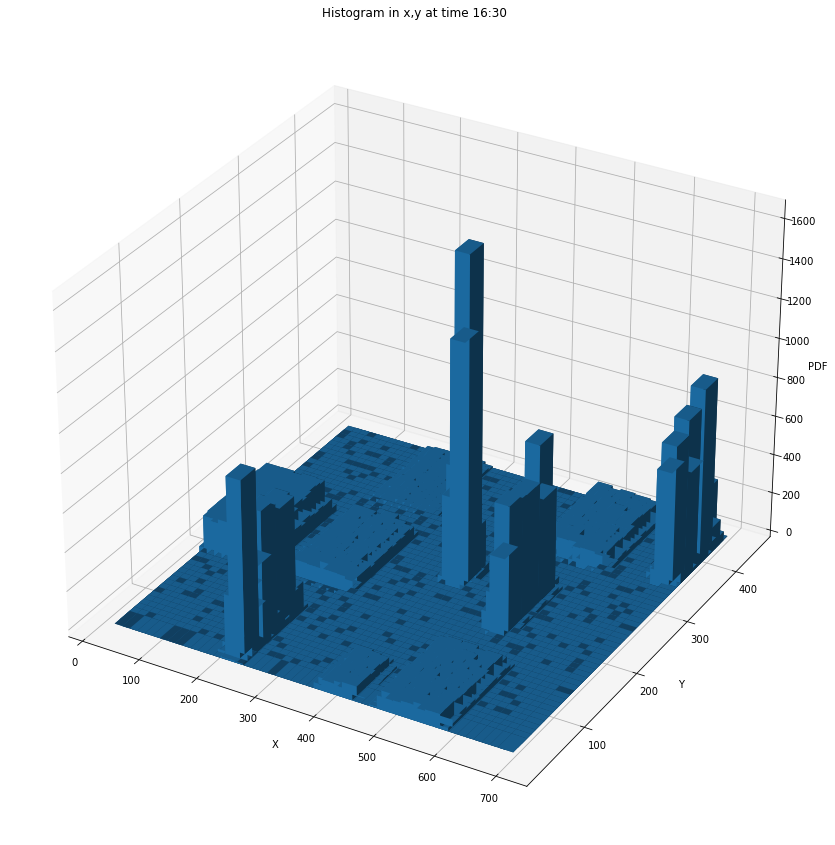

[[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 8.63311656e-06
  3.92414389e-06 1.56965756e-07]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.33891790e-04
  4.85024185e-05 1.56965756e-06]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 2.04055482e-05
  7.22042476e-06 3.13931511e-07]]


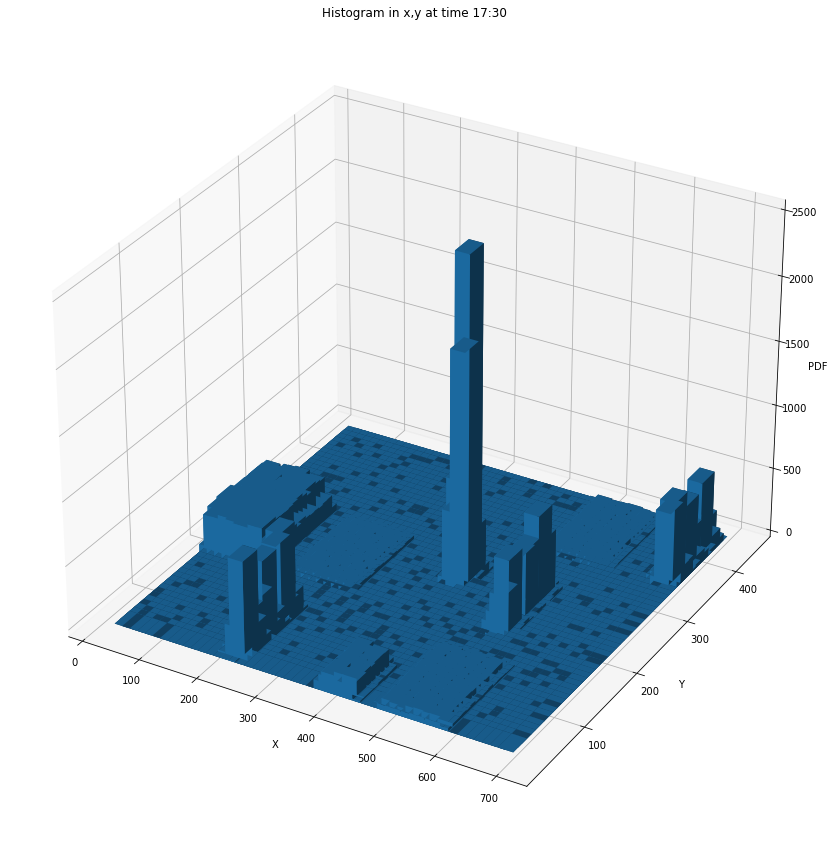

[[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 5.64963650e-06
  2.51094956e-06 1.56934347e-07]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 8.83540375e-05
  3.49963595e-05 1.56934347e-06]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 2.02445308e-05
  8.78832345e-06 0.00000000e+00]]


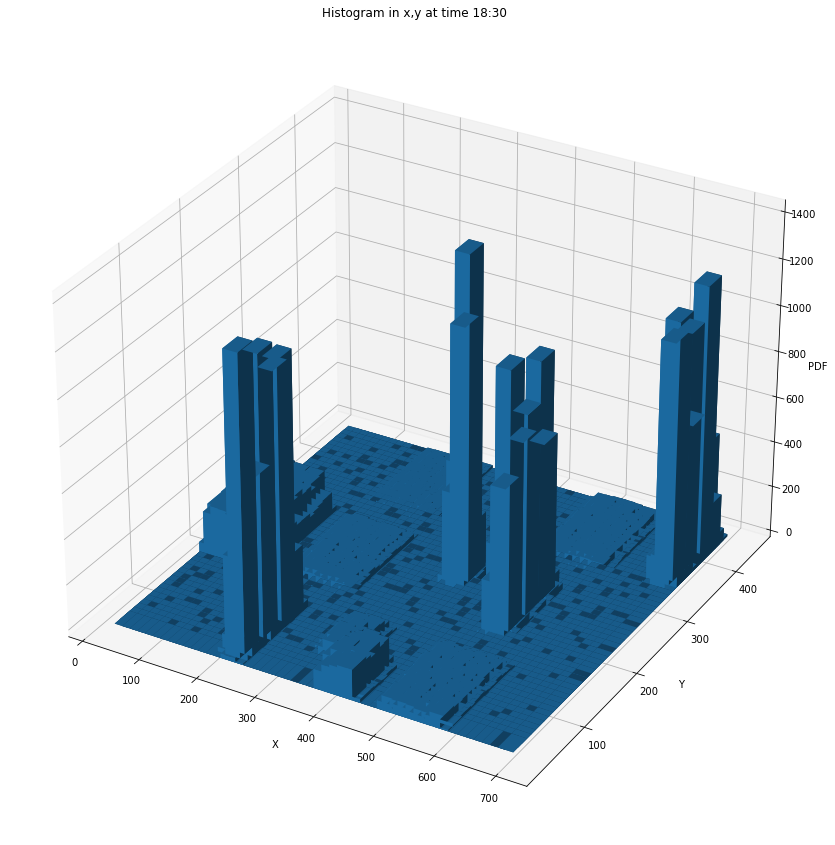

[[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.78809267e-05
  7.37196100e-06 1.56850234e-07]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.84455875e-04
  7.37196100e-05 3.29385492e-06]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 3.51344524e-05
  8.62676288e-06 1.56850234e-06]]


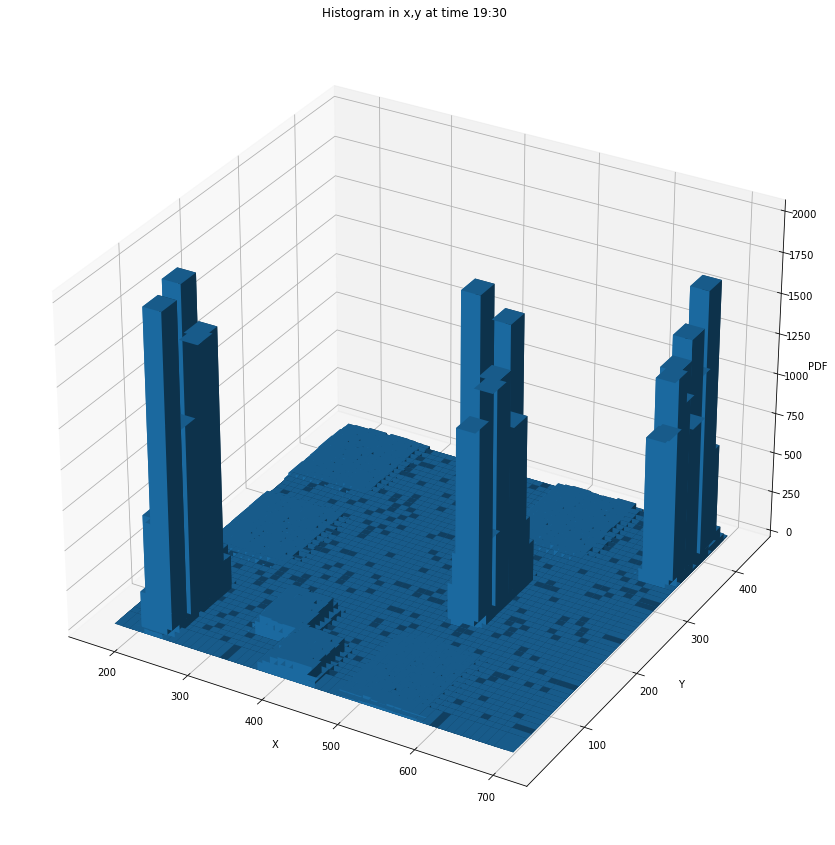

[[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 4.86255504e-06
  3.44430982e-06 2.83649044e-06]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 4.05212920e-06
  5.06516150e-06 3.64691628e-06]
 [0.00000000e+00 2.02606460e-07 1.21563876e-06 ... 3.84952274e-06
  4.65994858e-06 3.24170336e-06]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 2.20233222e-04
  7.90165194e-05 3.24170336e-06]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 3.33895446e-04
  1.20956057e-04 6.28080026e-06]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 2.26919235e-05
  8.71207778e-06 1.21563876e-06]]


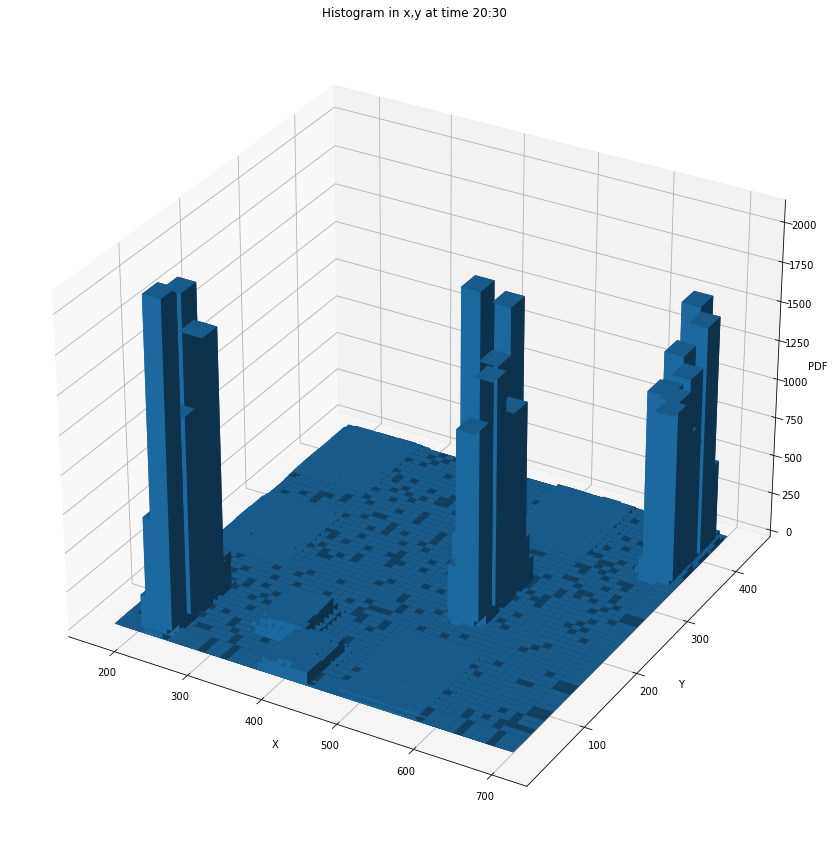

[[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.61508071e-06
  3.43204651e-06 1.61508071e-06]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.81696580e-06
  2.62450615e-06 2.82639124e-06]
 [0.00000000e+00 2.01885089e-07 1.00942544e-06 ... 2.22073598e-06
  3.23016142e-06 2.62450615e-06]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 3.21401061e-04
  1.20929168e-04 4.84524213e-06]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 2.97578621e-04
  1.03768936e-04 4.44147195e-06]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.00942544e-05
  4.84524213e-06 2.01885089e-07]]


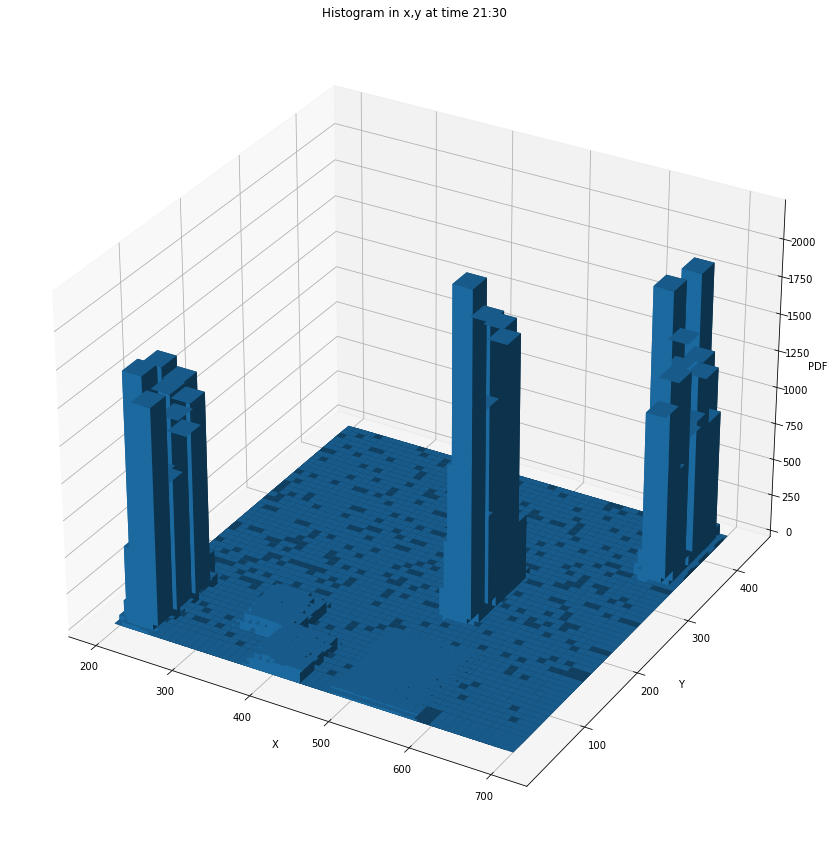

[[2.13871315e-07 6.63001075e-06 2.24564880e-05 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [6.41613944e-06 1.11854697e-04 3.57592838e-04 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [4.70516892e-06 1.03299845e-04 3.16315674e-04 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 4.06783240e-04
  2.74183025e-04 2.50229438e-05]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 2.59212033e-04
  1.89276113e-04 1.51848633e-05]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 6.20226812e-06
  4.49129760e-06 6.41613944e-07]]


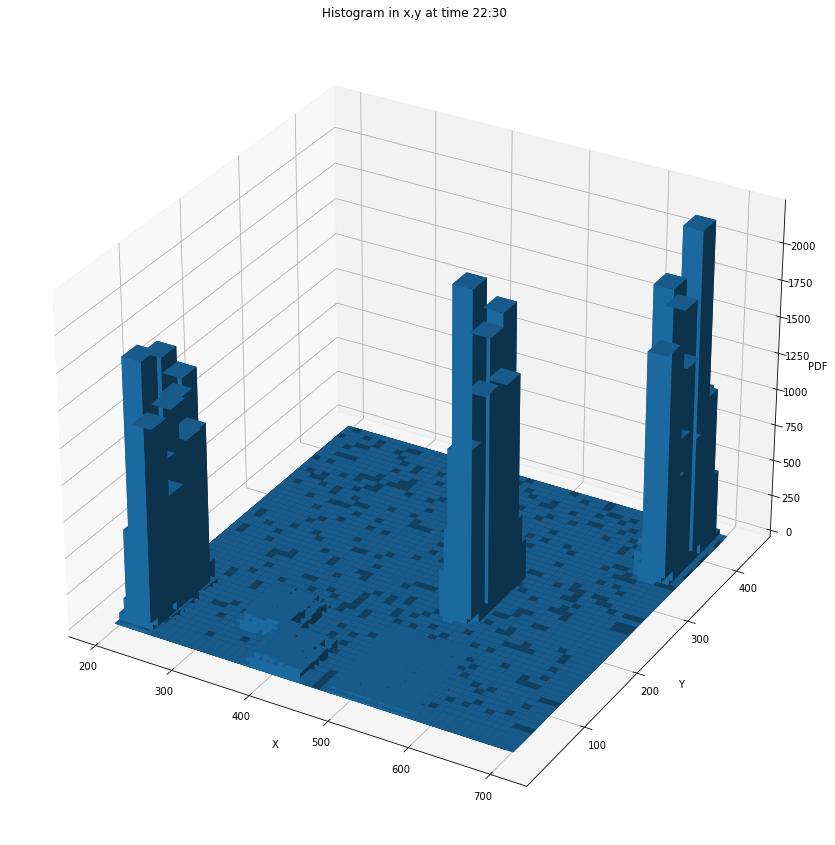

[[2.12837635e-07 1.02162065e-05 2.59661915e-05 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [4.46959034e-06 1.36854600e-04 3.80553692e-04 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [5.53377852e-06 9.96080134e-05 2.87543645e-04 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 4.70796849e-04
  2.26672082e-04 1.23445829e-05]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 2.29651809e-04
  1.02162065e-04 7.23647960e-06]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 6.59796670e-06
  2.12837635e-06 0.00000000e+00]]


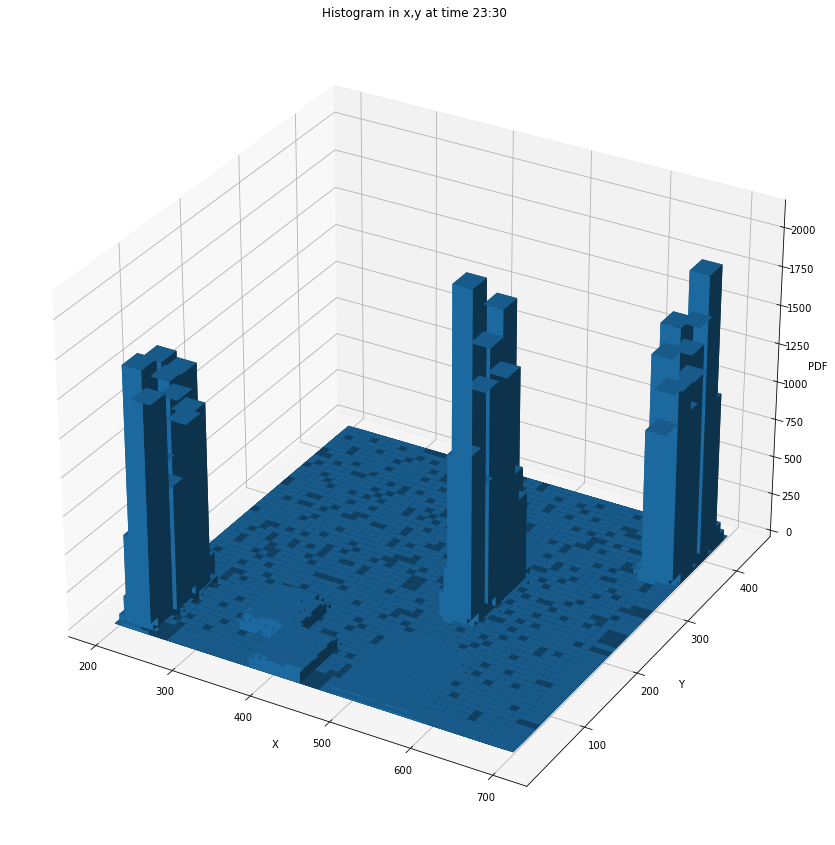

[[4.28746660e-07 7.93181321e-06 2.78685329e-05 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [5.35933325e-06 1.23907785e-04 3.52858501e-04 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [4.28746660e-06 1.13617865e-04 3.08697595e-04 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 3.17915649e-04
  1.62280611e-04 9.43242653e-06]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 3.92731941e-04
  2.07942130e-04 1.54348798e-05]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 3.19416262e-05
  1.52205064e-05 8.57493321e-07]]


In [66]:
arr = []
for i in range(0, 24):
    fig = plt.figure(figsize=(15, 15))
    ax = fig.add_subplot(projection='3d')
    hist, xedges, yedges = np.histogram2d(df['X'][(df["hour"]==i) & (df["min"]==30)], df['Y'][(df["hour"]==i) & (df["min"]==30)], bins=50)
# Construct arrays for the anchor positions of the 16 bars.
    xpos, ypos = np.meshgrid(xedges[:-1] + 25, yedges[:-1] + 25, indexing="ij")
    xpos = xpos.ravel()
    ypos = ypos.ravel()
    zpos = 0

# Construct arrays with the dimensions for the 16 bars.
    dx = dy = 25 * np.ones_like(zpos)
    dz = hist.ravel()
    arr.append(hist)
    ax.bar3d(xpos, ypos, zpos, dx, dy, dz, zsort='average')
    ax.set_title('Histogram in x,y at time {}:30'.format(i))
    ax.set_xlabel('X')
    ax.set_ylabel('Y')
    ax.set_zlabel('PDF')
    plt.show()
    hist_prob = hist/len(df['X'][(df["hour"]==i) & (df["min"]==30)])
    hist_pdf = hist_prob/((xedges[1]-xedges[0])*(yedges[1]-yedges[0]))
    print(hist_pdf)

In [67]:
df = pd.DataFrame(pd.read_csv("sunday.csv"))

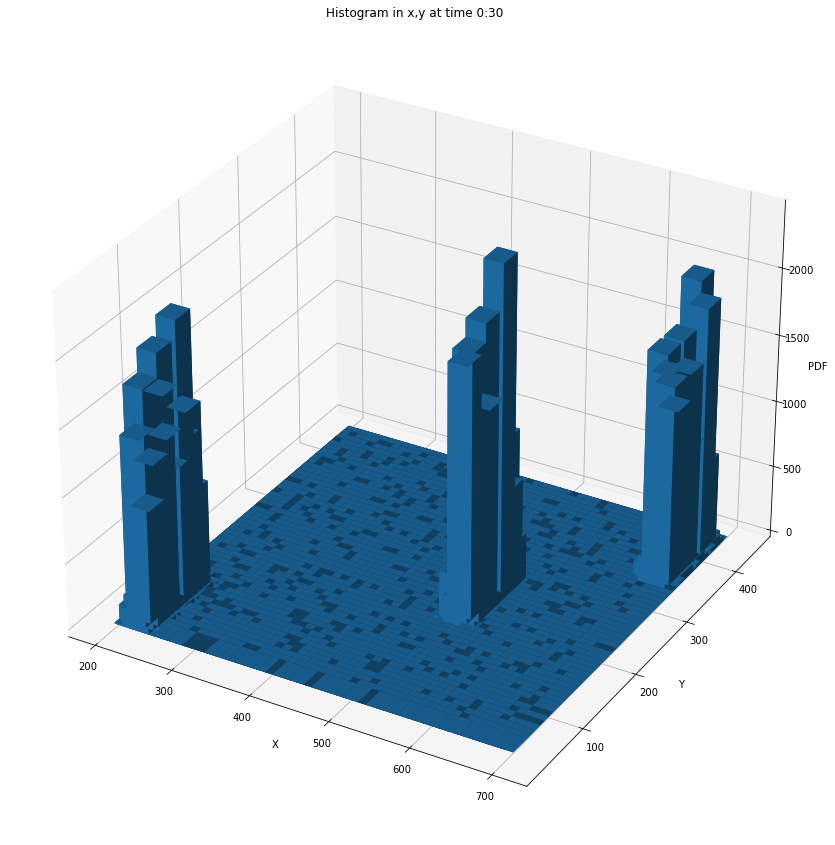

[[1.93698409e-06 2.49655727e-05 3.44352727e-05 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [3.03460841e-05 3.03030400e-04 3.77066237e-04 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [1.67871955e-05 1.93267968e-04 2.60631971e-04 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 4.40986712e-04
  1.54743507e-04 7.31749546e-06]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 4.00094825e-04
  1.41184618e-04 6.45661364e-06]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.67871955e-05
  7.96315682e-06 0.00000000e+00]]


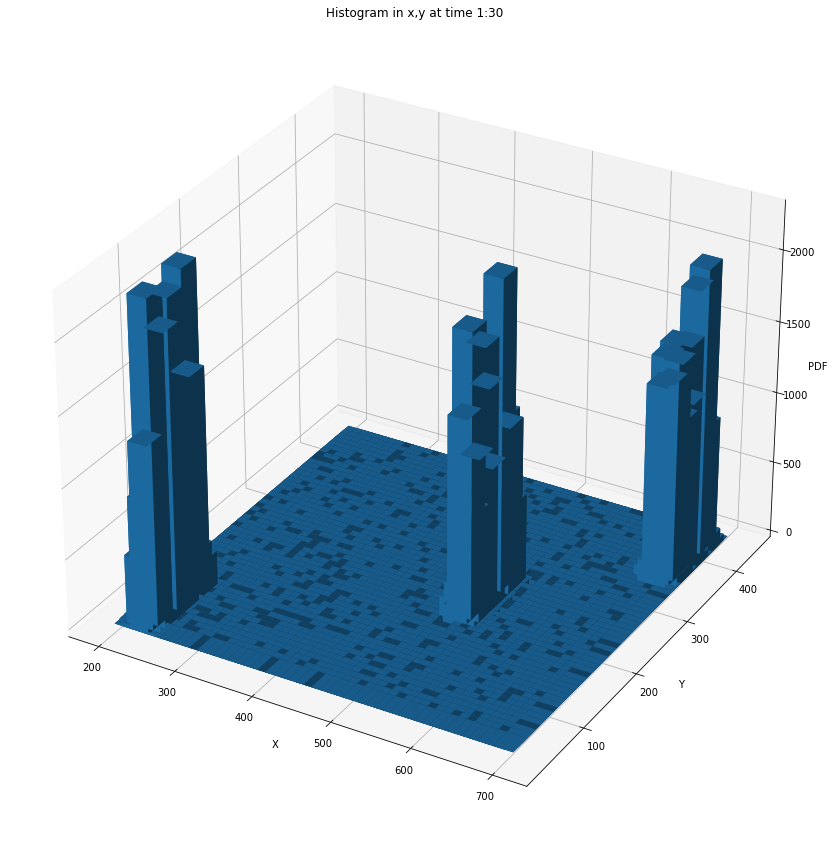

[[2.12919561e-07 1.70335649e-06 2.55503473e-06 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [5.74882815e-06 1.01988470e-04 1.83749581e-04 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [1.59689671e-05 2.75517912e-04 4.83114484e-04 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 3.93901188e-04
  1.70548568e-04 6.60050639e-06]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 4.28394157e-04
  1.86730455e-04 9.58138025e-06]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 2.40599104e-05
  9.79429981e-06 4.25839122e-07]]


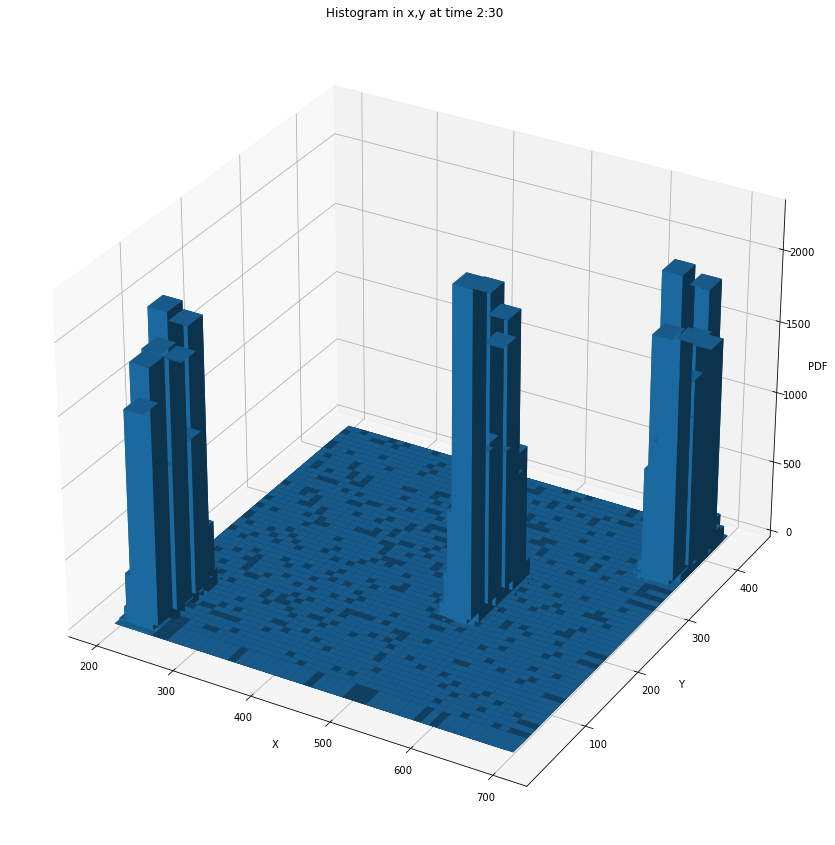

[[2.13679493e-07 2.56415392e-06 1.36754876e-05 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [1.49575645e-06 7.45741432e-05 3.14108855e-04 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [2.35047443e-06 8.09845280e-05 3.85905165e-04 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 3.19237163e-04
  2.35688481e-04 1.83764364e-05]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 4.00221691e-04
  3.06416393e-04 3.16245650e-05]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 2.90604111e-05
  2.22226673e-05 1.70943595e-06]]


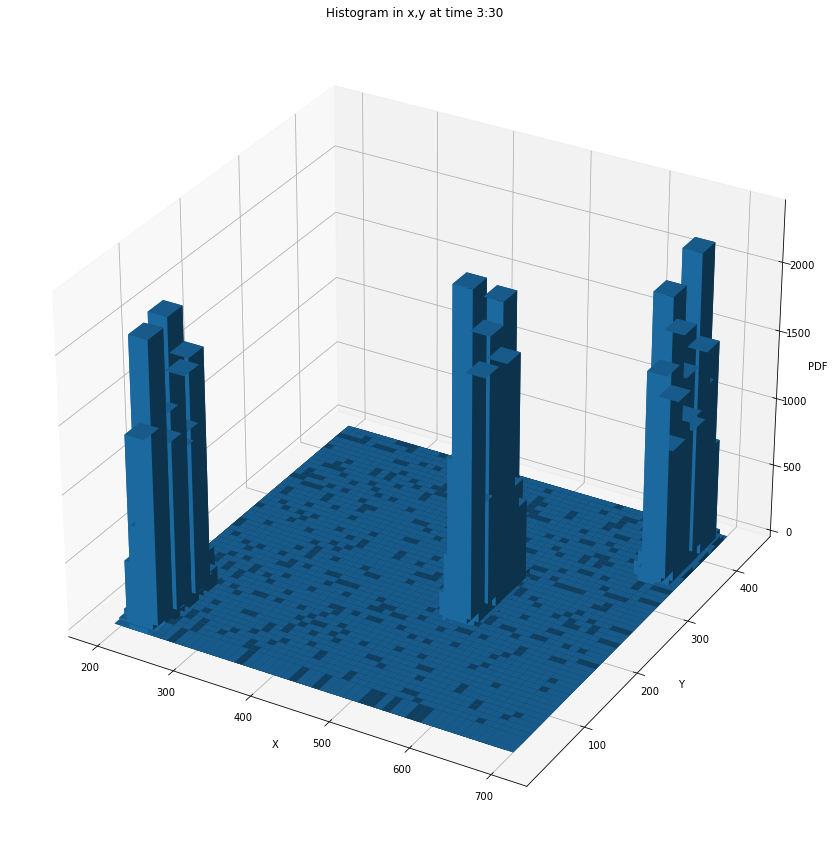

[[2.12509224e-07 3.40014759e-06 1.04129520e-05 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [2.33760147e-06 9.75417339e-05 2.87737489e-04 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [8.07535052e-06 1.57044317e-04 4.42656714e-04 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 4.69007858e-04
  2.51610921e-04 8.92538741e-06]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 3.20463910e-04
  1.58531881e-04 7.86284129e-06]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.27505534e-05
  7.65033207e-06 0.00000000e+00]]


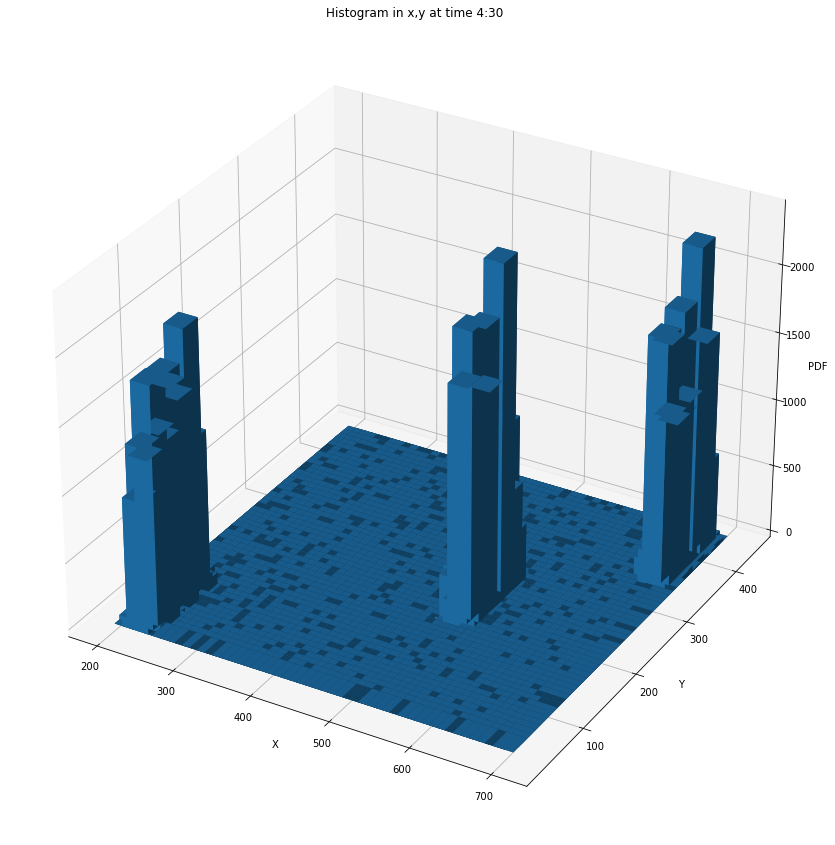

[[2.13482549e-07 7.47188923e-06 7.25840668e-06 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [1.62246738e-05 1.99179219e-04 2.77100349e-04 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [2.09212898e-05 2.68561047e-04 3.79145008e-04 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 4.83324492e-04
  1.88078126e-04 7.68537178e-06]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 3.38156358e-04
  1.38336692e-04 5.55054628e-06]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 7.68537178e-06
  5.12358119e-06 4.26965099e-07]]


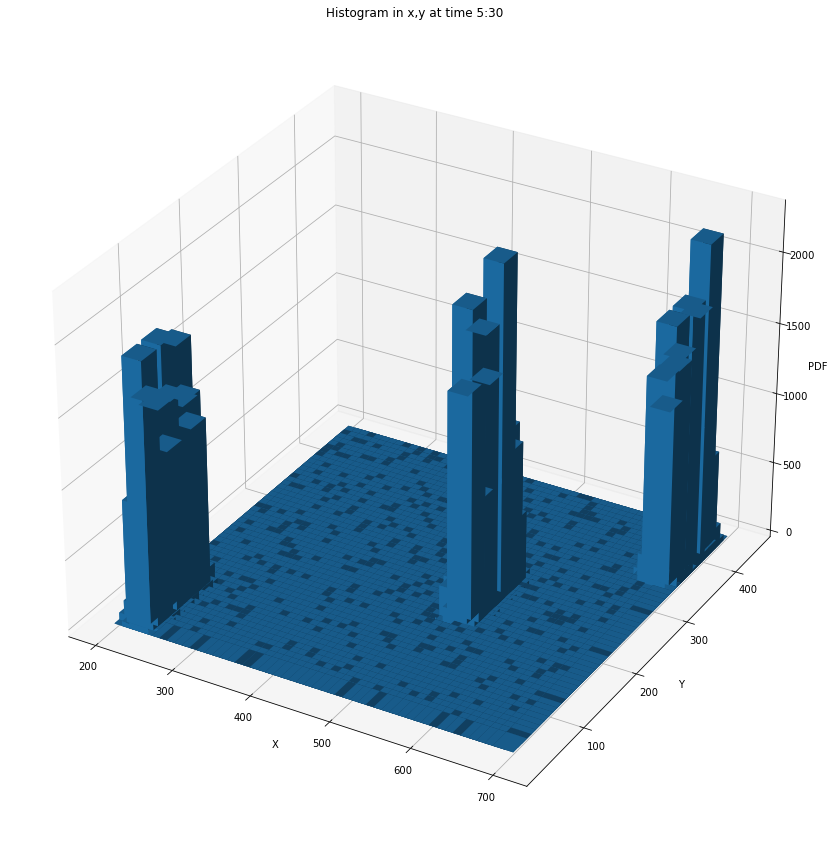

[[6.41930069e-07 1.06988345e-05 2.33234592e-05 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [7.27520745e-06 1.87015627e-04 3.95856876e-04 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [9.41497435e-06 1.55775030e-04 3.38083170e-04 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 3.59052885e-04
  1.05276531e-04 3.85158041e-06]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 4.71176671e-04
  1.35661221e-04 6.41930069e-06]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 3.29524102e-05
  8.77304428e-06 4.27953379e-07]]


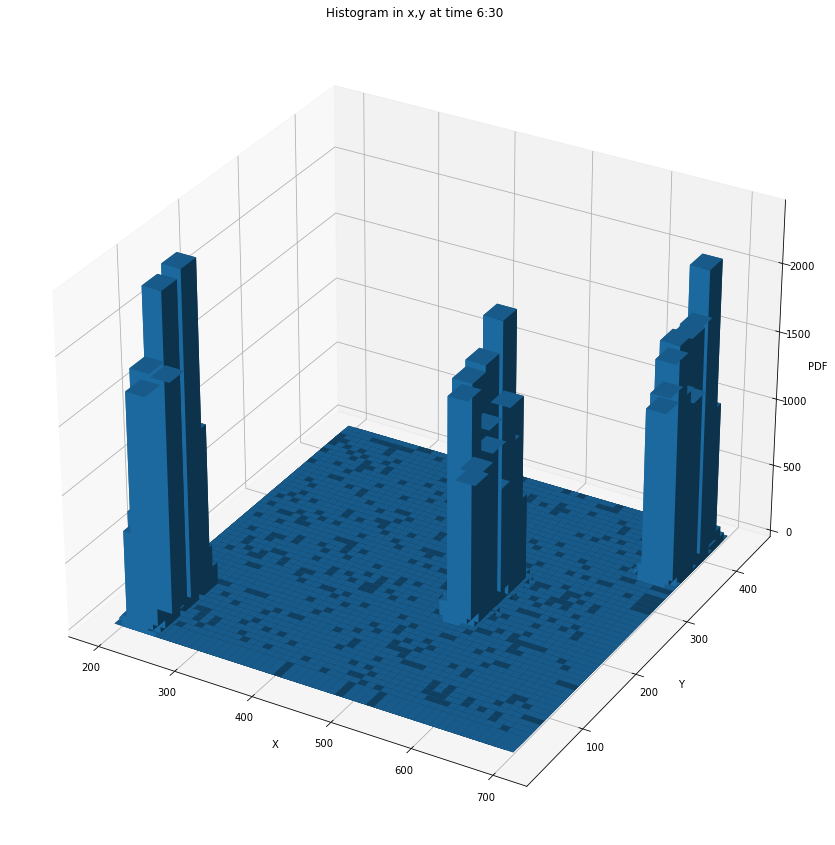

[[4.29411076e-07 3.43528861e-06 4.07940522e-06 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [1.78205597e-05 1.46429177e-04 1.71335019e-04 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [4.57322796e-05 3.68005292e-04 3.97634656e-04 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 3.58128837e-04
  1.65967381e-04 7.29998829e-06]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 4.53243391e-04
  2.19858471e-04 1.07352769e-05]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 2.87705421e-05
  1.26676267e-05 1.07352769e-06]]


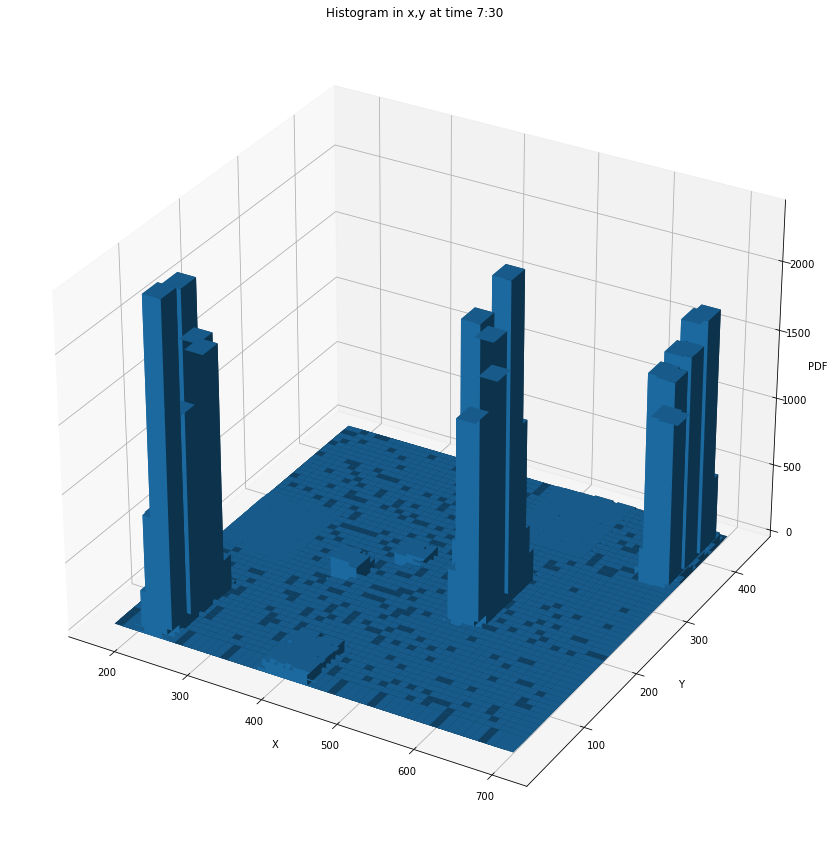

[[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [2.01520089e-07 1.41064062e-06 2.41824107e-06 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 3.40568950e-04
  8.78627587e-05 1.61216071e-06]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 3.48831274e-04
  9.73342029e-05 2.41824107e-06]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.47109665e-05
  4.43344195e-06 0.00000000e+00]]


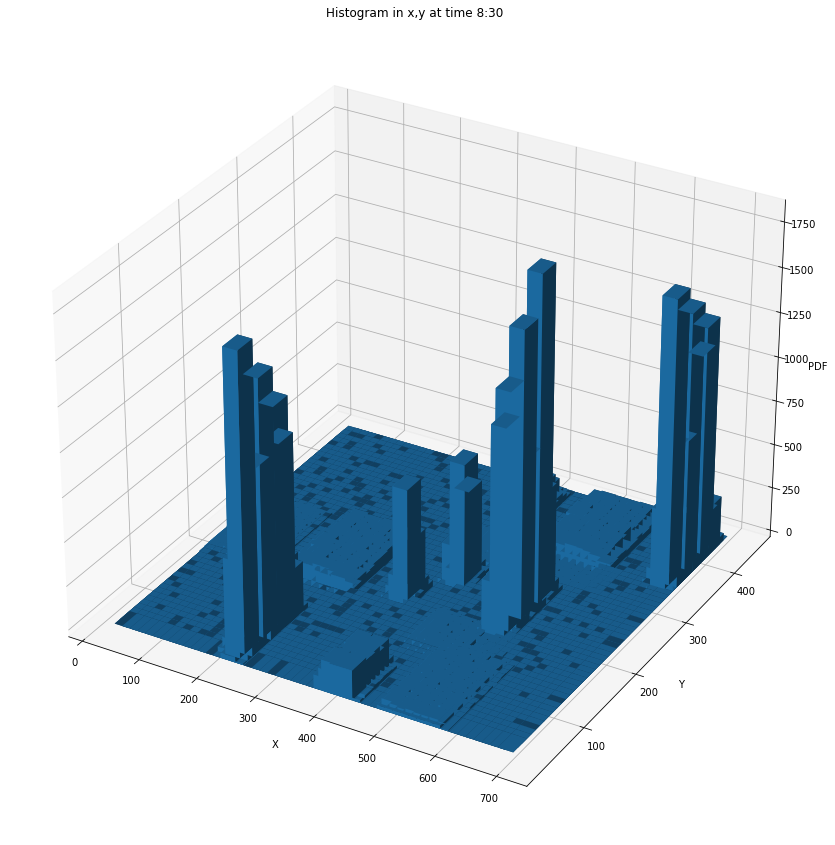

[[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.12114478e-05
  1.09000186e-06 1.55714552e-07]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 2.00248914e-04
  2.63157593e-05 1.55714552e-07]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 4.31329309e-05
  6.38429664e-06 1.55714552e-07]]


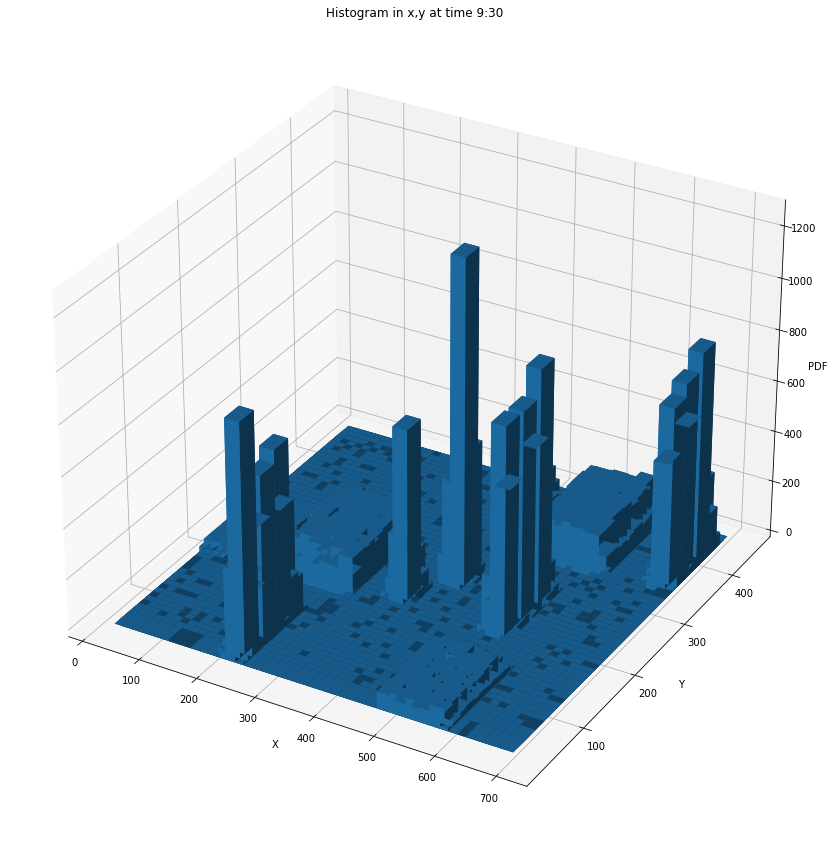

[[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 2.30708805e-06
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 4.33732553e-05
  1.99947631e-06 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 7.53648762e-06
  4.61417609e-07 0.00000000e+00]]


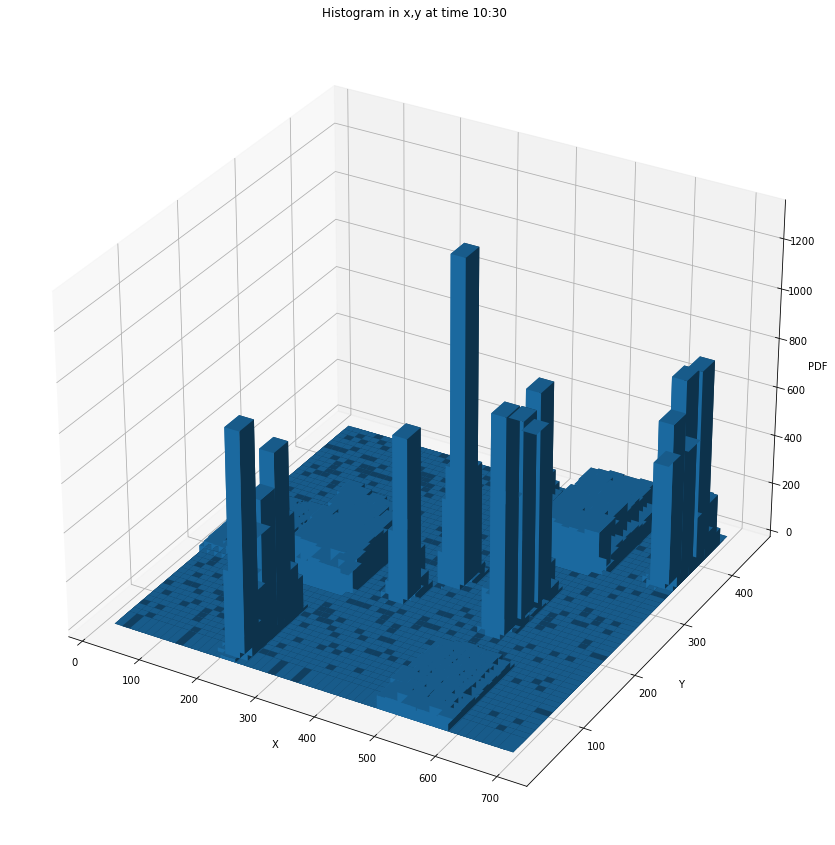

[[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.99942055e-06
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 3.18369272e-05
  1.38421423e-06 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.03047059e-05
  3.07603162e-07 0.00000000e+00]]


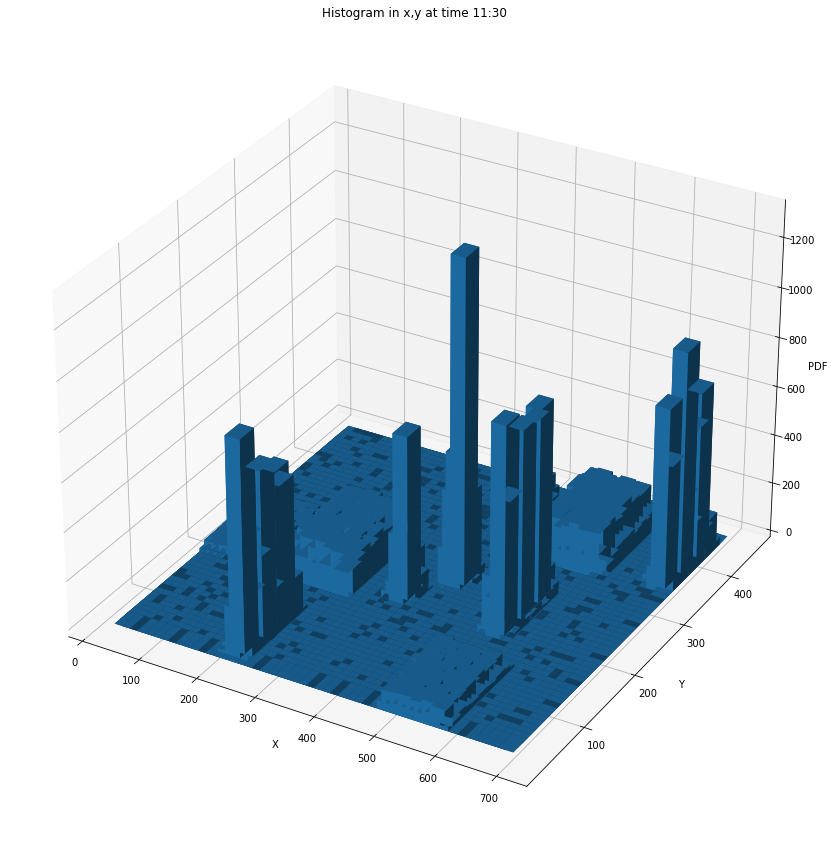

[[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 9.10112662e-07
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.45618026e-05
  1.51685444e-07 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 4.39887787e-06
  0.00000000e+00 0.00000000e+00]]


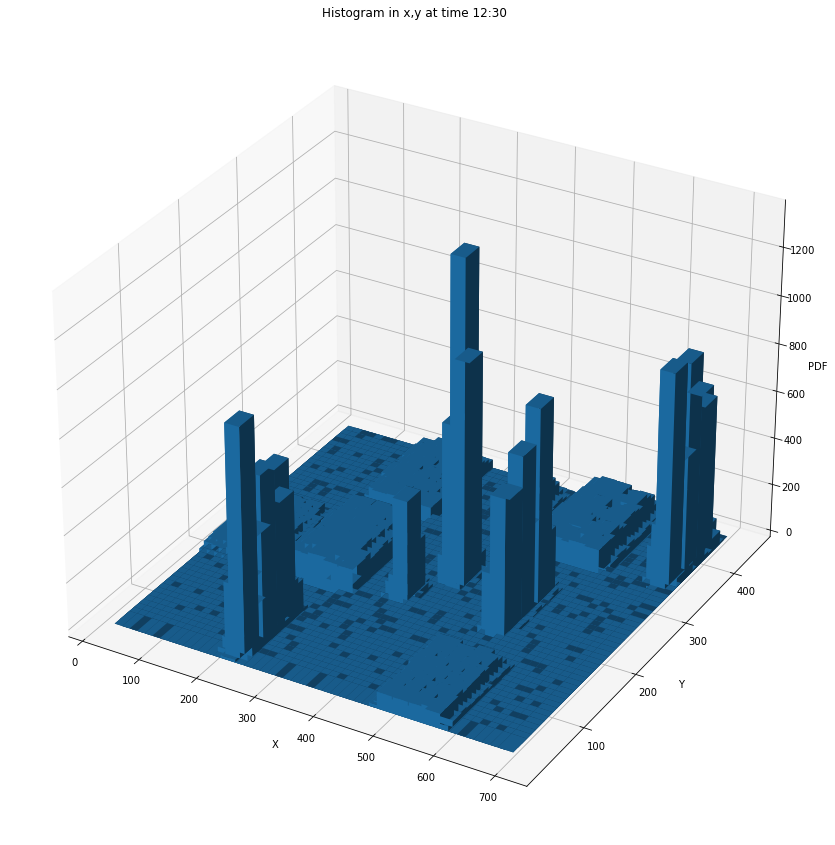

[[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.33164496e-05
  9.29054625e-07 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 9.70862083e-05
  1.31616072e-05 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 8.98086138e-06
  9.29054625e-07 0.00000000e+00]]


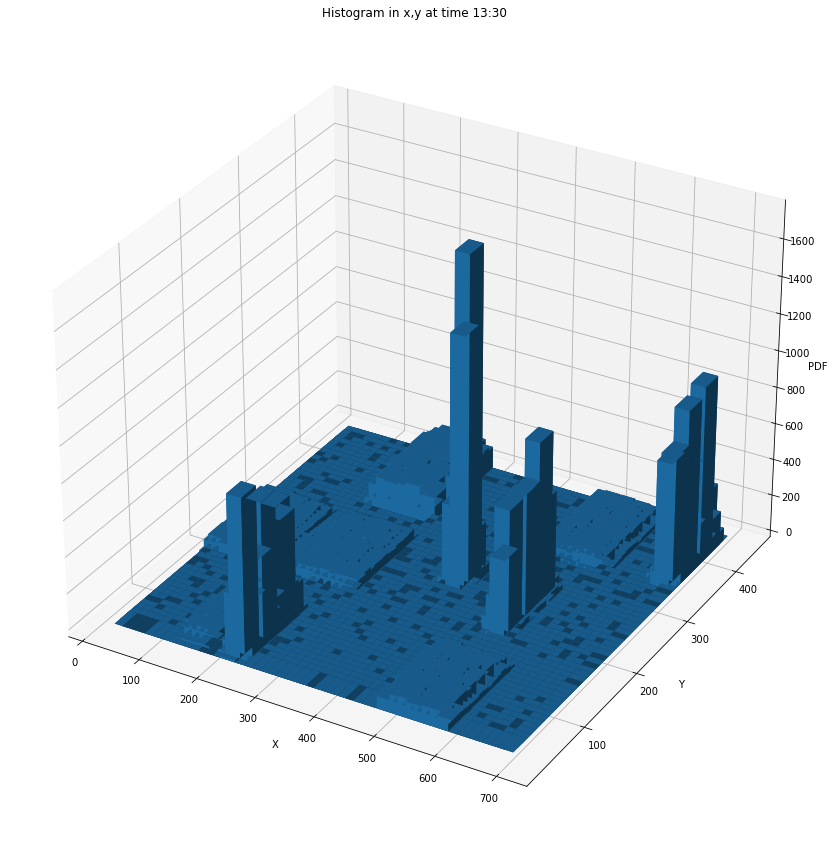

[[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 8.33009649e-06
  3.14343264e-06 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.45069416e-04
  4.80945194e-05 1.88605958e-06]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 2.89195803e-05
  1.10020142e-05 4.71514896e-07]]


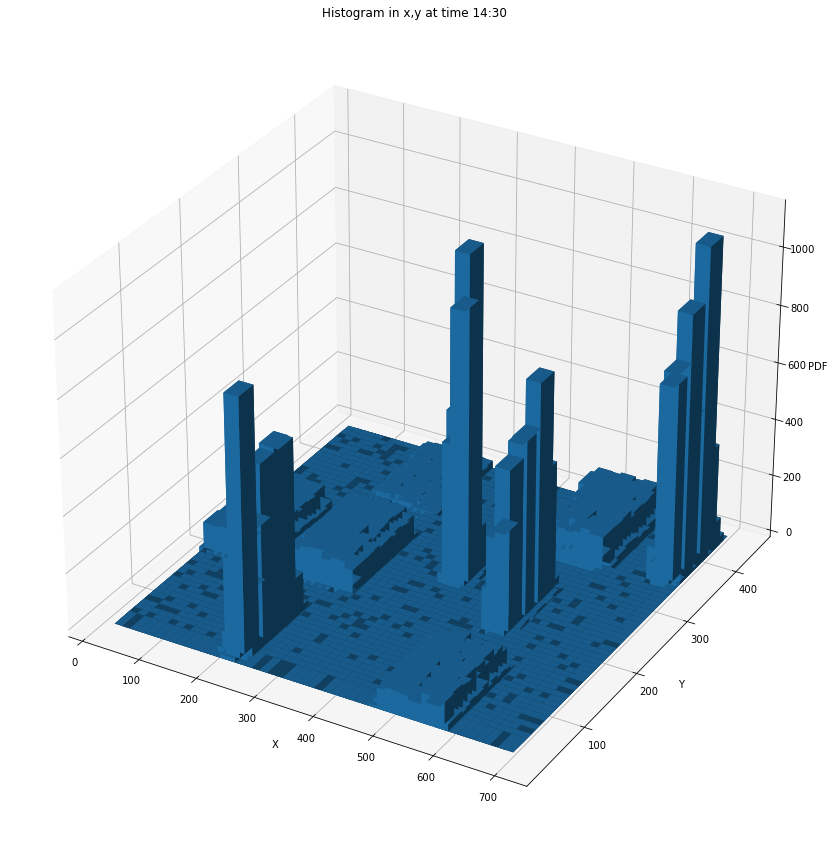

[[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 2.45639742e-05
  6.72771268e-06 3.12916869e-07]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.68036359e-04
  5.28829509e-05 1.56458435e-06]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.50200097e-05
  4.38083617e-06 1.56458435e-07]]


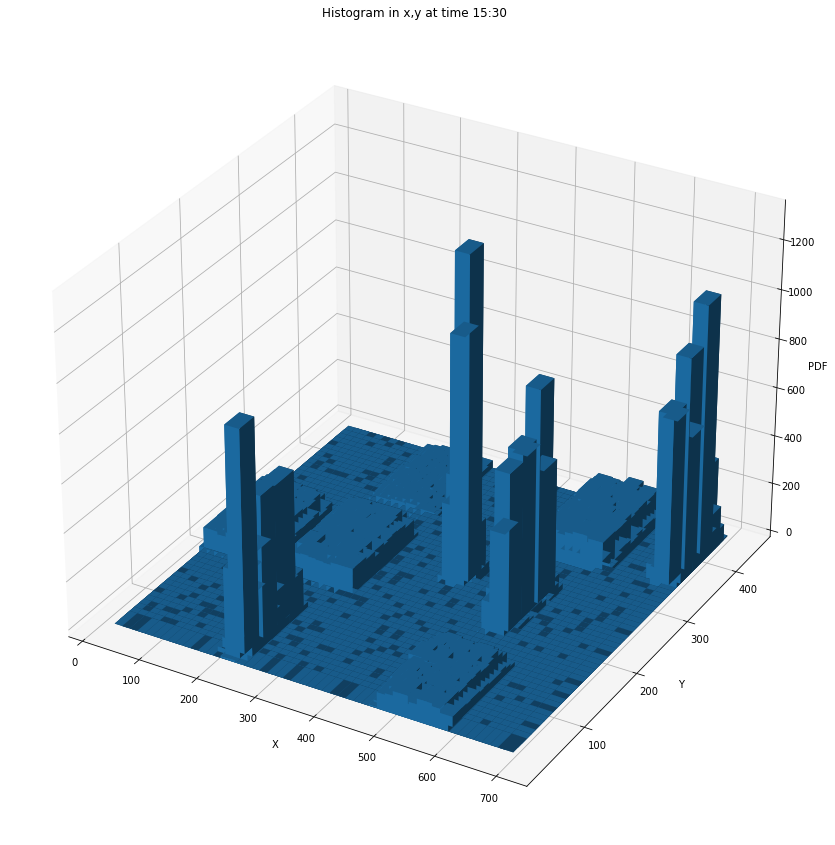

[[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.19345533e-05
  4.23990708e-06 1.57033595e-07]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.60959435e-04
  5.29203217e-05 2.98363831e-06]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 2.51253753e-05
  1.06782845e-05 6.28134382e-07]]


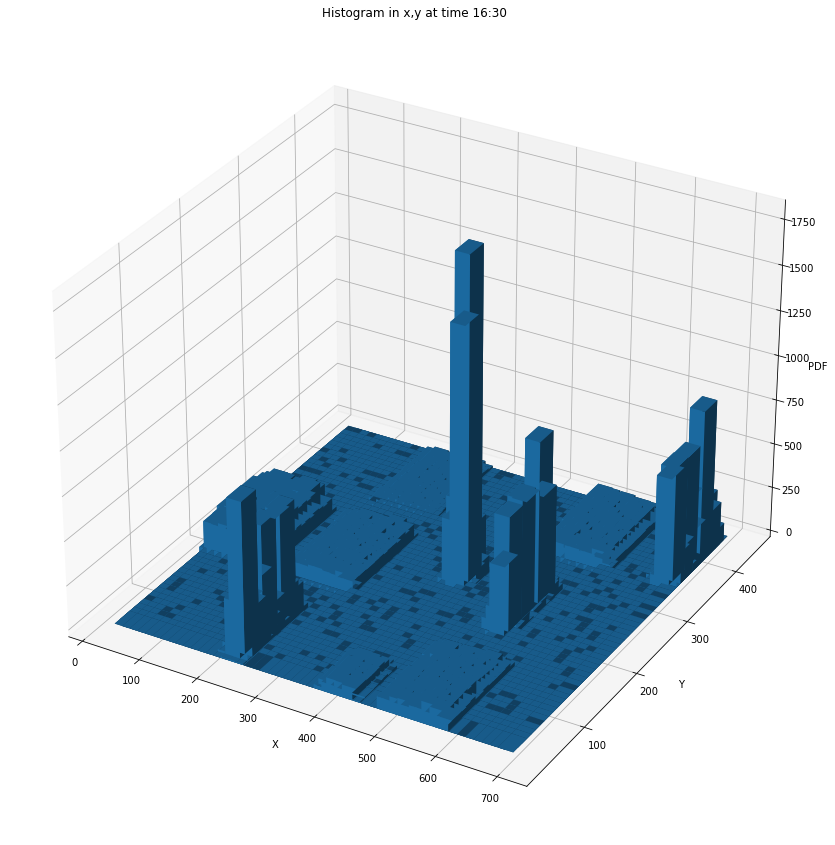

[[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 4.88095459e-06
  1.88940178e-06 1.57450148e-07]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.27849520e-04
  4.39285913e-05 2.04685193e-06]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 3.82603860e-05
  1.57450148e-05 3.14900296e-07]]


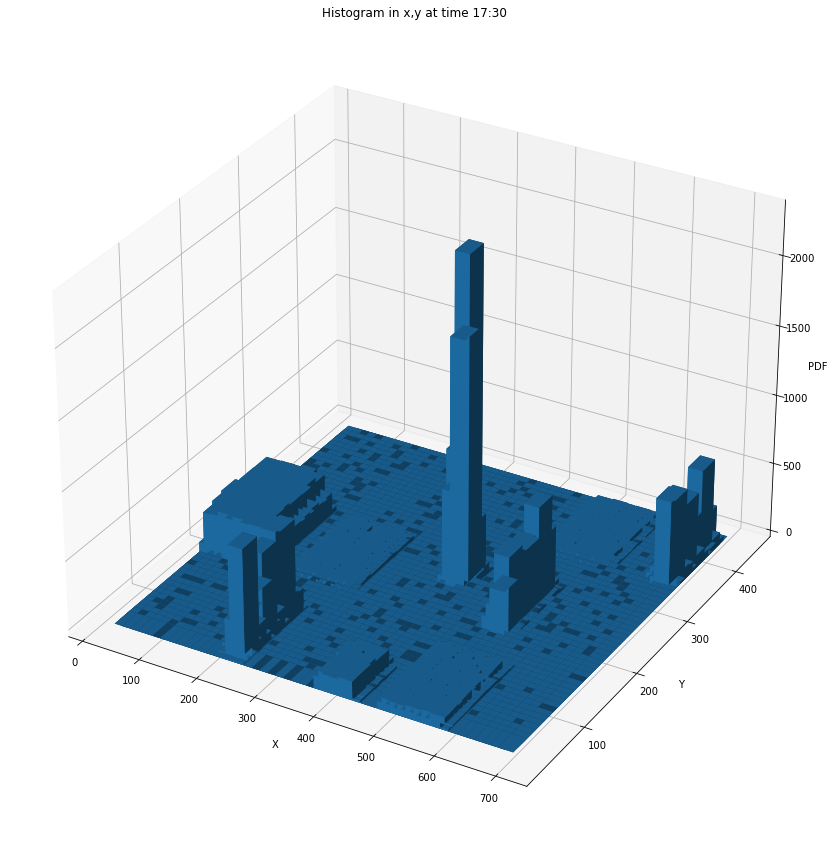

[[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 7.99906154e-06
  2.50950950e-06 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 9.59887384e-05
  3.77994869e-05 1.88213213e-06]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.33317692e-05
  5.33270769e-06 0.00000000e+00]]


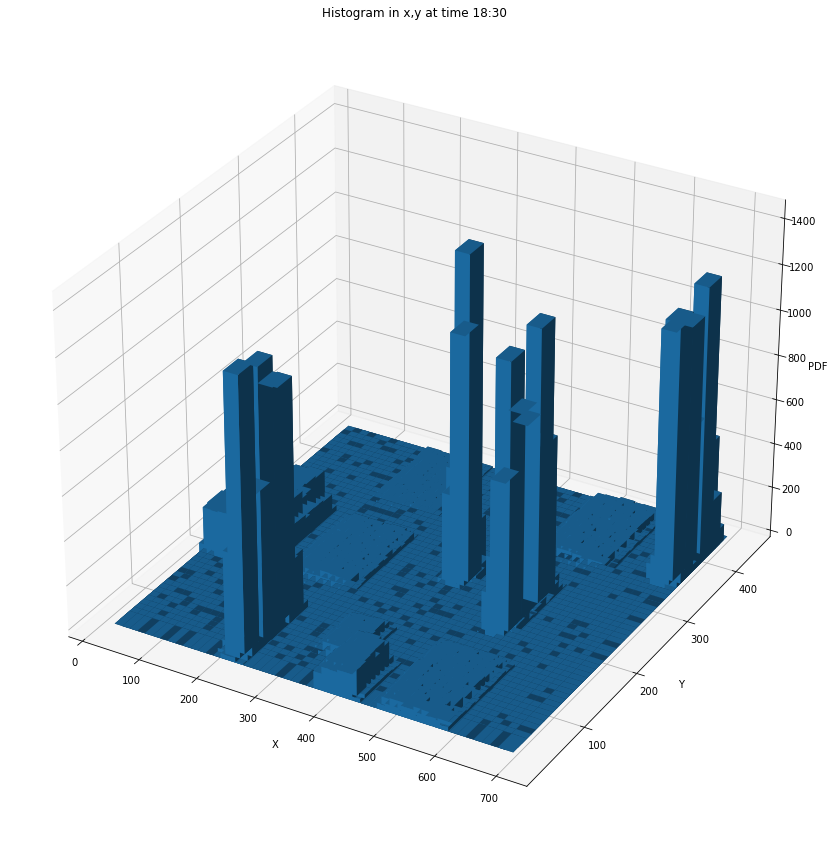

[[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.14626203e-05
  4.86768807e-06 4.71066588e-07]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.87798546e-04
  7.36434099e-05 2.35533294e-06]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 3.75283048e-05
  1.16196425e-05 0.00000000e+00]]


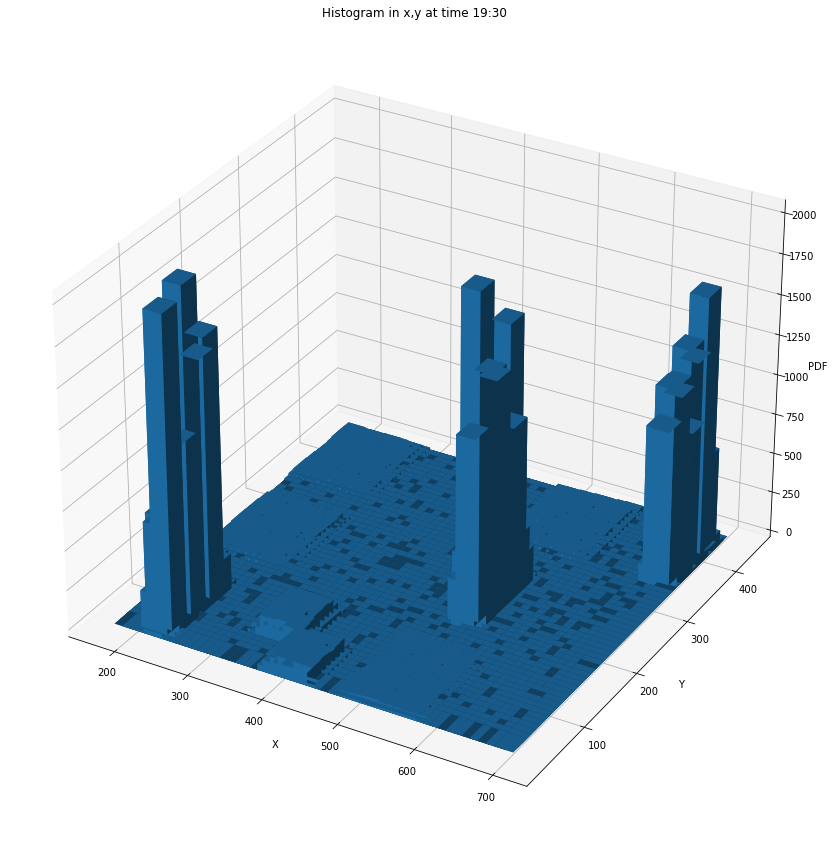

[[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 3.64318554e-06
  4.85758072e-06 4.65518153e-06]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 4.45278233e-06
  4.25038313e-06 2.83358875e-06]
 [0.00000000e+00 0.00000000e+00 1.01199598e-06 ... 4.04798394e-06
  4.04798394e-06 3.64318554e-06]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 2.42271839e-04
  9.31036305e-05 3.03598795e-06]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 3.26874703e-04
  1.17593933e-04 3.44078635e-06]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.78111293e-05
  4.85758072e-06 0.00000000e+00]]


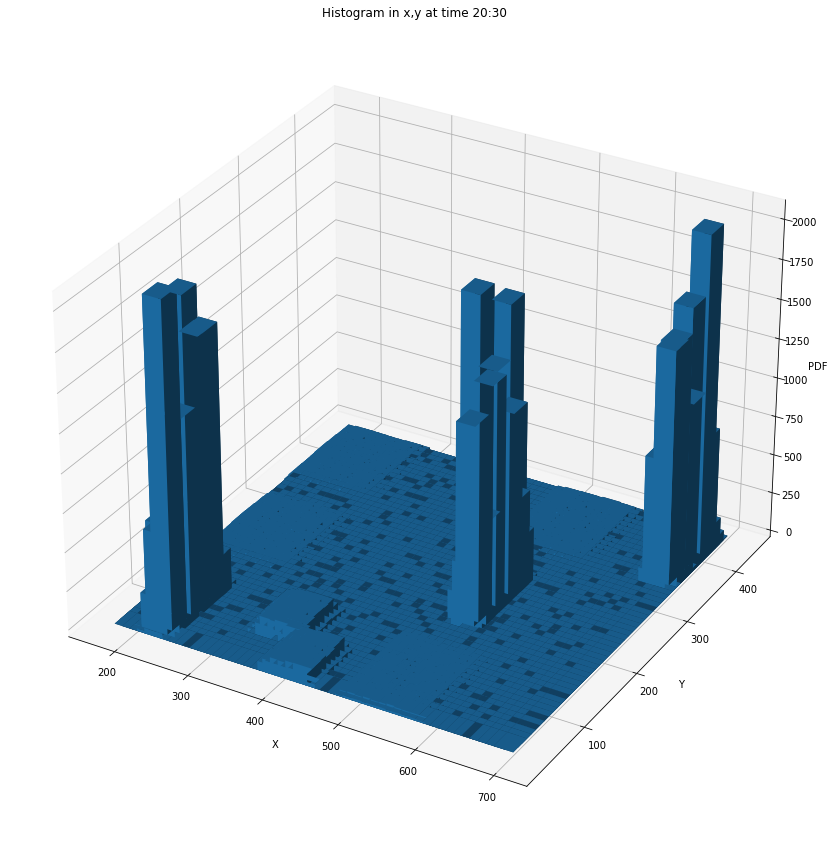

[[0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 1.62394154e-06
  1.62394154e-06 1.82693423e-06]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 4.05985385e-06
  2.43591231e-06 2.84189770e-06]
 [0.00000000e+00 6.08978078e-07 1.01496346e-06 ... 2.23291962e-06
  2.23291962e-06 2.63890501e-06]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 2.02789700e-04
  7.16564205e-05 2.43591231e-06]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 4.13699108e-04
  1.46154739e-04 4.87182463e-06]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 3.55237212e-05
  1.33975177e-05 1.01496346e-06]]


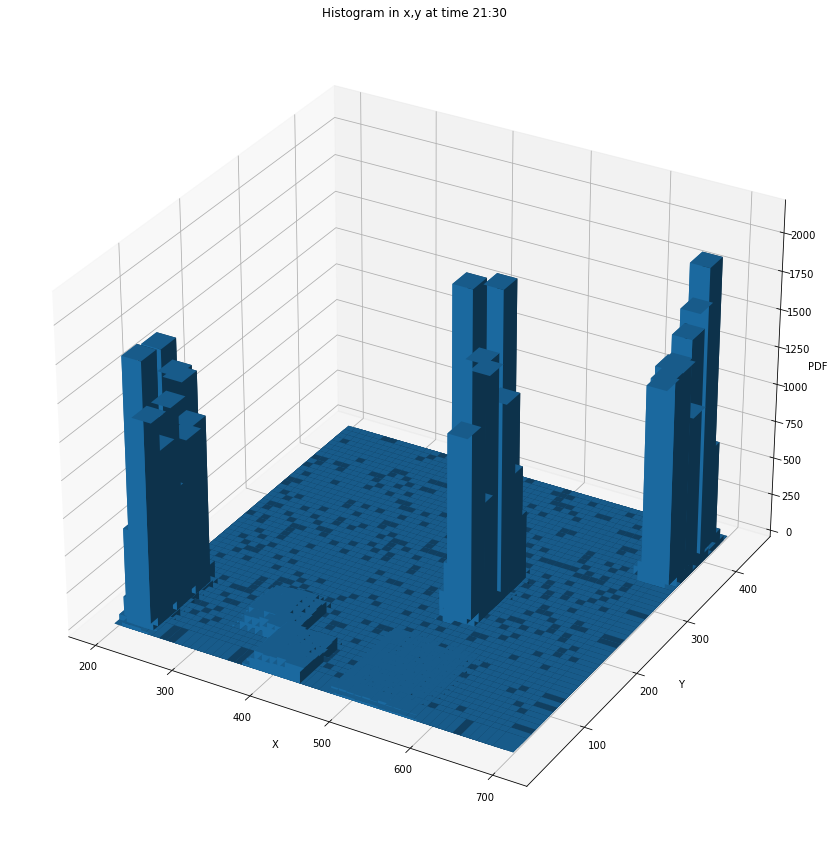

[[4.27369738e-07 7.69265529e-06 2.75653481e-05 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [5.34212173e-06 1.34835152e-04 3.70529563e-04 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [2.77790330e-06 1.01286628e-04 2.88260888e-04 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 3.42323160e-04
  1.30775140e-04 4.48738225e-06]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 4.08992839e-04
  1.41032014e-04 3.84632764e-06]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 2.24369112e-05
  7.05160068e-06 4.27369738e-07]]


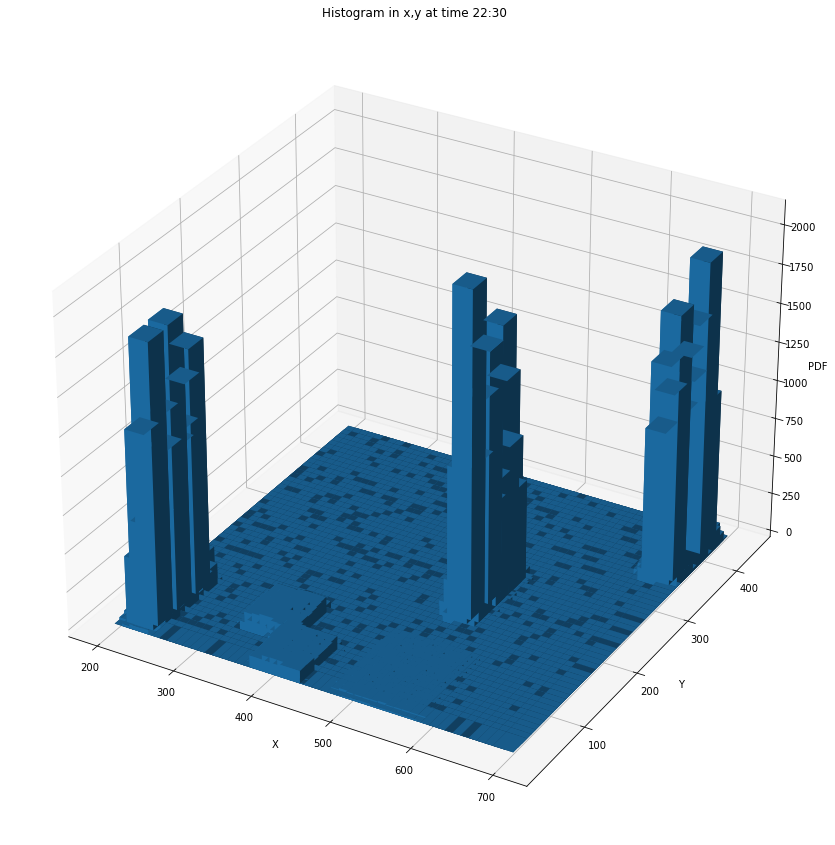

[[0.00000000e+00 3.20255694e-06 6.83212148e-06 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [3.41606074e-06 9.26606475e-05 2.61969158e-04 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [5.97810629e-06 1.45182581e-04 3.89003917e-04 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 3.16839633e-04
  1.66319457e-04 1.04616860e-05]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 4.05230205e-04
  2.09447224e-04 1.62262885e-05]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 2.58339593e-05
  1.28102278e-05 1.28102278e-06]]


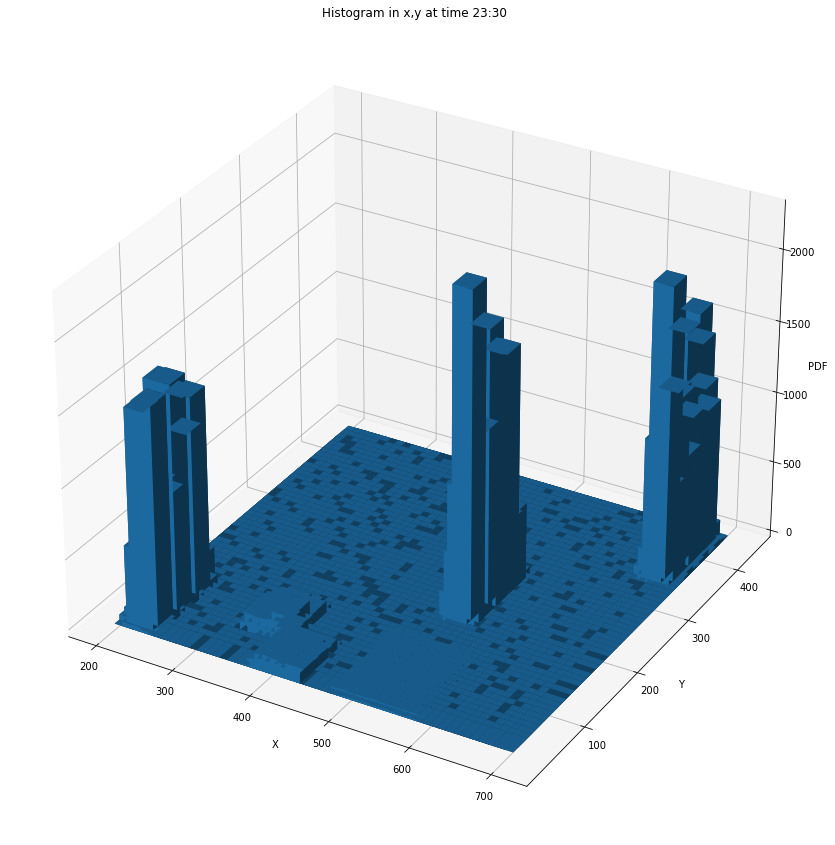

[[0.00000000e+00 7.70783110e-06 1.28463852e-05 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [6.85140542e-06 1.16902105e-04 3.17519820e-04 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [3.63980913e-06 1.17116211e-04 3.30366205e-04 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 3.61839849e-04
  3.11738947e-04 3.19018565e-05]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 2.52859681e-04
  2.14962845e-04 2.22670676e-05]
 [0.00000000e+00 0.00000000e+00 0.00000000e+00 ... 7.70783110e-06
  4.92444765e-06 1.71285136e-06]]


In [68]:
arr = []
for i in range(0, 24):
    fig = plt.figure(figsize=(15, 15))
    ax = fig.add_subplot(projection='3d')
    hist, xedges, yedges = np.histogram2d(df['X'][(df["hour"]==i) & (df["min"]==30)], df['Y'][(df["hour"]==i) & (df["min"]==30)], bins=50)
# Construct arrays for the anchor positions of the 16 bars.
    xpos, ypos = np.meshgrid(xedges[:-1] + 25, yedges[:-1] + 25, indexing="ij")
    xpos = xpos.ravel()
    ypos = ypos.ravel()
    zpos = 0

# Construct arrays with the dimensions for the 16 bars.
    dx = dy = 25 * np.ones_like(zpos)
    dz = hist.ravel()
    arr.append(hist)
    ax.bar3d(xpos, ypos, zpos, dx, dy, dz, zsort='average')
    ax.set_title('Histogram in x,y at time {}:30'.format(i))
    ax.set_xlabel('X')
    ax.set_ylabel('Y')
    ax.set_zlabel('PDF')
    plt.show()
    hist_prob = hist/len(df['X'][(df["hour"]==i) & (df["min"]==30)])
    hist_pdf = hist_prob/((xedges[1]-xedges[0])*(yedges[1]-yedges[0]))
    print(hist_pdf)